### The IDEAS project is supported via NASA's Earth Science Technology Office (ESTO) from the Advanced Information Systems Technology (AIST) Program

# Integrated Digital Earth Analysis System (IDEAS) API Demonstration

This notebook highlights some of the analytics and visualization capabilities of IDEAS with the following use cases:
- South Korea flooding in July, 2023
- Pakistan flooding occurring from June through September, 2022
- Hurricane Ian as it makes landfall over Florida in September, 2022
- France storm in January, 2022
- Flooding in Mississippi river basin in January, 2020
    - Includes LIS NoahMP model data, RAPID river discharge, and 1x, 2x, and 3x precipitation scenarios
- Flooding in Garonne in January, 2021
    - Includes LIS NoahMP model data, RAPID river discharge, 1x, 2x, and 3x precipitation scenarios, and Telemac2d data that highlights the flow of LIS NoahMP model -> RAPID model -> Telemac2d model

## Libraries

The following libraries are needed to support accessing IDEAS API. The functions called in this notebook are in the `ideas_modules` folder

### Libraries

In [1]:
%matplotlib inline
import warnings
warnings.filterwarnings("ignore")

import requests
from datetime import datetime, timedelta
import pandas as pd
import json
from shapely.geometry import box
from IPython.display import Image
from tabulate import tabulate
from owslib.util import Authentication
from owslib.wms import WebMapService
from PIL import Image as I
from PIL import ImageDraw, ImageFont
from io import BytesIO
import numpy as np

import ideas_modules.plotting as plotting
import ideas_modules.ideas_processing as ideas_processing

## Data Inventory
The base url, https://ideas-digitaltwin.jpl.nasa.gov/nexus, is the entry point to access IDEAS API. In the following code snipet, it is used in conjunction with list endpoint to get a list of datasets.

In [2]:
BASE_URL = 'https://ideas-digitaltwin.jpl.nasa.gov'
NEXUS_URL = f'{BASE_URL}/nexus'
STAC_URL = f'{BASE_URL}/stac-api'

In [3]:
ideas_datasets = [
    'SPL3SMP_AM_soil_moisture',
    'SPL3SMP_PM_soil_moisture',
    'GPM_3IMERGDL_precipitationCal',
    'GLDAS_VIC10_3H_2_1_global_Qs_acc',
    'GLDAS_VIC10_3H_2_1_global_Qsb_acc',
    'GLDAS_NOAH10_3H_2_1_global_Qs_acc',
    'GLDAS_NOAH10_3H_2_1_global_Qsb_acc',
    'GLDAS_CLSM10_3H_2_1_global_Qs_acc',
    'GLDAS_CLSM10_3H_2_1_global_Qsb_acc',
    'LIS_gar_gdas_1x_Qs_tavg',
    'LIS_gar_gdas_1x_Qsb_tavg',
    'LIS_gar_gdas_2x_Qs_tavg',
    'LIS_gar_gdas_2x_Qsb_tavg',
    'LIS_gar_gdas_3x_Qs_tavg',
    'LIS_gar_gdas_3x_Qsb_tavg',
    'LIS_miss_1x_Qs_tavg',
    'LIS_miss_1x_Qsb_tavg',
    'LIS_miss_merra2_2x_Qs_tavg',
    'LIS_miss_merra2_2x_Qsb_tavg',
    'LIS_miss_merra2_3x_Qs_tavg',
    'LIS_miss_merra2_3x_Qsb_tavg'
]

url = f'{NEXUS_URL}/list'
print('url\n', url); print()
r = requests.get(url, verify=False).json()
inventories = pd.DataFrame(r)[['title', 'iso_start', 'iso_end']]
inventories = inventories.sort_values(['iso_end'], ascending=False)
print(tabulate( inventories[ inventories['title'].isin(ideas_datasets) ], headers="keys", showindex=False ))

url
 https://ideas-digitaltwin.jpl.nasa.gov/nexus/list

title                               iso_start                 iso_end
----------------------------------  ------------------------  ------------------------
SPL3SMP_PM_soil_moisture            2018-10-01T12:06:17+0000  2023-11-07T12:04:07+0000
SPL3SMP_AM_soil_moisture            2018-10-01T11:46:39+0000  2023-11-07T11:44:21+0000
GPM_3IMERGDL_precipitationCal       2018-10-01T00:00:00+0000  2023-11-07T00:00:00+0000
LIS_gar_gdas_3x_Qsb_tavg            2020-08-01T00:00:00+0000  2022-12-31T00:00:00+0000
LIS_gar_gdas_3x_Qs_tavg             2020-08-01T00:00:00+0000  2022-12-31T00:00:00+0000
LIS_gar_gdas_2x_Qsb_tavg            2020-08-01T00:00:00+0000  2022-12-31T00:00:00+0000
LIS_gar_gdas_2x_Qs_tavg             2020-08-01T00:00:00+0000  2022-12-31T00:00:00+0000
LIS_miss_merra2_3x_Qsb_tavg         2018-02-01T00:00:00+0000  2022-10-31T00:00:00+0000
LIS_miss_merra2_3x_Qs_tavg          2018-02-01T00:00:00+0000  2022-10-31T00:00:00+0000
LIS_

## STAC API

In [4]:
url = f'{STAC_URL}/edge_collections'
print('url\n', url); print()
r = requests.get(url, verify=False).json()

collections = r['collections']
print(len(collections), 'collections found')

url
 https://ideas-digitaltwin.jpl.nasa.gov/stac-api/edge_collections

17 collections found


In [5]:
gpm_collection = collections[0]
gpm_collection

{'type': 'Collection',
 'id': 'GPM-3IMERGHHR-06-daily-global-precipitationCal',
 'stac_version': '1.0.0',
 'description': 'GPM-3IMERGHHR-06-daily-global-precipitationCal',
 'links': [{'rel': 'self',
   'href': 'http://ideas-digitaltwin.jpl.nasa.gov/stac-api/edge_collections/GPM-3IMERGHHR-06-daily-global-precipitationCal',
   'type': 'application/json'},
  {'rel': 'parent',
   'href': 'http://ideas-digitaltwin.jpl.nasa.gov/stac-api/edge_collections/',
   'type': 'application/json'},
  {'rel': 'root',
   'href': 'http://ideas-digitaltwin.jpl.nasa.gov/stac-api/',
   'type': 'application/json',
   'title': 'Root URL'}],
 'stac_extensions': [],
 'title': 'GPM IMERG Final Precipitation L3 V06',
 'extent': {'spatial': {'bbox': [[0, 0, 0, 0]]},
  'temporal': {'interval': [['2000-06-01T00:00:00Z', None]]}},
 'license': 'proprietary'}

### GPM Collection in STAC

In [6]:
url = [link['href'] for link in gpm_collection['links'] if link['rel'] == 'self'][0]

print('url\n', url); print()
gpm_collection_stac = requests.get(url, verify=False).json()
for k in ['type', 'title', 'description', 'links']:
    print(f'{k}: ', json.dumps(gpm_collection_stac[k], indent=2))

url
 http://ideas-digitaltwin.jpl.nasa.gov/stac-api/edge_collections/GPM-3IMERGHHR-06-daily-global-precipitationCal

type:  "Collection"
title:  "GPM IMERG Late Precipitation L3 1 day 0.1 degree x 0.1 degree V06 (GPM_3IMERGDL) at GES DISC"
description:  "The Integrated Multi-satellitE Retrievals for GPM (IMERG) is the unified U.S. algorithm that provides the multi-satellite precipitation product for the U.S. GPM team.Version 06 is the current version of the data set. Older versions will no longer be available and have been superseded by Version 06.This dataset is the GPM Level 3 IMERG  Late Daily  10 x 10 km (GPM_3IMERGDL) derived from the half-hourly GPM_3IMERGHHL. The derived result represents a Late expedited estimate of the daily accumulated precipitation. The dataset is produced at the NASA Goddard Earth Sciences (GES) Data and Information Services Center (DISC) by simply summing the valid precipitation retrievals for the day in GPM_3IMERGHHL and giving the result in (mm). The lat

### GPM STAC Item

In [7]:
url = [link['href'] for link in gpm_collection_stac['links'] if link['rel'] == 'items'][0]

print('url\n', url); print()
gpm_items_stac = requests.get(url, verify=False).json()
print(f'{len(gpm_items_stac["features"])} items found in GPM collection')

url
 http://ideas-digitaltwin.jpl.nasa.gov/stac-api/edge_collections/GPM-3IMERGHHR-06-daily-global-precipitationCal/items

2000 items found in GPM collection


In [8]:
gpm_items_stac["features"][0]

{'type': 'Feature',
 'stac_version': '1.0.0',
 'id': '3B-DAY-L.MS.MRG.3IMERG.20030205-S000000-E235959.V06',
 'properties': {'start_datetime': '2003-02-05T00:00:00+00:00',
  'end_datetime': '2003-02-05T23:59:59.999000+00:00',
  'datetime': None},
 'geometry': None,
 'links': [{'rel': 'parent',
   'href': 'http://ideas-digitaltwin.jpl.nasa.gov/stac-api/edge_collections/GPM-3IMERGHHR-06-daily-global-precipitationCal',
   'type': 'application/json'},
  {'rel': 'root',
   'href': 'http://ideas-digitaltwin.jpl.nasa.gov/stac-api/',
   'type': 'application/json',
   'title': 'Root URL'}],
 'assets': {'data': {'href': 'https://gpm1.gesdisc.eosdis.nasa.gov/data/GPM_L3/GPM_3IMERGDL.06/2003/02/3B-DAY-L.MS.MRG.3IMERG.20030205-S000000-E235959.V06.nc4',
   'title': 'Data Access GET DATA'}},
 'bbox': [-180.0, -90.0, 180.0, 90.0],
 'stac_extensions': [],
 'collection': 'GPM-3IMERGHHR-06-daily-global-precipitationCal'}

## Continous Forward Processing

In [9]:
print(f'Cell executed at {datetime.now()}\n')
print(tabulate( inventories[ inventories['title'].isin(['GPM_3IMERGDL_precipitationCal', 'SPL3SMP_AM_soil_moisture', 'SPL3SMP_PM_soil_moisture']) ], headers="keys", showindex=False ))

Cell executed at 2023-11-08 17:21:22.874045

title                          iso_start                 iso_end
-----------------------------  ------------------------  ------------------------
SPL3SMP_PM_soil_moisture       2018-10-01T12:06:17+0000  2023-11-07T12:04:07+0000
SPL3SMP_AM_soil_moisture       2018-10-01T11:46:39+0000  2023-11-07T11:44:21+0000
GPM_3IMERGDL_precipitationCal  2018-10-01T00:00:00+0000  2023-11-07T00:00:00+0000


## IDEAS API

# South Korea Flood 2023

Find the peak of the flood using GPM precipitation data and visualize it.

- datasets: GPM_3IMERGDL_precipitationCal, SPL3SMP_AM_soil_moisture
- spatial bounds:  
- temporal bounds: 2023-07-01 to 2023-07-16
- area of interest: South Korea

In [10]:
bb_sk_flood       = {'min_lon': 125.5, 'max_lon': 130, 'min_lat': 34.15, 'max_lat': 38.62}
start_sk_flood    = datetime(2023, 7, 1)
end_sk_flood      = datetime(2023, 7, 16)

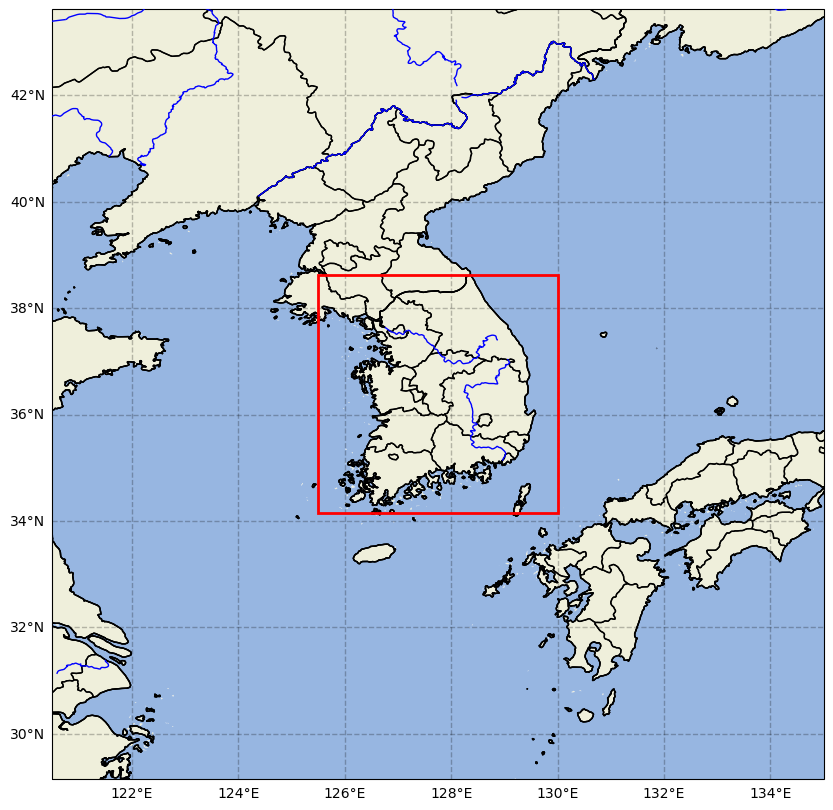

In [11]:
plotting.map_box(bb_sk_flood, padding=5)

### GPM Precipitation

In [12]:
sk_gpm_parameters = (NEXUS_URL, 'GPM_3IMERGDL_precipitationCal', bb_sk_flood, start_sk_flood, end_sk_flood)
sk_gpm_timeseries = ideas_processing.spatial_timeseries(*sk_gpm_parameters)

url
 https://ideas-digitaltwin.jpl.nasa.gov/nexus/timeSeriesSpark?ds=GPM_3IMERGDL_precipitationCal&minLon=125.5&minLat=34.15&maxLon=130&maxLat=38.62&startTime=2023-07-01T00:00:00Z&endTime=2023-07-16T00:00:00Z&lowPassFilter=False

Waiting for response from IDEAS...took 11.170307916996535 seconds


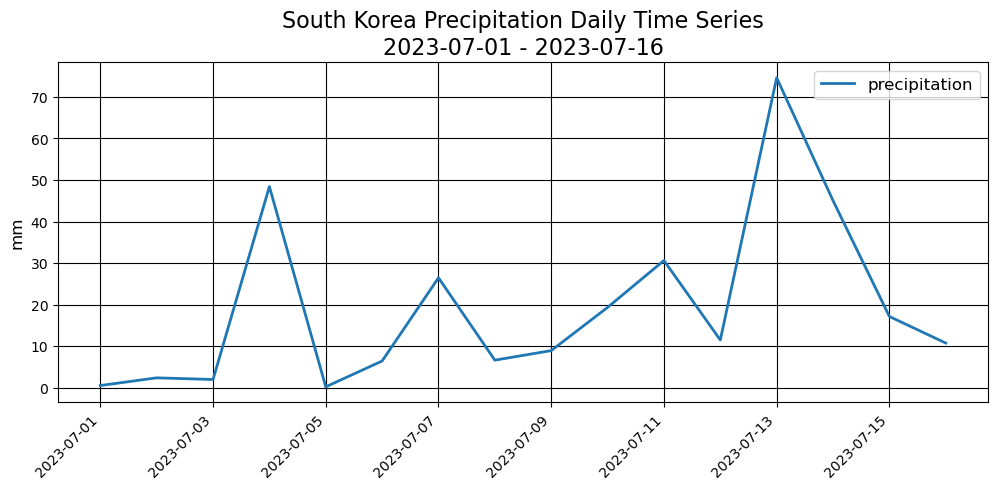

In [13]:
title = f'South Korea Precipitation Daily Time Series\n{str(start_sk_flood)[:10]} - {str(end_sk_flood)[:10]}'
plotting.timeseries_plot([(sk_gpm_timeseries['mean'], 'precipitation')], '', 'mm', title)

In [14]:
# Connect to GIBS WMS Service
wms = WebMapService('https://gibs.earthdata.nasa.gov/wms/epsg4326/best/wms.cgi?', version='1.3.0')

layers = ['BlueMarble_NextGeneration',
          'IMERG_Precipitation_Rate',
          'Reference_Features',
          'Reference_Labels']
font = ImageFont.truetype('Roboto-Bold.ttf', size=18)
color = 'rgb(255,255,255)'
frames = []
dates = pd.date_range(start_sk_flood, end_sk_flood,freq='d')

print(f'Obtaining {len(dates)} days of imagery...')

raw_colormap = I.open(BytesIO(requests.get('https://gibs.earthdata.nasa.gov/legends/GPM_Precipitation_Rate_H.png').content))
colormap = I.new("RGBA", raw_colormap.size, (255, 255, 255) + (255,))
colormap.paste(raw_colormap, mask=raw_colormap.convert('RGBA').split()[-1])
colormap = colormap.crop((0,0, colormap.width, colormap.height - 110))
for date in dates:
    datatime = date.strftime("%Y-%m-%d")
    
    # Get IMERG_Precipitation_Rate
    img = wms.getmap(layers=layers,  # Layers
                    srs='epsg:4326',  # Map projection
                    bbox=(110,30,145,44),  # Bounds
                    size=(700, 450),  # Image size
                    time=datatime,  # Time of data
                    format='image/png',  # Image format
                    transparent=True)  # Nodata transparency
    image = I.open(img)
    img_w, img_h = image.size
    background = I.new('RGBA', (img_w, img_h + colormap.size[1]), (255, 255, 255, 255))
    bg_w, bg_h = background.size
    offset = (0, 0)
    background.paste(image, offset)
    background.paste(colormap, ((bg_w - colormap.width) // 2, img_h))
    draw = ImageDraw.Draw(background)
    (x, y) = (225, 12)
    draw.text((x, y), f'IMERG Precipitation - {datatime}', fill='rgb(255,255,255)', font=font)
    frames.append(background)

Obtaining 16 days of imagery...


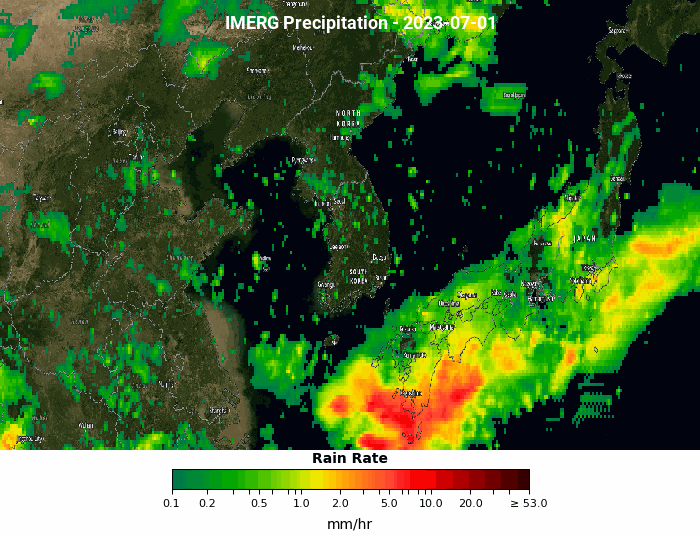

In [15]:
frames[0].save('IMERG_SK.gif',
               format='GIF',
               append_images=frames,
               save_all=True,
               duration=500,
               loop=0)
Image('IMERG_SK.gif')

### SMAP Soil Moisture

In [16]:
sk_smap_parameters = (NEXUS_URL, 'SPL3SMP_AM_soil_moisture', bb_sk_flood, start_sk_flood, end_sk_flood)

In [17]:
sk_smap_timeseries = ideas_processing.spatial_timeseries(*sk_smap_parameters)

url
 https://ideas-digitaltwin.jpl.nasa.gov/nexus/timeSeriesSpark?ds=SPL3SMP_AM_soil_moisture&minLon=125.5&minLat=34.15&maxLon=130&maxLat=38.62&startTime=2023-07-01T00:00:00Z&endTime=2023-07-16T00:00:00Z&lowPassFilter=False

Waiting for response from IDEAS...took 1.9171126250002999 seconds


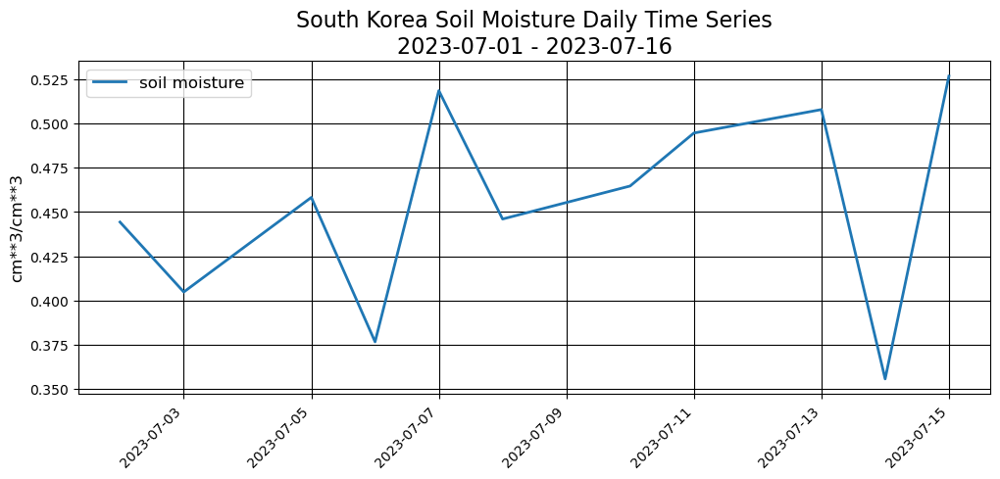

In [18]:
title = f'South Korea Soil Moisture Daily Time Series\n{str(start_sk_flood)[:10]} - {str(end_sk_flood)[:10]}'
plotting.timeseries_plot([(sk_smap_timeseries['mean'], 'soil moisture')], '', 'cm**3/cm**3', title)

In [19]:
# Connect to GIBS WMS Service
wms = WebMapService('https://gibs.earthdata.nasa.gov/wms/epsg4326/best/wms.cgi?', version='1.3.0')

layers = ['BlueMarble_NextGeneration',
          'SMAP_L3_Passive_Enhanced_Day_Soil_Moisture',
          'Reference_Features',
          'Reference_Labels']
font = ImageFont.truetype('Roboto-Bold.ttf', size=18)
color = 'rgb(255,255,255)'
frames = []
dates = pd.date_range(start_sk_flood, end_sk_flood,freq='d')

print(f'Obtaining {len(dates)} days of imagery...')

raw_colormap = I.open(BytesIO(requests.get('https://gibs.earthdata.nasa.gov/legends/SMAP_Soil_Moisture_H.png').content))
colormap = I.new("RGBA", raw_colormap.size, (255, 255, 255) + (255,))
colormap.paste(raw_colormap, mask=raw_colormap.convert('RGBA').split()[-1])

for date in dates:
    datatime = date.strftime("%Y-%m-%d")
    
    # Get IMERG_Precipitation_Rate
    img = wms.getmap(layers=layers,  # Layers
                    srs='epsg:4326',  # Map projection
                    bbox=(110,30,145,44),  # Bounds
                    size=(700, 450),  # Image size
                    time=datatime,  # Time of data
                    format='image/png',  # Image format
                    transparent=True)  # Nodata transparency
    image = I.open(img)
    img_w, img_h = image.size
    background = I.new('RGBA', (img_w, img_h + colormap.size[1]), (255, 255, 255, 255))
    bg_w, bg_h = background.size
    offset = (0, 0)
    background.paste(image, offset)
    background.paste(colormap, ((bg_w - colormap.width) // 2, img_h))
    draw = ImageDraw.Draw(background)
    (x, y) = (225, 12)
    draw.text((x, y), f'SMAP Soil Moisture - {datatime}', fill='rgb(255,255,255)', font=font)
    frames.append(background)

Obtaining 16 days of imagery...


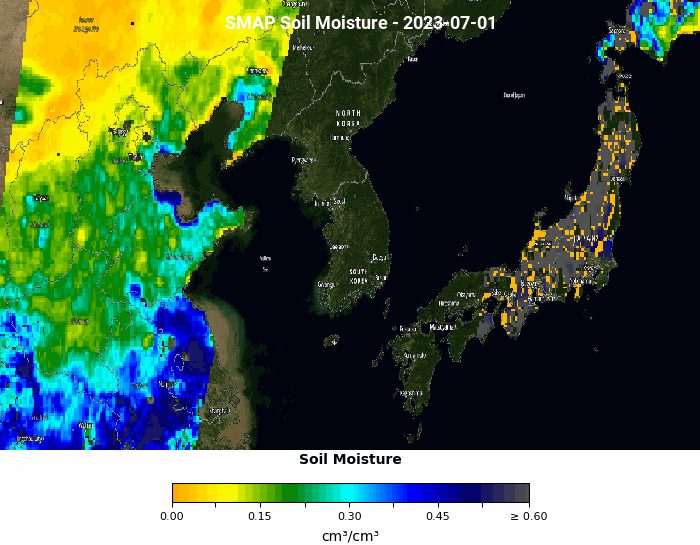

In [20]:
frames[0].save('SMAP_SK.gif',
               format='GIF',
               append_images=frames,
               save_all=True,
               duration=500,
               loop=0)
Image('SMAP_SK.gif')

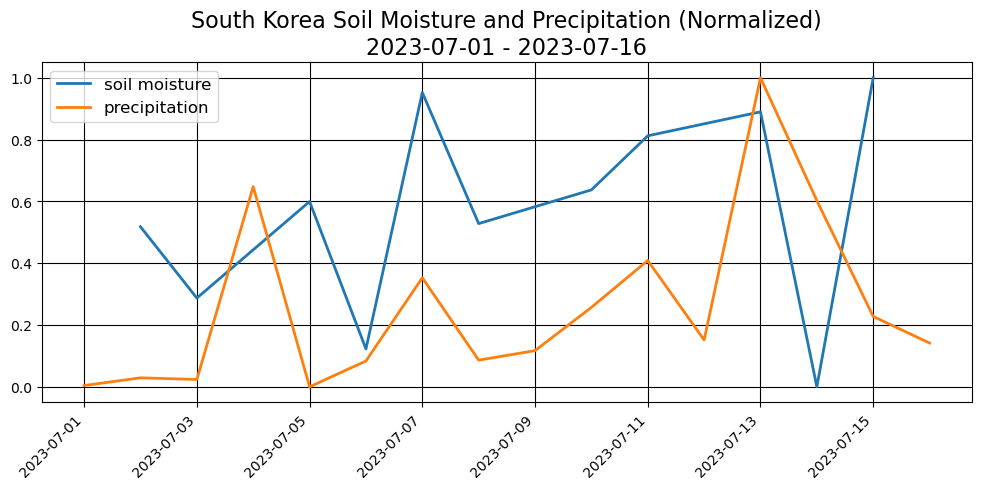

In [21]:
title = f'South Korea Soil Moisture and Precipitation (Normalized)\n{str(start_sk_flood)[:10]} - {str(end_sk_flood)[:10]}'
plotting.timeseries_plot([(sk_smap_timeseries['mean'], 'soil moisture'), (sk_gpm_timeseries['mean'], 'precipitation')], '', '', title, norm=True)

In [22]:
sk_smap_subset = ideas_processing.data_subsetting(*sk_smap_parameters)

url
 https://ideas-digitaltwin.jpl.nasa.gov/nexus/datainbounds?ds=SPL3SMP_AM_soil_moisture&b=125.5,34.15,130,38.62&startTime=2023-07-01T00:00:00Z&endTime=2023-07-16T00:00:00Z&lowPassFilter=False

Waiting for response from IDEAS...took 0.5692630420089699 seconds


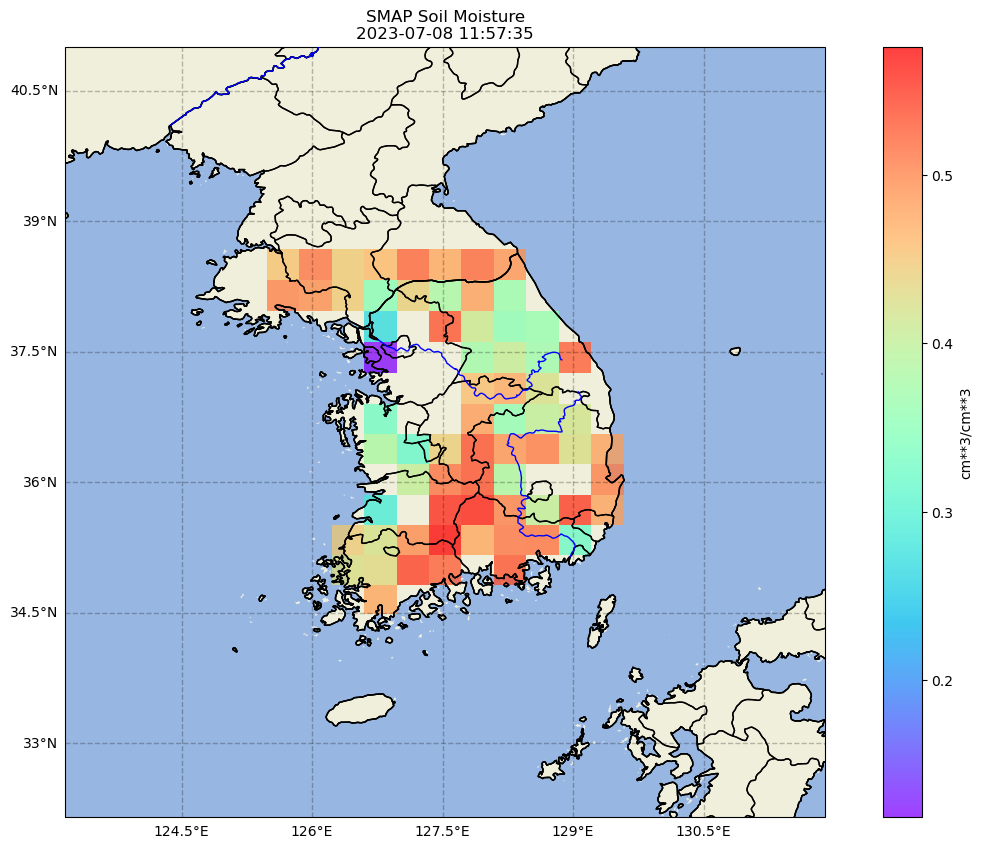

In [23]:
plotting.map_data(sk_smap_subset[5], f'SMAP Soil Moisture\n{datetime.utcfromtimestamp(sk_smap_subset[5].time.values)}', cb_label='cm**3/cm**3')

# Pakistan Flood 2022

Find the peak of the flood using GPM precipitation data and visualize it.

- data set: GPM_3IMERGDL_precipitationCal
- spatial bounds:  63, 23, 75, 33
- temporal bounds: 2022-06-01 to 2022-09-25
- area of interest: Pakistan

In [24]:
bb_pakistan_flood       = {'min_lon': 66, 'max_lon': 75, 'min_lat': 23, 'max_lat': 35}
start_pakistan_flood    = datetime(2022, 6, 1)
end_pakistan_flood      = datetime(2022, 9, 25)
global_precipitation_dataset  = 'GPM_3IMERGDL_precipitationCal'
pakistan_parameters = (NEXUS_URL, global_precipitation_dataset, bb_pakistan_flood, start_pakistan_flood, end_pakistan_flood)

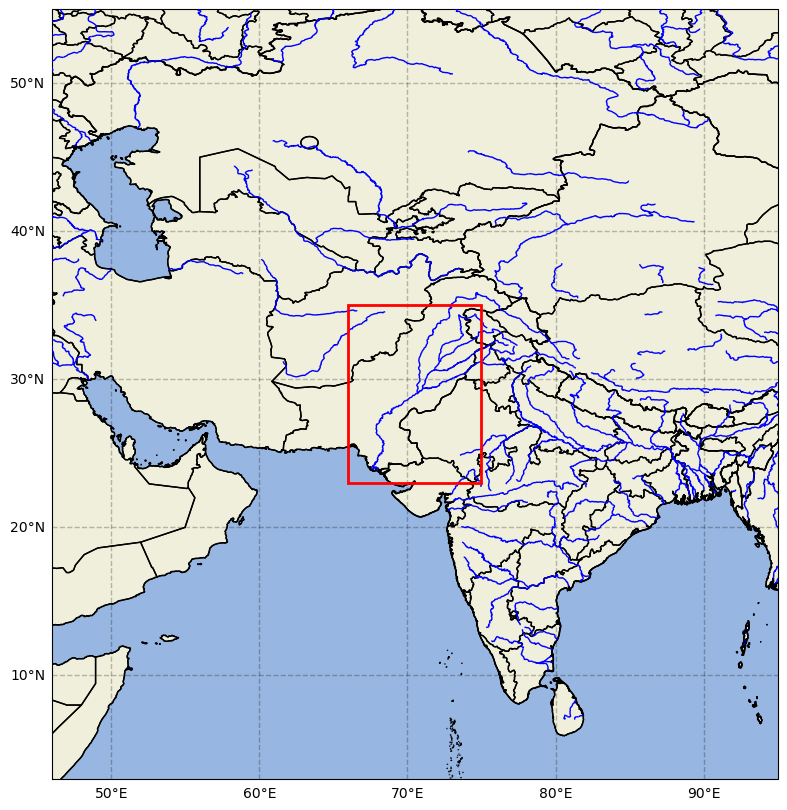

In [25]:
plotting.map_box(bb_pakistan_flood)

#### GPM Mean From 2022-06-01 to 2022-09-25

In [26]:
pakistan_timeseries = ideas_processing.spatial_timeseries(*pakistan_parameters)

url
 https://ideas-digitaltwin.jpl.nasa.gov/nexus/timeSeriesSpark?ds=GPM_3IMERGDL_precipitationCal&minLon=66&minLat=23&maxLon=75&maxLat=35&startTime=2022-06-01T00:00:00Z&endTime=2022-09-25T00:00:00Z&lowPassFilter=False

Waiting for response from IDEAS...took 2.937432083999738 seconds


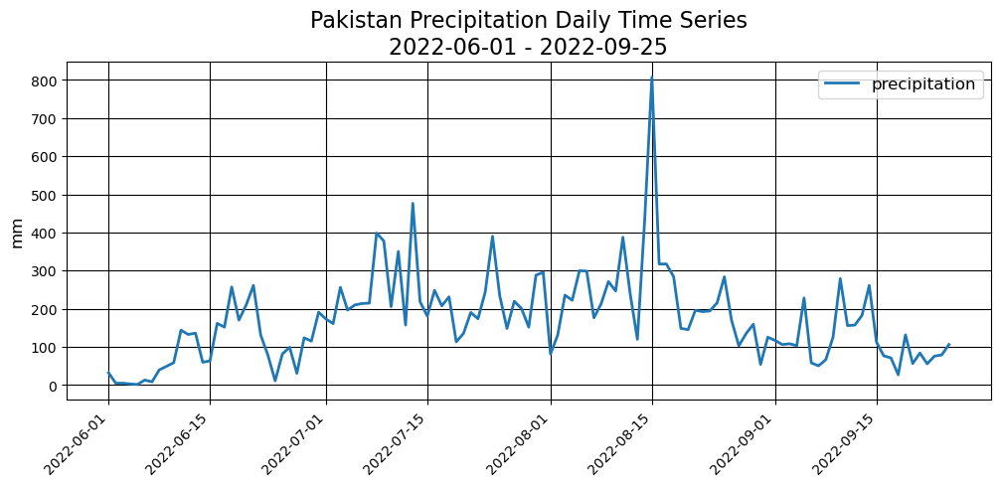

In [27]:
title = f'Pakistan Precipitation Daily Time Series\n{str(start_pakistan_flood)[:10]} - {str(end_pakistan_flood)[:10]}'
plotting.timeseries_plot([(pakistan_timeseries['maximum'], 'precipitation')], '', 'mm', title)

**For more context, in the 2021 water year (October 1st 2020 to Sept 30th 2021), the state of California received about 300 mm of precipitation. This is only slightly more than the precipitation Pakistan was receiving some days during the floods.**

#### Data Subsetting

Fetches point values for a given dataset and geographical area.

In [28]:
pakistan_date = datetime(2022, 7, 6)
pakistan_subset_data = ideas_processing.data_subsetting(NEXUS_URL, global_precipitation_dataset, bb_pakistan_flood, pakistan_date, pakistan_date)

url
 https://ideas-digitaltwin.jpl.nasa.gov/nexus/datainbounds?ds=GPM_3IMERGDL_precipitationCal&b=66,23,75,35&startTime=2022-07-06T00:00:00Z&endTime=2022-07-06T00:00:00Z&lowPassFilter=False

Waiting for response from IDEAS...

took 0.9227231250260957 seconds


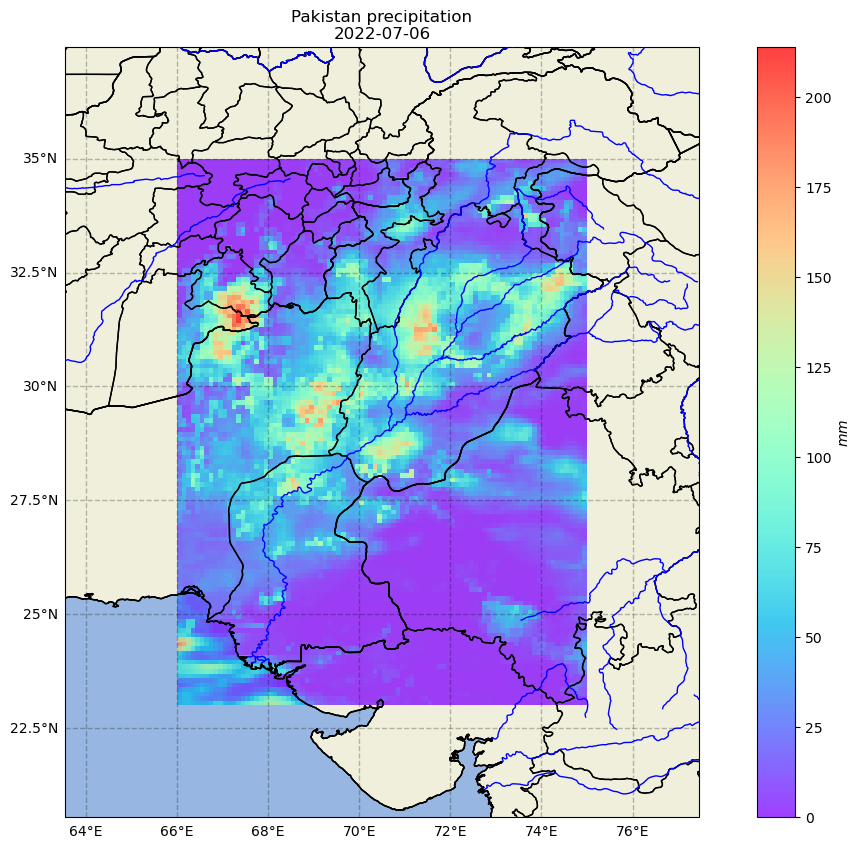

In [29]:
plotting.map_data(pakistan_subset_data[0], f'Pakistan precipitation\n{str(pakistan_date)[:10]}', cb_label="$mm$")

#### IDEAS WMS Visual GPM Precipitation 2022-07-06

In [30]:
# Connect to GIBS WMS Service
wms = WebMapService('https://gibs.earthdata.nasa.gov/wms/epsg4326/best/wms.cgi?', version='1.3.0')

# Get IMERG_Precipitation_Rate
img = wms.getmap(layers=['BlueMarble_NextGeneration',
                         'IMERG_Precipitation_Rate',
                         'Reference_Features',
                         'Reference_Labels'],  # Layers
                 srs='epsg:4326',  # Map projection
                 bbox=(66,23,75,35),  # Bounds
                 size=(500, 500),  # Image size
                 time='2022-07-06',  # Time of data
                 format='image/png',  # Image format
                 transparent=True)  # Nodata transparency

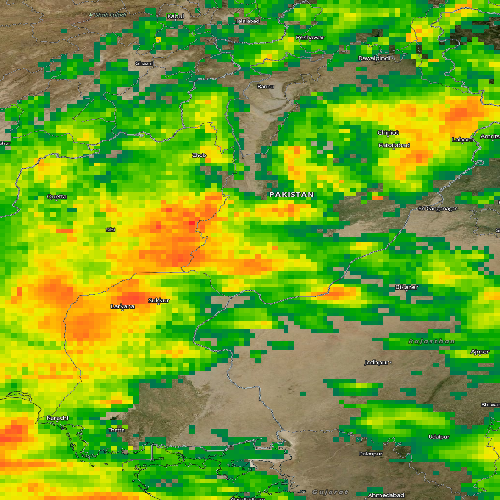

In [31]:
# View image
Image(img.read())

#### IDEAS WMS Animation 2022-07-01 to 2022-07-15

In [32]:
wms = WebMapService('https://gibs.earthdata.nasa.gov/wms/epsg4326/best/wms.cgi?', version='1.3.0')

layers = ['MODIS_Aqua_CorrectedReflectance_TrueColor',
          'IMERG_Precipitation_Rate',
          'Reference_Features',
          'Reference_Labels']
color = 'rgb(255,255,255)'
frames = []

sdate = datetime(2022, 7, 1)
edate = datetime(2022, 7, 15)
dates = pd.date_range(sdate,edate-timedelta(days=1),freq='d')

for day in dates:
    datatime = day.strftime("%Y-%m-%d")
    img = wms.getmap(layers=layers,  # Layers
                     srs='epsg:4326',  # Map projection
                     bbox=(66,23,75,35),  # Bounds
                     size=(500,500),  # Image size
                     time=datatime,  # Time of data
                     format='image/png',  # Image format
                     transparent=True)  # Nodata transparency

    image = I.open(img)
    draw = ImageDraw.Draw(image)
    (x, y) = (50, 20)
    draw.text((x, y), f'IMERG Precipitation Rate   -   {datatime}', fill=color)
    frames.append(image)
    
frames[0].save('IMERG_Precipitation_Rate.gif',
               format='GIF',
               append_images=frames,
               save_all=True,
               duration=1000,
               loop=0)

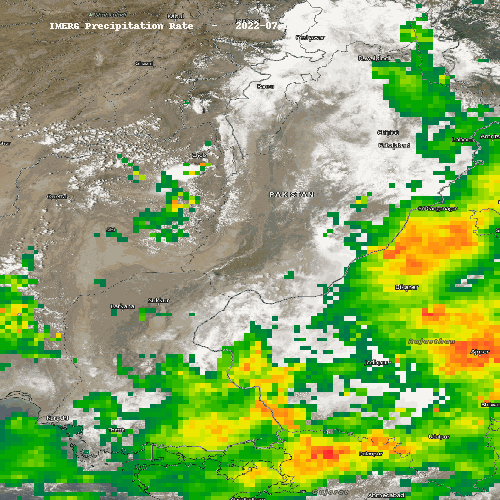

In [33]:
Image('IMERG_Precipitation_Rate.gif')

#### Temporal Mean

Computes a Latitude/Longitude Time Average plot given an arbitrary geographical area and time range

In [34]:
pakistan_timeavg_data = ideas_processing.temporal_mean(NEXUS_URL, global_precipitation_dataset, bb_pakistan_flood, datetime(2022,7,1), datetime(2022,7,15))

url
 https://ideas-digitaltwin.jpl.nasa.gov/nexus/timeAvgMapSpark?ds=GPM_3IMERGDL_precipitationCal&b=66,23,75,35&startTime=2022-07-01T00:00:00Z&endTime=2022-07-15T00:00:00Z

Waiting for response from IDEAS... took 5.378723916015588 seconds


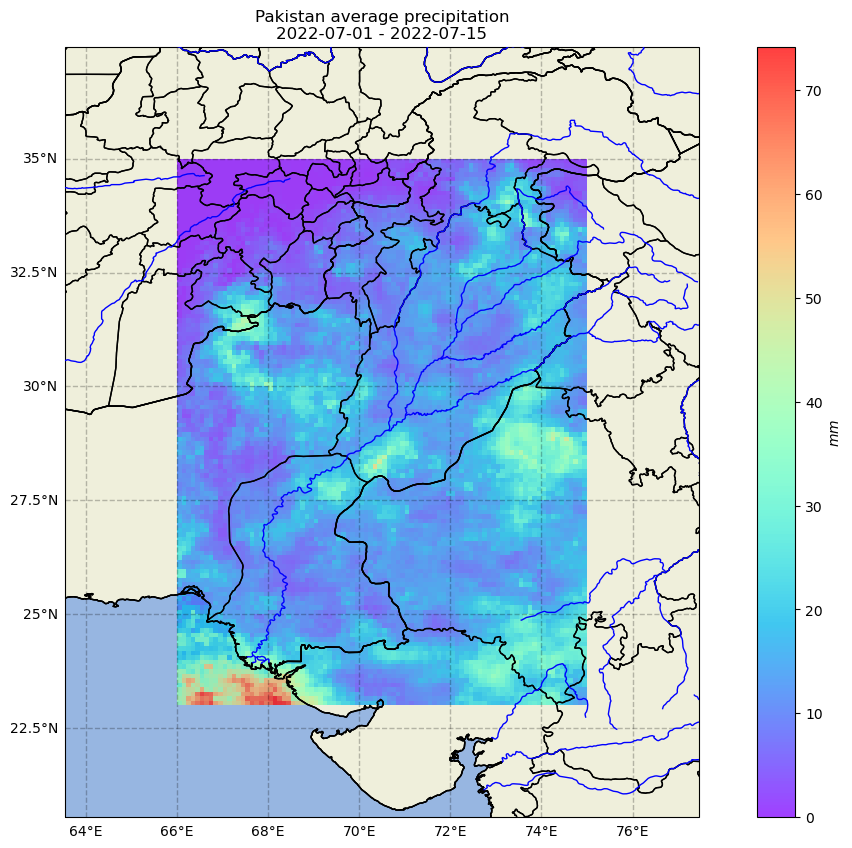

In [35]:
pakistan_timeavg_title = f'Pakistan average precipitation\n{str(datetime(2022,7,1))[:10]} - {str(datetime(2022,7,15))[:10]}'
plotting.map_data(pakistan_timeavg_data, pakistan_timeavg_title, cb_label='$mm$')

#### Temporal Variance

Computes a map of the temporal variance of a field given an arbitrary geographical area and time range.

In [36]:
pakistan_variance_data = ideas_processing.temporal_variance(NEXUS_URL, global_precipitation_dataset, bb_pakistan_flood, datetime(2022,7,1), datetime(2022,7,15))

url
 https://ideas-digitaltwin.jpl.nasa.gov/nexus/varianceSpark?ds=GPM_3IMERGDL_precipitationCal&minLon=66&minLat=23&maxLon=75&maxLat=35&startTime=2022-07-01T00:00:00Z&endTime=2022-07-15T00:00:00Z

Waiting for response from IDEAS... took 2.973372125008609 seconds


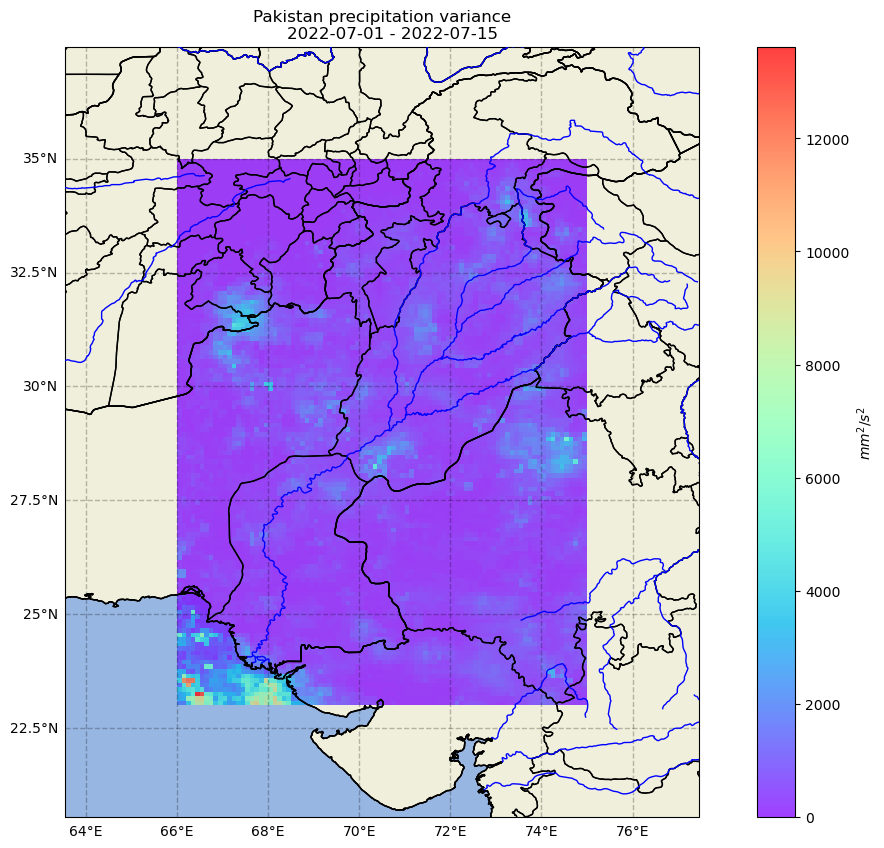

In [37]:
pakistan_variance_title = f'Pakistan precipitation variance\n\
    {str(datetime(2022,7,1))[:10]} - {str(datetime(2022,7,15))[:10]}'
plotting.map_data(pakistan_variance_data, pakistan_variance_title, cb_label='$mm^2/s^2$')

#### Daily Difference Average

Subtracts data in box in Dataset 1 from Dataset 2 (i.e. climatology), then averages the difference per day.

In [38]:
global_precipitation_computed_climatology = 'GPM_3IMERGDL_precipitationCal_clim'
pakistan_daily_diff_data = ideas_processing.daily_diff(NEXUS_URL, global_precipitation_dataset, global_precipitation_computed_climatology, bb_pakistan_flood, start_pakistan_flood, end_pakistan_flood)

url
 https://ideas-digitaltwin.jpl.nasa.gov/nexus/dailydifferenceaverage_spark?dataset=GPM_3IMERGDL_precipitationCal&climatology=GPM_3IMERGDL_precipitationCal_clim&b=66,23,75,35&startTime=2022-06-01T00:00:00Z&endTime=2022-09-25T00:00:00Z

Waiting for response from IDEAS... took 23.85702104200027 seconds


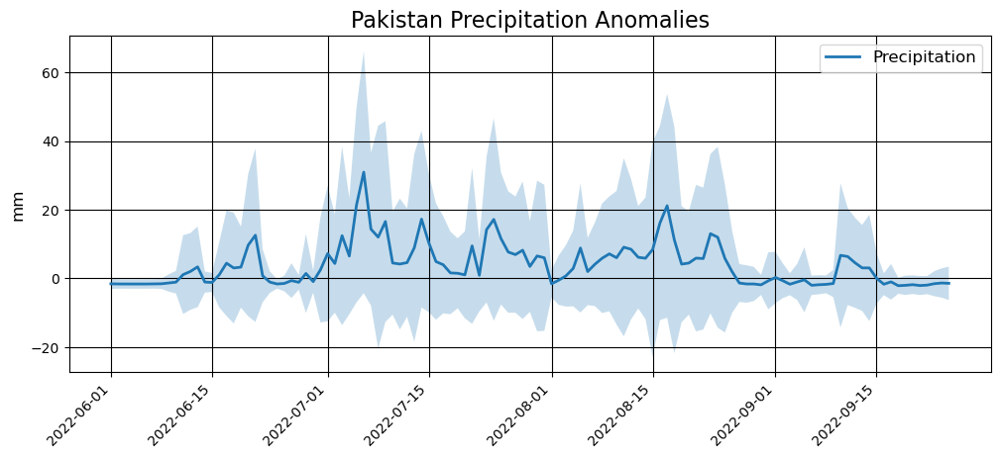

In [39]:
plotting.timeseries_bands_plot(pakistan_daily_diff_data, 'Precipitation', '', 'mm', 'Pakistan Precipitation Anomalies')

# Hurricane Ian Florida Landfall

In [40]:
bb_hurricane_ian      = {'min_lon': -87, 'max_lon': -72, 'min_lat': 18, 'max_lat': 35}
start_hurricane_ian   = datetime(2022, 9, 24)
end_hurricane_ian     = datetime(2022, 10, 2)
ian_parameters = (NEXUS_URL, global_precipitation_dataset, bb_hurricane_ian, start_hurricane_ian, end_hurricane_ian)

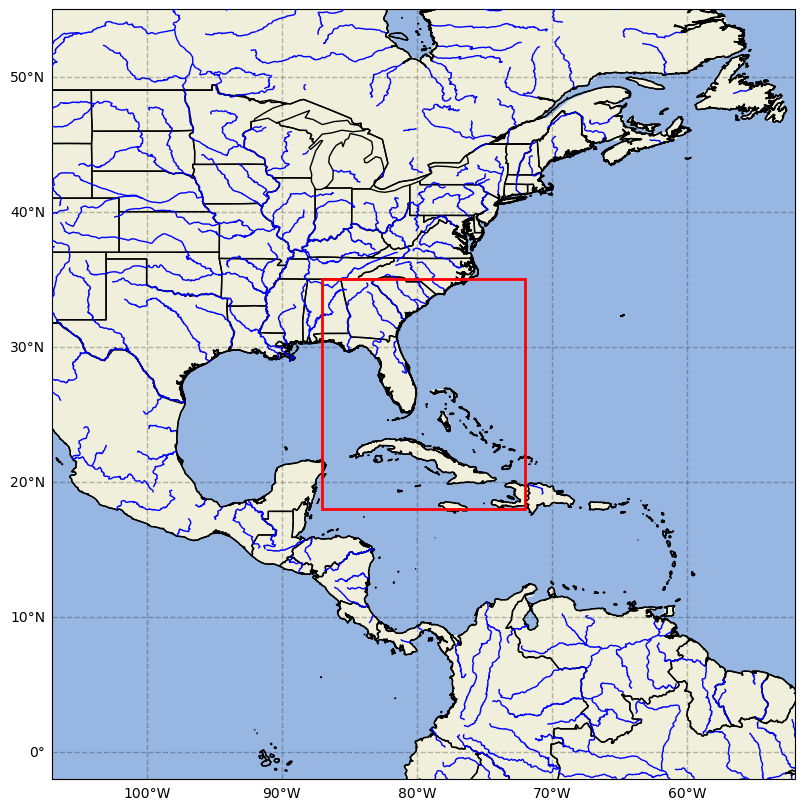

In [41]:
# Plot a box around our spatial bounds
plotting.map_box(bb_hurricane_ian)

In [42]:
ian_timeseries = ideas_processing.spatial_timeseries(*ian_parameters)

url
 https://ideas-digitaltwin.jpl.nasa.gov/nexus/timeSeriesSpark?ds=GPM_3IMERGDL_precipitationCal&minLon=-87&minLat=18&maxLon=-72&maxLat=35&startTime=2022-09-24T00:00:00Z&endTime=2022-10-02T00:00:00Z&lowPassFilter=False

Waiting for response from IDEAS...

took 2.153776958002709 seconds


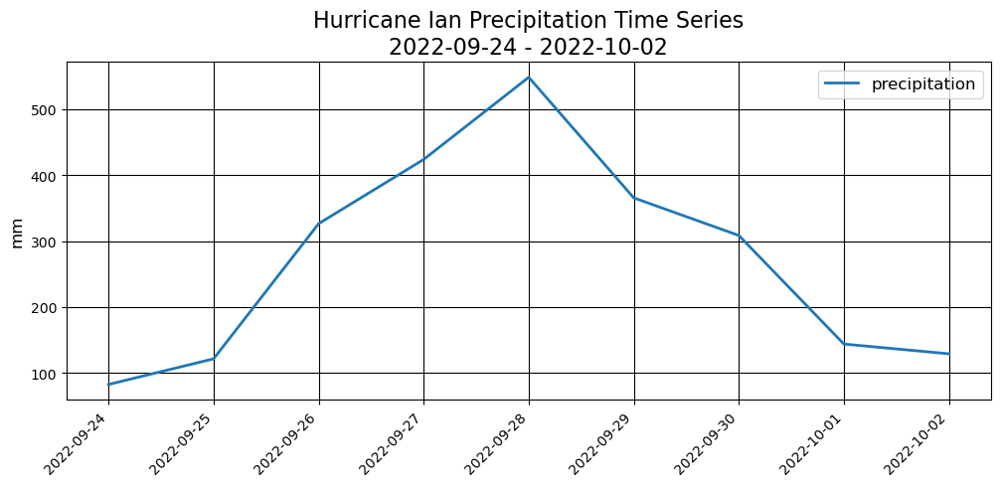

In [43]:
ian_title = f'Hurricane Ian Precipitation Time Series\n{str(start_hurricane_ian)[:10]} - {str(end_hurricane_ian)[:10]}'
plotting.timeseries_plot([(ian_timeseries.maximum, 'precipitation')], '', 'mm', ian_title)

In [44]:
ian_start = datetime(2022,9,25)
ian_end = datetime(2022,10,1)
ian_precipitation_data = ideas_processing.temporal_mean(NEXUS_URL, global_precipitation_dataset, bb_hurricane_ian, ian_start, ian_end)

url
 https://ideas-digitaltwin.jpl.nasa.gov/nexus/timeAvgMapSpark?ds=GPM_3IMERGDL_precipitationCal&b=-87,18,-72,35&startTime=2022-09-25T00:00:00Z&endTime=2022-10-01T00:00:00Z

Waiting for response from IDEAS... took 2.3184704589948524 seconds


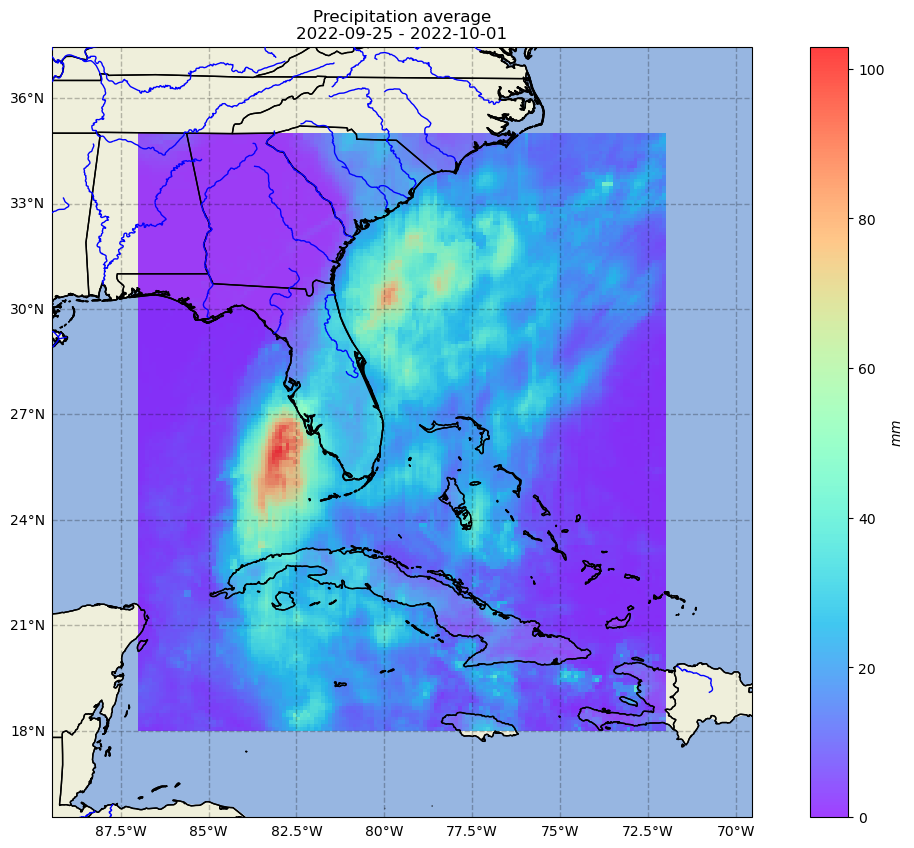

In [45]:
ian_title = f'Precipitation average\n{str(ian_start)[:10]} - {str(ian_end)[:10]}'
plotting.map_data(ian_precipitation_data, ian_title, cb_label='$mm$')

#### Daily Difference Average

Subtracts data in box in Dataset 1 from Dataset 2 (i.e. climatology), then averages the difference per day.

In [46]:
ian_daily_diff_data = ideas_processing.daily_diff(NEXUS_URL, global_precipitation_dataset, global_precipitation_computed_climatology, bb_hurricane_ian, start_hurricane_ian, end_hurricane_ian)

url
 https://ideas-digitaltwin.jpl.nasa.gov/nexus/dailydifferenceaverage_spark?dataset=GPM_3IMERGDL_precipitationCal&climatology=GPM_3IMERGDL_precipitationCal_clim&b=-87,18,-72,35&startTime=2022-09-24T00:00:00Z&endTime=2022-10-02T00:00:00Z

Waiting for response from IDEAS... took 7.211050167010399 seconds


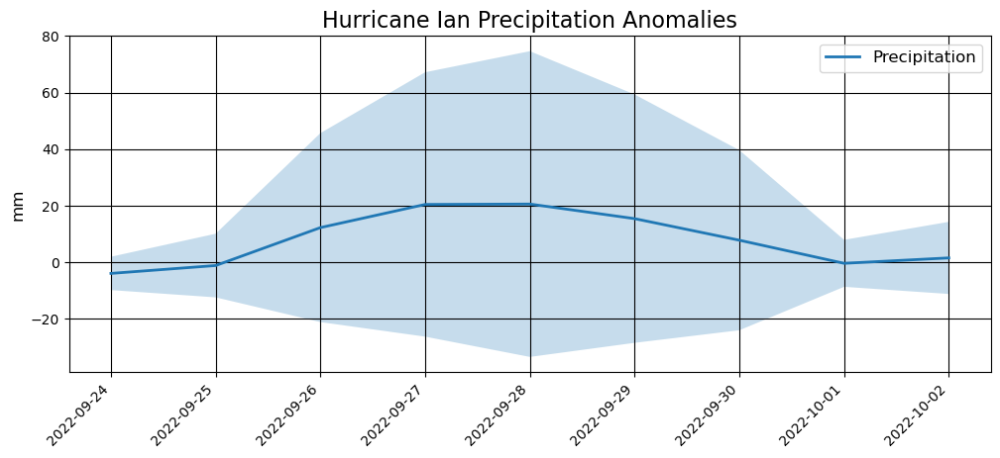

In [47]:
plotting.timeseries_bands_plot(ian_daily_diff_data, 'Precipitation', '', 'mm', 'Hurricane Ian Precipitation Anomalies')

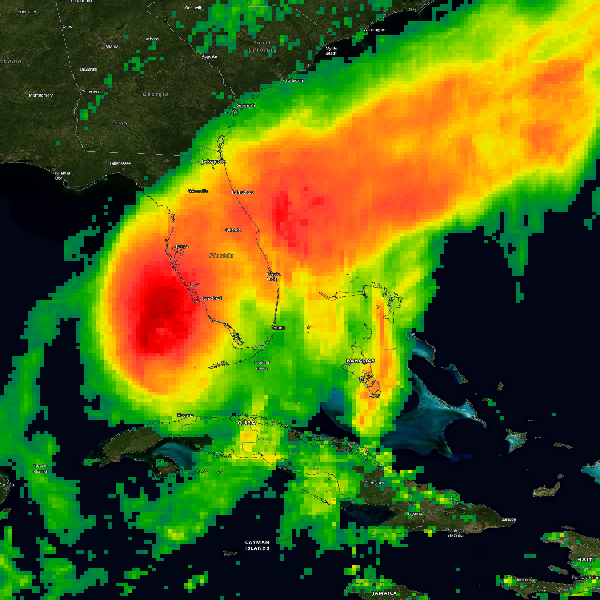

In [48]:
# Connect to GIBS WMS Service
wms = WebMapService('https://gibs.earthdata.nasa.gov/wms/epsg4326/best/wms.cgi?', version='1.3.0')

# Get IMERG_Precipitation_Rate
img = wms.getmap(layers=['BlueMarble_NextGeneration',
                         'IMERG_Precipitation_Rate',
                         'Reference_Features',
                         'Reference_Labels'],  # Layers
                 srs='epsg:4326',  # Map projection
                 bbox=(-87, 18, -72, 35),  # Bounds
                 size=(600, 600),  # Image size
                 time='2022-09-28',  # Time of data
                 format='image/png',  # Image format
                 transparent=True)  # Nodata transparency

# Save output PNG to a file
out = open('IMERG_Precipitation_Rate_2022-09-28.png', 'wb')
out.write(img.read())
out.close()

# View image
Image('IMERG_Precipitation_Rate_2022-09-28.png')

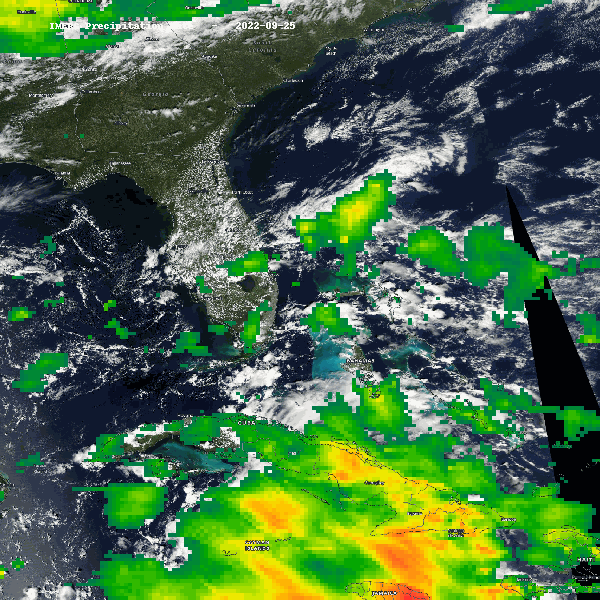

In [49]:
wms = WebMapService('https://gibs.earthdata.nasa.gov/wms/epsg4326/best/wms.cgi?', version='1.3.0')

layers = ['MODIS_Aqua_CorrectedReflectance_TrueColor',
          'IMERG_Precipitation_Rate',
          'Reference_Features',
          'Reference_Labels']
color = 'rgb(255,255,255)'
frames = []

sdate = datetime(2022, 9, 25)
edate = datetime(2022, 10, 1)
dates = pd.date_range(sdate,edate-timedelta(days=1),freq='d')

for day in dates:
    datatime = day.strftime("%Y-%m-%d")
    img = wms.getmap(layers=layers,  # Layers
                     srs='epsg:4326',  # Map projection
                     bbox=(-87, 18, -72, 35),  # Bounds
                     size=(600,600),  # Image size
                     time=datatime,  # Time of data
                     format='image/png',  # Image format
                     transparent=True)  # Nodata transparency

    image = I.open(img)
    draw = ImageDraw.Draw(image)
    (x, y) = (50, 20)
    draw.text((x, y), f'IMERG Precipitation Rate   -   {datatime}', fill=color)
    frames.append(image)
    
frames[0].save('IMERG_Precipitation_Rate_Ian.gif',
               format='GIF',
               append_images=frames,
               save_all=True,
               duration=1000,
               loop=0)

Image('IMERG_Precipitation_Rate_Ian.gif')

# France storm 2021-12-31 - 2022-01-31

In [50]:
bb_france      = {'min_lon': -4.297, 'max_lon': 4.324, 'min_lat': 41.662, 'max_lat': 48.845}
start_france   = datetime(2021, 12, 31)
end_france     = datetime(2022, 1, 31)
france_parameters = (NEXUS_URL, global_precipitation_dataset, bb_france, start_france, end_france)

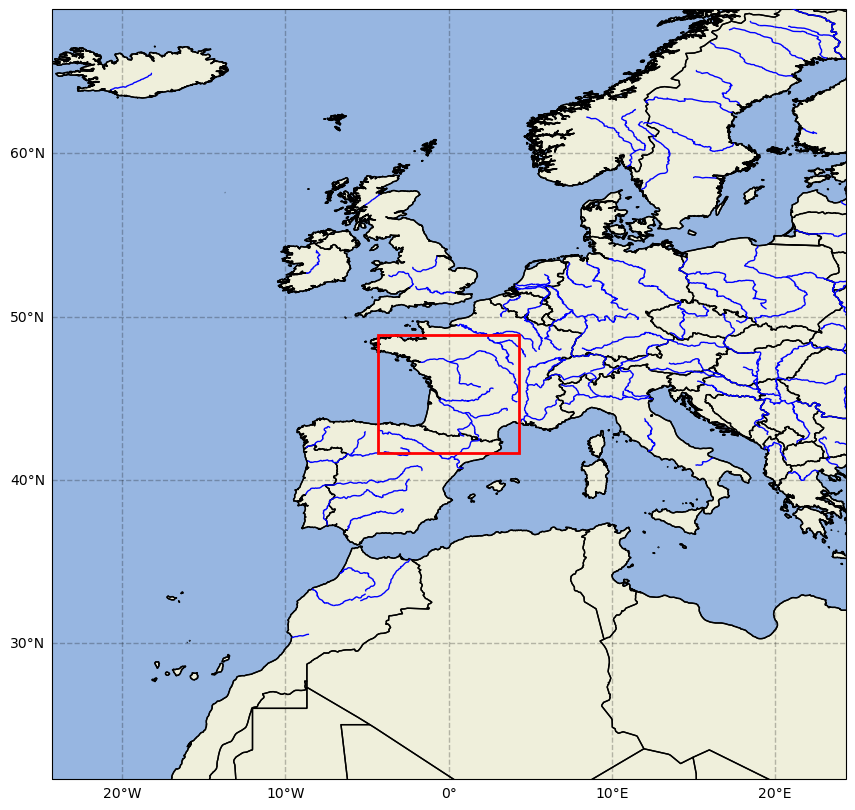

In [51]:
# Plot a box around our spatial bounds
plotting.map_box(bb_france)

In [52]:
france_timeseries = ideas_processing.spatial_timeseries(*france_parameters)

url
 https://ideas-digitaltwin.jpl.nasa.gov/nexus/timeSeriesSpark?ds=GPM_3IMERGDL_precipitationCal&minLon=-4.297&minLat=41.662&maxLon=4.324&maxLat=48.845&startTime=2021-12-31T00:00:00Z&endTime=2022-01-31T00:00:00Z&lowPassFilter=False

Waiting for response from IDEAS...took 2.2601257089991122 seconds


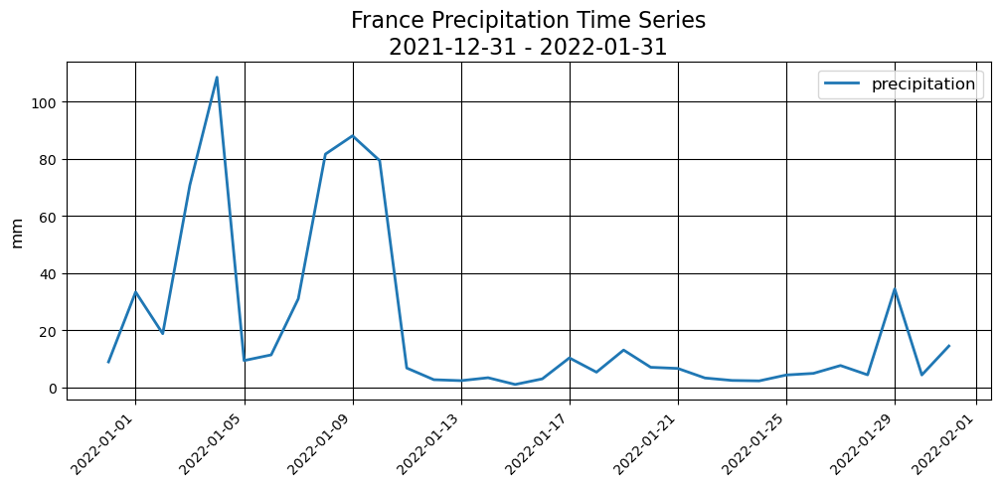

In [53]:
france_title = f'France Precipitation Time Series\n{str(start_france)[:10]} - {str(end_france)[:10]}'
plotting.timeseries_plot([(france_timeseries.maximum, 'precipitation')], '', 'mm', france_title)

In [54]:
france_start = datetime(2022,1,5)
france_end = datetime(2022,1,10)
france_precipitation_data = ideas_processing.temporal_mean(NEXUS_URL, global_precipitation_dataset, bb_france, france_start, france_end)

url
 https://ideas-digitaltwin.jpl.nasa.gov/nexus/timeAvgMapSpark?ds=GPM_3IMERGDL_precipitationCal&b=-4.297,41.662,4.324,48.845&startTime=2022-01-05T00:00:00Z&endTime=2022-01-10T00:00:00Z

Waiting for response from IDEAS... took 1.5758453750167973 seconds


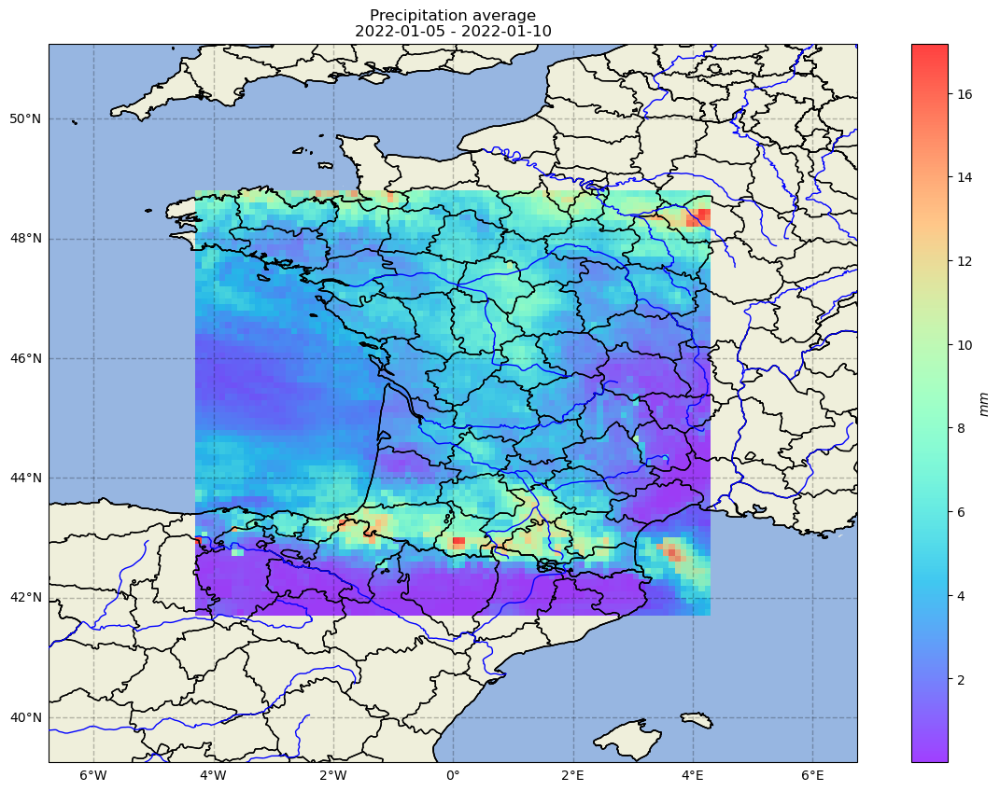

In [55]:
france_title = f'Precipitation average\n{str(france_start)[:10]} - {str(france_end)[:10]}'
plotting.map_data(france_precipitation_data, france_title, cb_label='$mm$')

#### Daily Difference Average

Subtracts data in box in Dataset 1 from Dataset 2 (i.e. climatology), then averages the difference per day.

In [56]:
france_daily_diff_data = ideas_processing.daily_diff(NEXUS_URL, global_precipitation_dataset, global_precipitation_computed_climatology, bb_france, start_france, end_france)

url
 https://ideas-digitaltwin.jpl.nasa.gov/nexus/dailydifferenceaverage_spark?dataset=GPM_3IMERGDL_precipitationCal&climatology=GPM_3IMERGDL_precipitationCal_clim&b=-4.297,41.662,4.324,48.845&startTime=2021-12-31T00:00:00Z&endTime=2022-01-31T00:00:00Z

Waiting for response from IDEAS... took 4.254798917012522 seconds


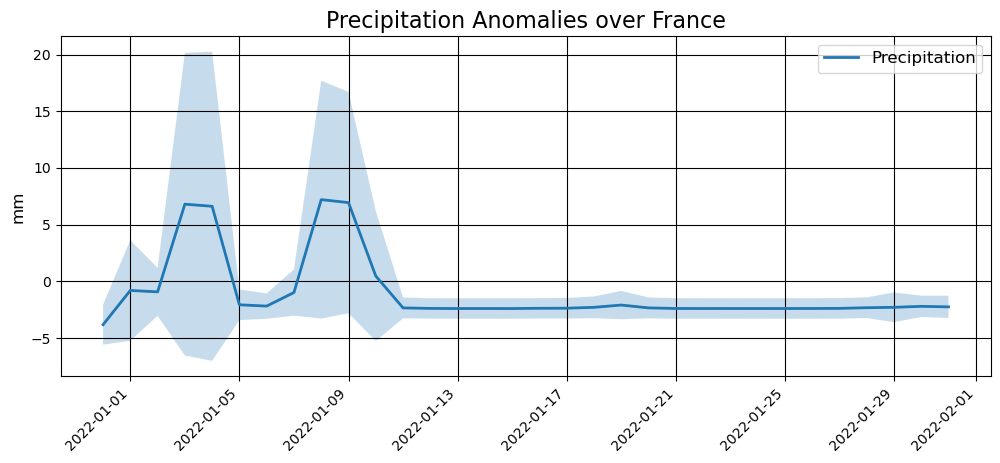

In [57]:
plotting.timeseries_bands_plot(france_daily_diff_data, 'Precipitation', '', 'mm', 'Precipitation Anomalies over France')

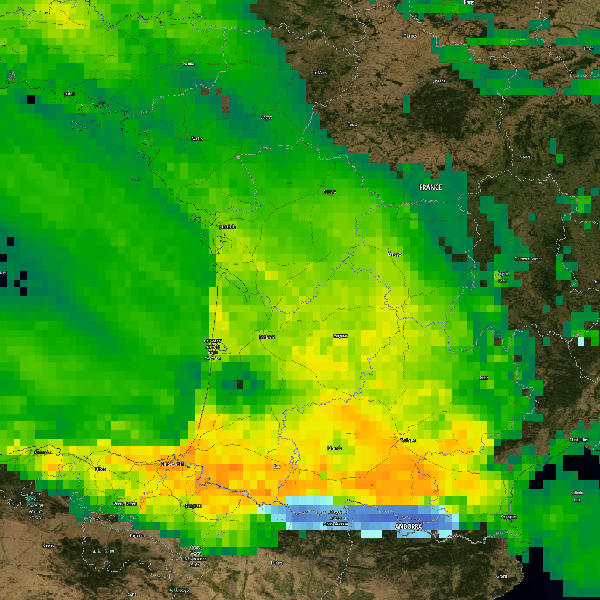

In [58]:
# Connect to GIBS WMS Service
wms = WebMapService('https://gibs.earthdata.nasa.gov/wms/epsg4326/best/wms.cgi?', version='1.3.0')

# Get IMERG_Precipitation_Rate
img = wms.getmap(layers=['BlueMarble_NextGeneration',
                         'IMERG_Precipitation_Rate',
                         'Reference_Features',
                         'Reference_Labels'],  # Layers
                 srs='epsg:4326',  # Map projection
                 bbox=( -4.297, 41.662, 4.324, 48.845),  # Bounds
                 size=(600, 600),  # Image size
                 time='2022-01-09',  # Time of data
                 format='image/png',  # Image format
                 transparent=True)  # Nodata transparency

# Save output PNG to a file
out = open('IMERG_Precipitation_Rate_2022-01-09.png', 'wb')
out.write(img.read())
out.close()

# View image
Image('IMERG_Precipitation_Rate_2022-01-09.png')

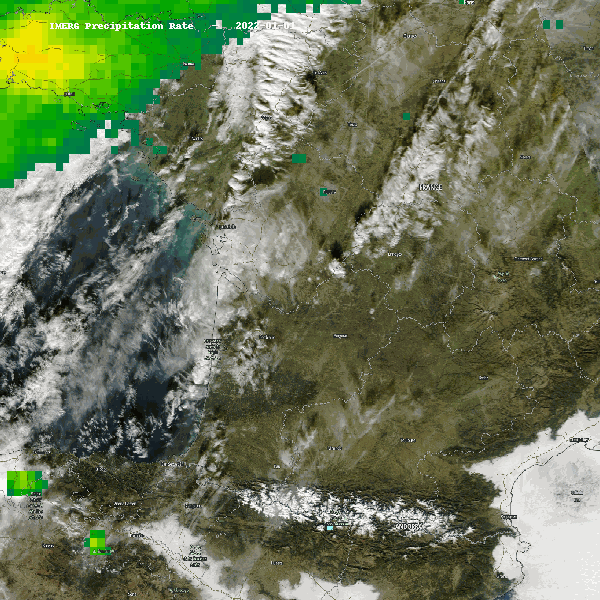

In [59]:
wms = WebMapService('https://gibs.earthdata.nasa.gov/wms/epsg4326/best/wms.cgi?', version='1.3.0')

layers = ['MODIS_Aqua_CorrectedReflectance_TrueColor',
          'IMERG_Precipitation_Rate',
          'Reference_Features',
          'Reference_Labels']
color = 'rgb(255,255,255)'
frames = []

sdate = datetime(2022, 1, 1)
edate = datetime(2022, 1, 13)
dates = pd.date_range(sdate,edate-timedelta(days=1),freq='d')

for day in dates:
    datatime = day.strftime("%Y-%m-%d")
    img = wms.getmap(layers=layers,  # Layers
                     srs='epsg:4326',  # Map projection
                     bbox=( -4.297, 41.662, 4.324, 48.845),  # Bounds
                     size=(600,600),  # Image size
                     time=datatime,  # Time of data
                     format='image/png',  # Image format
                     transparent=True)  # Nodata transparency

    image = I.open(img)
    draw = ImageDraw.Draw(image)
    (x, y) = (50, 20)
    draw.text((x, y), f'IMERG Precipitation Rate   -   {datatime}', fill=color)
    frames.append(image)
    
frames[0].save('IMERG_Precipitation_Rate_Garonne.gif',
               format='GIF',
               append_images=frames,
               save_all=True,
               duration=1000,
               loop=0)

Image('IMERG_Precipitation_Rate_Garonne.gif')

# Flooding in Mississippi River Basin

In [60]:
miss_bb       = {'min_lon': -94.5, 'max_lon': -87, 'min_lat': 28, 'max_lat': 37.5}
miss_start    = datetime(2019, 2, 14)
miss_end     = datetime(2019, 8, 31)
miss_lis_noahmp_params = [(NEXUS_URL, ds, miss_bb, miss_start, miss_end) for ds in ['LIS_miss_1x_Qs_tavg', 'LIS_miss_1x_Qsb_tavg']]

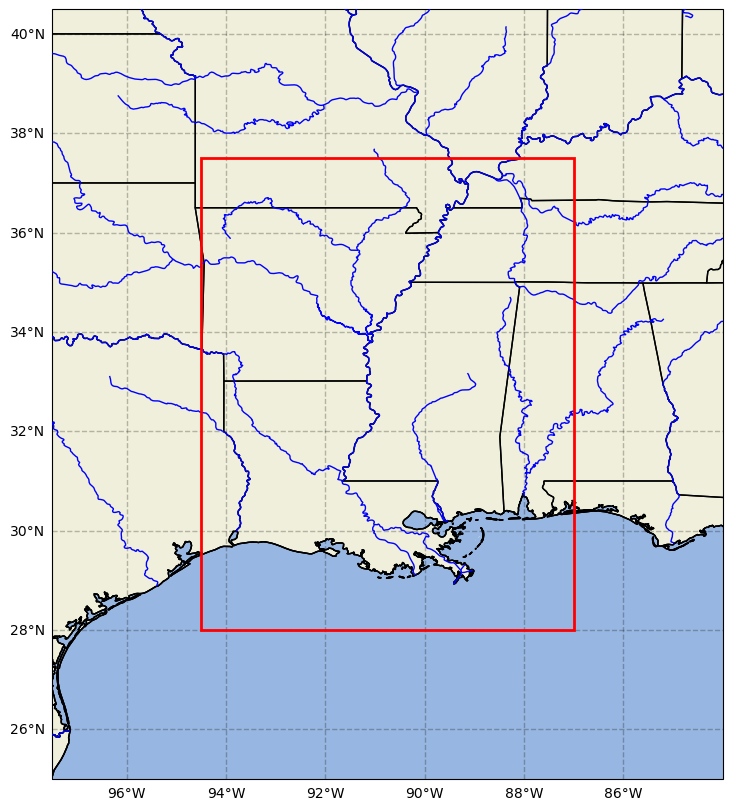

In [61]:
plotting.map_box(miss_bb, 3)

In [62]:
gpm_miss_ts = ideas_processing.spatial_timeseries(NEXUS_URL, 'GPM_3IMERGDL_precipitationCal', miss_bb, miss_start, miss_end)

url
 https://ideas-digitaltwin.jpl.nasa.gov/nexus/timeSeriesSpark?ds=GPM_3IMERGDL_precipitationCal&minLon=-94.5&minLat=28&maxLon=-87&maxLat=37.5&startTime=2019-02-14T00:00:00Z&endTime=2019-08-31T00:00:00Z&lowPassFilter=False

Waiting for response from IDEAS...took 4.107897209003568 seconds


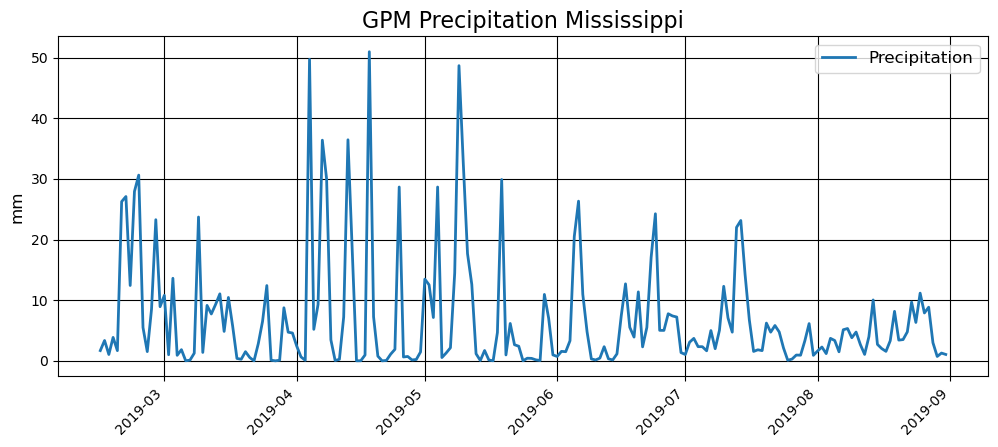

In [63]:
plotting.timeseries_plot([(gpm_miss_ts['mean'], 'Precipitation', 'tab:blue')], '', 'mm', 'GPM Precipitation Mississippi')

In [64]:
smap_miss_ts = ideas_processing.spatial_timeseries(NEXUS_URL, 'SPL3SMP_AM_soil_moisture', miss_bb, miss_start, miss_end)

url
 https://ideas-digitaltwin.jpl.nasa.gov/nexus/timeSeriesSpark?ds=SPL3SMP_AM_soil_moisture&minLon=-94.5&minLat=28&maxLon=-87&maxLat=37.5&startTime=2019-02-14T00:00:00Z&endTime=2019-08-31T00:00:00Z&lowPassFilter=False

Waiting for response from IDEAS...took 2.726883082999848 seconds


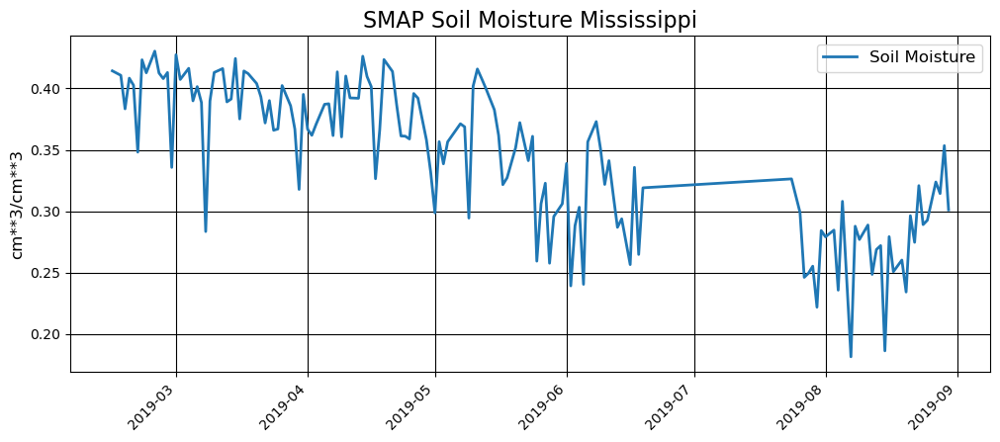

In [65]:
plotting.timeseries_plot([(smap_miss_ts['mean'], 'Soil Moisture', 'tab:blue')], '', 'cm**3/cm**3', 'SMAP Soil Moisture Mississippi')

In [66]:
smap_miss_subset = ideas_processing.data_subsetting(NEXUS_URL, 'SPL3SMP_AM_soil_moisture', miss_bb, datetime(2019,6,11), datetime(2019,6,12))

url
 https://ideas-digitaltwin.jpl.nasa.gov/nexus/datainbounds?ds=SPL3SMP_AM_soil_moisture&b=-94.5,28,-87,37.5&startTime=2019-06-11T00:00:00Z&endTime=2019-06-12T00:00:00Z&lowPassFilter=False

Waiting for response from IDEAS...took 0.29032775000086986 seconds


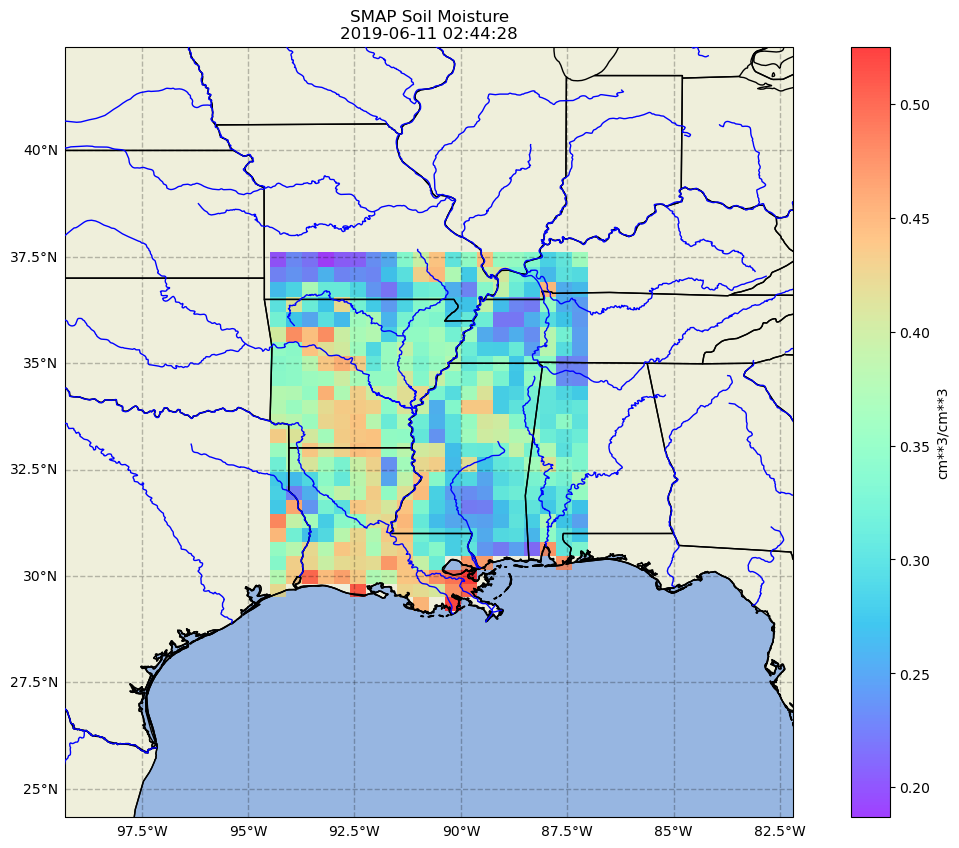

In [67]:
plotting.map_data(smap_miss_subset[0], f'SMAP Soil Moisture\n{datetime.fromtimestamp(smap_miss_subset[0].time.values)}', cb_label='cm**3/cm**3', padding=5)

## LIS NoahMP Runoff and GPM Precipitation

In [68]:
lis_noahmp_miss_ts = [ideas_processing.spatial_timeseries(*miss_param) for miss_param in miss_lis_noahmp_params]

url
 https://ideas-digitaltwin.jpl.nasa.gov/nexus/timeSeriesSpark?ds=LIS_miss_1x_Qs_tavg&minLon=-94.5&minLat=28&maxLon=-87&maxLat=37.5&startTime=2019-02-14T00:00:00Z&endTime=2019-08-31T00:00:00Z&lowPassFilter=False

Waiting for response from IDEAS...took 1.752981291996548 seconds
url
 https://ideas-digitaltwin.jpl.nasa.gov/nexus/timeSeriesSpark?ds=LIS_miss_1x_Qsb_tavg&minLon=-94.5&minLat=28&maxLon=-87&maxLat=37.5&startTime=2019-02-14T00:00:00Z&endTime=2019-08-31T00:00:00Z&lowPassFilter=False

Waiting for response from IDEAS...took 1.6277797920047306 seconds


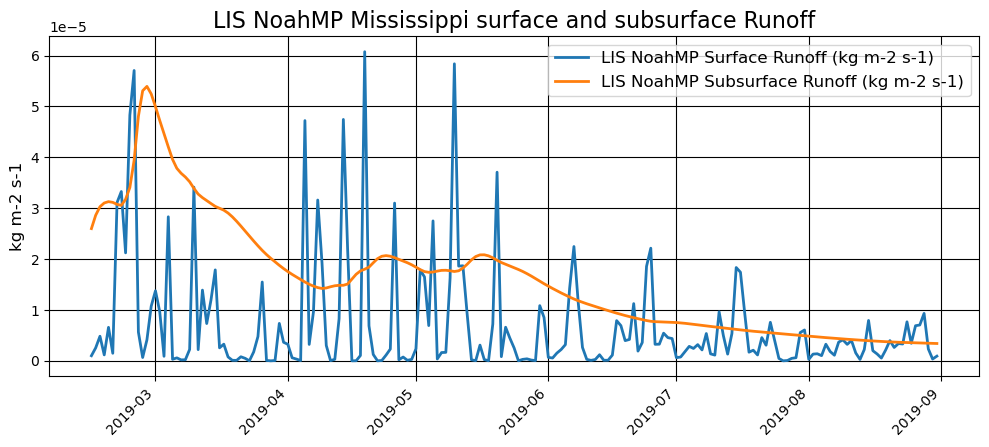

In [69]:
plotting.timeseries_plot([(lis_noahmp_miss_ts[0]['mean'], 'LIS NoahMP Surface Runoff (kg m-2 s-1)', 'tab:blue'), (lis_noahmp_miss_ts[1]['mean'], 'LIS NoahMP Subsurface Runoff (kg m-2 s-1)', 'tab:orange')], '', 'kg m-2 s-1', 'LIS NoahMP Mississippi surface and subsurface Runoff')

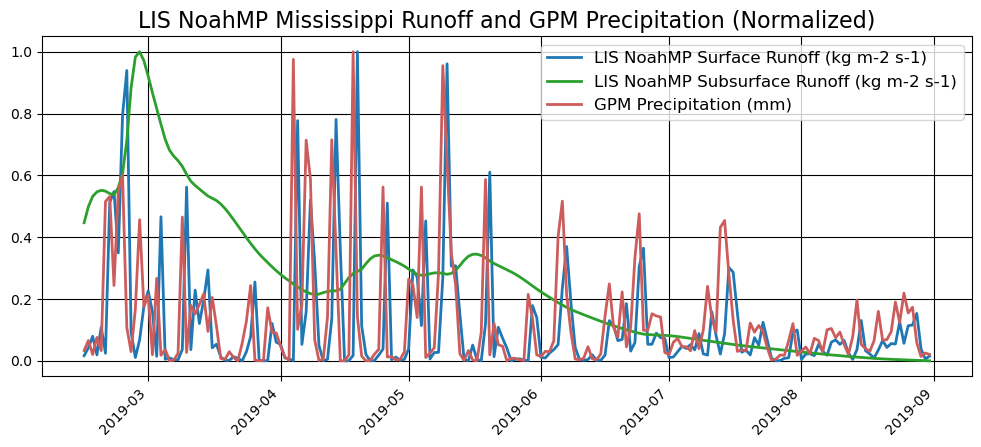

In [70]:
plotting.timeseries_plot([(lis_noahmp_miss_ts[0]['mean'], 'LIS NoahMP Surface Runoff (kg m-2 s-1)', 'tab:blue'), (lis_noahmp_miss_ts[1]['mean'], 'LIS NoahMP Subsurface Runoff (kg m-2 s-1)', 'tab:green'), (gpm_miss_ts['mean'], 'GPM Precipitation (mm)', 'indianred')], '', '', 'LIS NoahMP Mississippi Runoff and GPM Precipitation (Normalized)', norm=True)

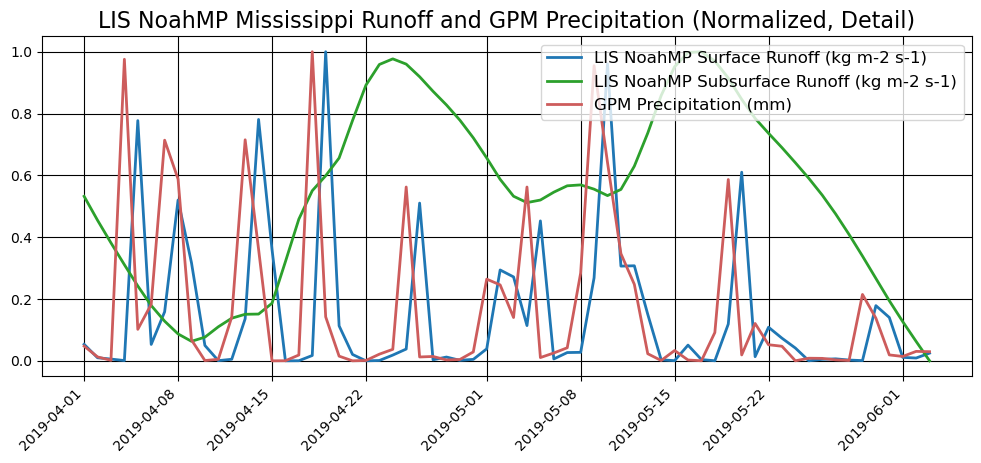

In [71]:
plotting.timeseries_plot([(lis_noahmp_miss_ts[0]['mean'][46:110], 'LIS NoahMP Surface Runoff (kg m-2 s-1)', 'tab:blue'), (lis_noahmp_miss_ts[1]['mean'][46:110], 'LIS NoahMP Subsurface Runoff (kg m-2 s-1)', 'tab:green'), (gpm_miss_ts['mean'][46:110], 'GPM Precipitation (mm)', 'indianred')], '', '', 'LIS NoahMP Mississippi Runoff and GPM Precipitation (Normalized, Detail)', norm=True)

## LIS NoahMP Full Basin

In [72]:
miss_basin_bb       = {'min_lon': -105, 'max_lon': -85, 'min_lat': 27.5, 'max_lat': 54}
miss_start    = datetime(2019, 2, 14)
miss_end     = datetime(2019, 8, 31)
miss_lis_noahmp_basin_params = [(NEXUS_URL, ds, miss_basin_bb, miss_start, miss_end) for ds in ['LIS_miss_1x_Qs_tavg', 'LIS_miss_1x_Qsb_tavg']]

In [73]:
lis_noahmp_miss_tavg = [ideas_processing.temporal_mean(*miss_param) for miss_param in miss_lis_noahmp_basin_params]

url
 https://ideas-digitaltwin.jpl.nasa.gov/nexus/timeAvgMapSpark?ds=LIS_miss_1x_Qs_tavg&b=-105,27.5,-85,54&startTime=2019-02-14T00:00:00Z&endTime=2019-08-31T00:00:00Z

Waiting for response from IDEAS... took 31.839285666006617 seconds
url
 https://ideas-digitaltwin.jpl.nasa.gov/nexus/timeAvgMapSpark?ds=LIS_miss_1x_Qsb_tavg&b=-105,27.5,-85,54&startTime=2019-02-14T00:00:00Z&endTime=2019-08-31T00:00:00Z

Waiting for response from IDEAS... took 46.74261683397344 seconds


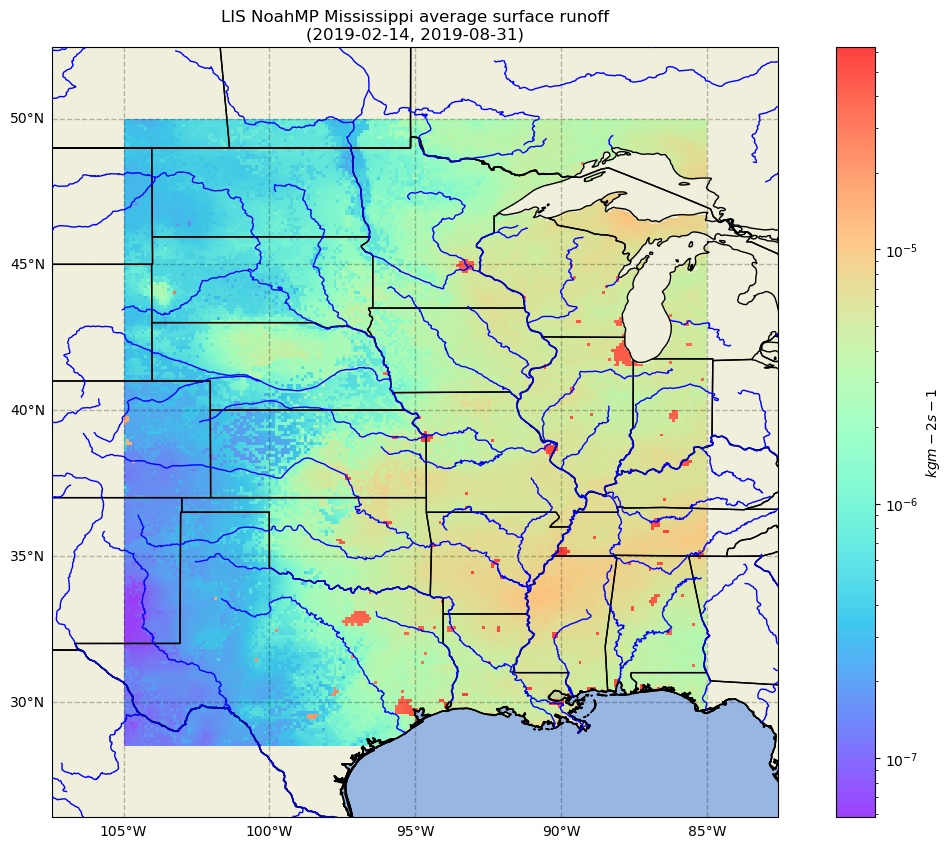

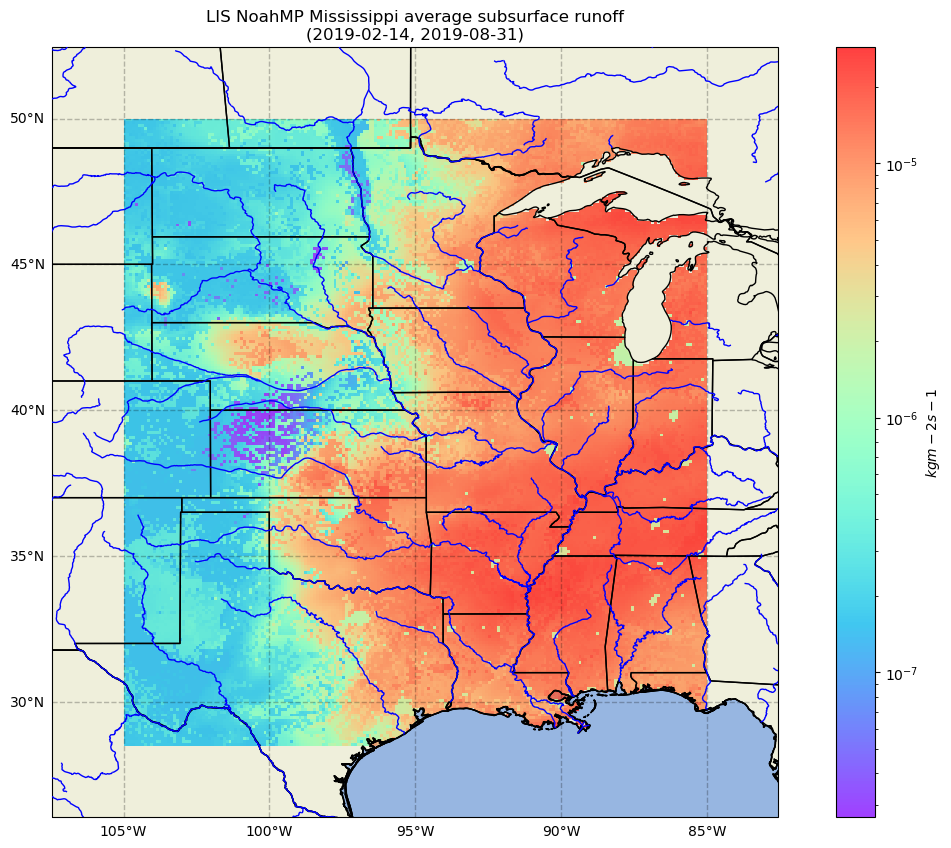

In [74]:
plotting.map_data(lis_noahmp_miss_tavg[0], 'LIS NoahMP Mississippi average surface runoff\n(2019-02-14, 2019-08-31)', cb_label='$kg m-2 s-1$', log_scale=True)
plotting.map_data(lis_noahmp_miss_tavg[1], 'LIS NoahMP Mississippi average subsurface runoff\n(2019-02-14, 2019-08-31)', cb_label='$kg m-2 s-1$', log_scale=True)

## LIS VIC Runoff and GPM Precipitation

In [75]:
miss_lis_vic_params = [(NEXUS_URL, ds, miss_bb, miss_start, miss_end) for ds in ['GLDAS_VIC10_3H_2_1_global_Qs_acc', 'GLDAS_VIC10_3H_2_1_global_Qsb_acc']]

In [76]:
lis_vic_miss_ts = [ideas_processing.spatial_timeseries(*miss_param) for miss_param in miss_lis_vic_params]

url
 https://ideas-digitaltwin.jpl.nasa.gov/nexus/timeSeriesSpark?ds=GLDAS_VIC10_3H_2_1_global_Qs_acc&minLon=-94.5&minLat=28&maxLon=-87&maxLat=37.5&startTime=2019-02-14T00:00:00Z&endTime=2019-08-31T00:00:00Z&lowPassFilter=False

Waiting for response from IDEAS...took 7.423615999985486 seconds
url
 https://ideas-digitaltwin.jpl.nasa.gov/nexus/timeSeriesSpark?ds=GLDAS_VIC10_3H_2_1_global_Qsb_acc&minLon=-94.5&minLat=28&maxLon=-87&maxLat=37.5&startTime=2019-02-14T00:00:00Z&endTime=2019-08-31T00:00:00Z&lowPassFilter=False

Waiting for response from IDEAS...took 7.08421741600614 seconds


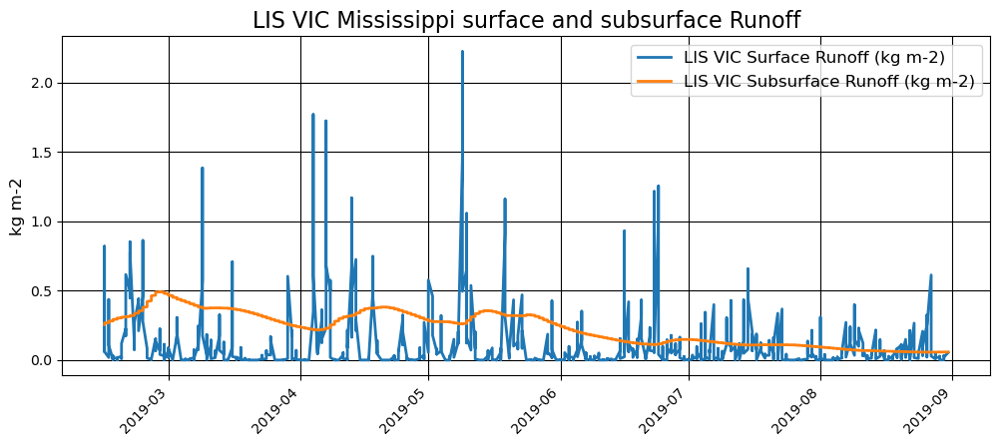

In [77]:
plotting.timeseries_plot([(lis_vic_miss_ts[0]['mean'], 'LIS VIC Surface Runoff (kg m-2)', 'tab:blue'), (lis_vic_miss_ts[1]['mean'], 'LIS VIC Subsurface Runoff (kg m-2)', 'tab:orange')], '', 'kg m-2', 'LIS VIC Mississippi surface and subsurface Runoff')

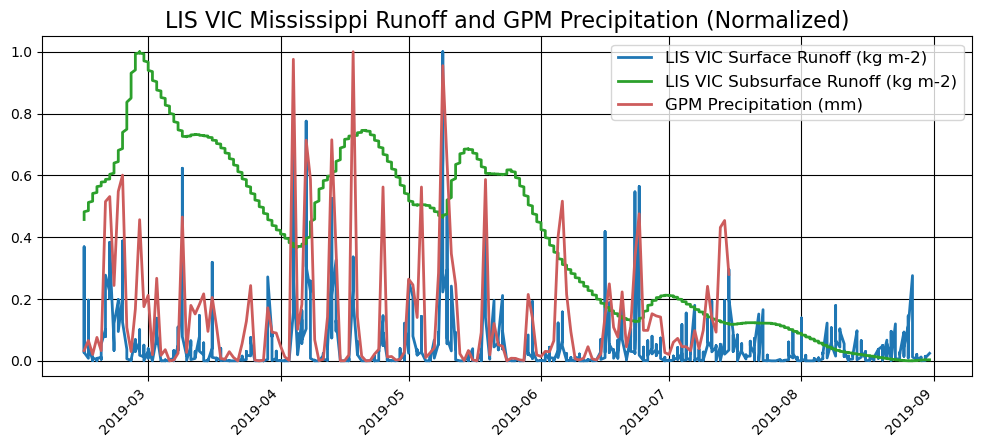

In [78]:
plotting.timeseries_plot([(lis_vic_miss_ts[0]['mean'], 'LIS VIC Surface Runoff (kg m-2)', 'tab:blue'), (lis_vic_miss_ts[1]['mean'], 'LIS VIC Subsurface Runoff (kg m-2)', 'tab:green'), (gpm_miss_ts['mean'][:152], 'GPM Precipitation (mm)', 'indianred')], '', '', 'LIS VIC Mississippi Runoff and GPM Precipitation (Normalized)', norm=True)

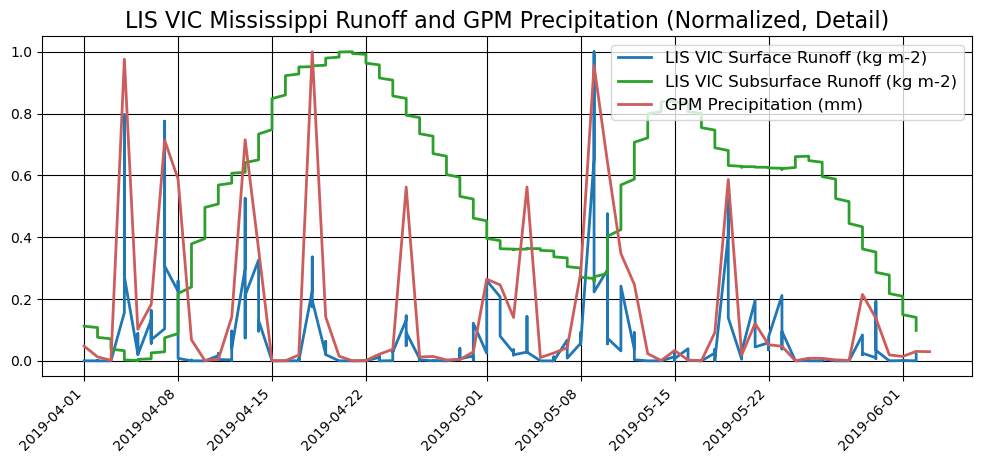

In [79]:
plotting.timeseries_plot([(lis_vic_miss_ts[0]['mean'][375:870], 'LIS VIC Surface Runoff (kg m-2)', 'tab:blue'), (lis_vic_miss_ts[1]['mean'][375:870], 'LIS VIC Subsurface Runoff (kg m-2)', 'tab:green'), (gpm_miss_ts['mean'][46:110], 'GPM Precipitation (mm)', 'indianred')], '', '', 'LIS VIC Mississippi Runoff and GPM Precipitation (Normalized, Detail)', norm=True)

### LIS VIC Full Basin

In [80]:
miss_basin_bb       = {'min_lon': -105, 'max_lon': -85, 'min_lat': 27.5, 'max_lat': 54}
miss_start    = datetime(2019, 2, 14)
miss_end     = datetime(2019, 8, 31)
miss_lis_vic_basin_params = [(NEXUS_URL, ds, miss_basin_bb, miss_start, miss_end) for ds in ['GLDAS_VIC10_3H_2_1_global_Qs_acc', 'GLDAS_VIC10_3H_2_1_global_Qsb_acc']]

In [81]:
lis_vic_miss_tavg = [ideas_processing.temporal_mean(*miss_param) for miss_param in miss_lis_vic_basin_params]

url
 https://ideas-digitaltwin.jpl.nasa.gov/nexus/timeAvgMapSpark?ds=GLDAS_VIC10_3H_2_1_global_Qs_acc&b=-105,27.5,-85,54&startTime=2019-02-14T00:00:00Z&endTime=2019-08-31T00:00:00Z

Waiting for response from IDEAS... took 9.193351166992215 seconds
url
 https://ideas-digitaltwin.jpl.nasa.gov/nexus/timeAvgMapSpark?ds=GLDAS_VIC10_3H_2_1_global_Qsb_acc&b=-105,27.5,-85,54&startTime=2019-02-14T00:00:00Z&endTime=2019-08-31T00:00:00Z

Waiting for response from IDEAS... took 5.014969084004406 seconds


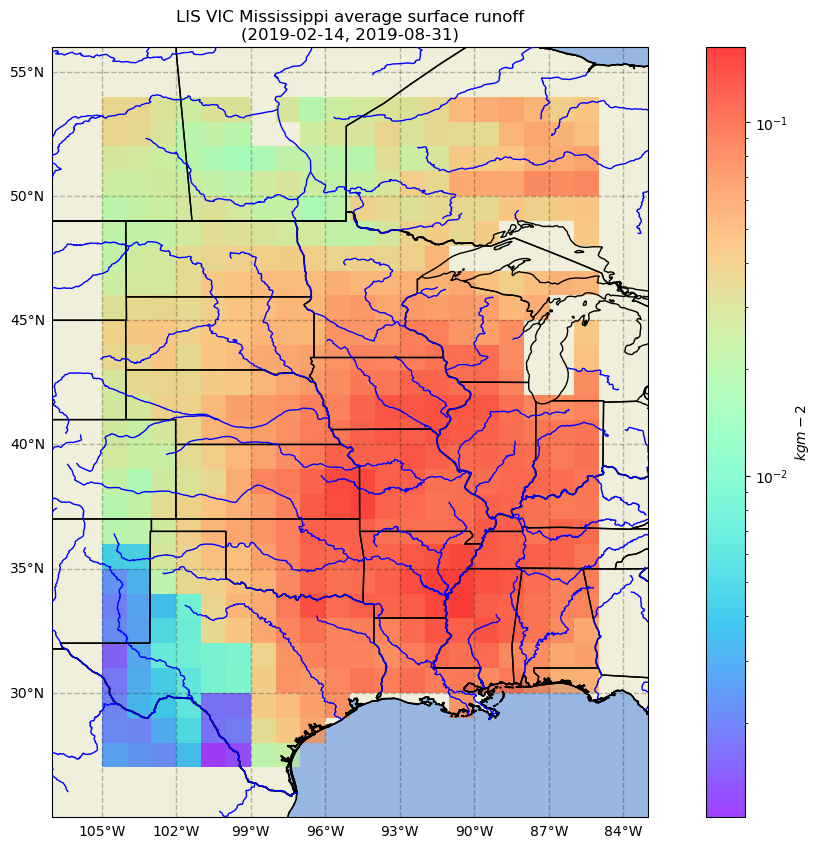

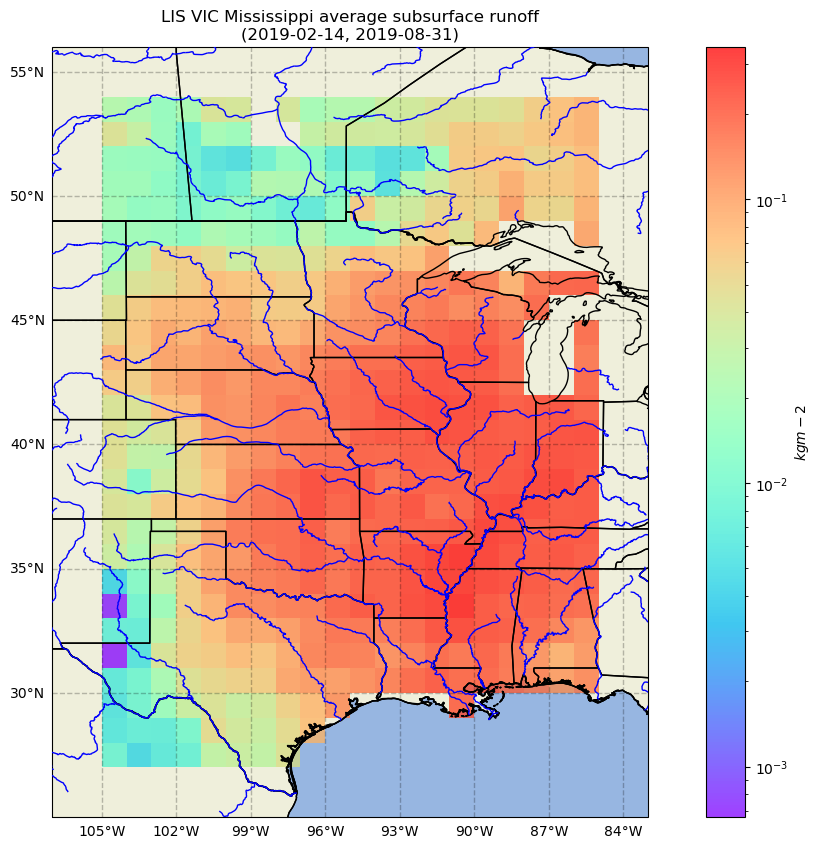

In [82]:
plotting.map_data(lis_vic_miss_tavg[0], 'LIS VIC Mississippi average surface runoff\n(2019-02-14, 2019-08-31)', cb_label='$kg m-2$', log_scale=True)
plotting.map_data(lis_vic_miss_tavg[1], 'LIS VIC Mississippi average subsurface runoff\n(2019-02-14, 2019-08-31)', cb_label='$kg m-2$', log_scale=True)

## Mississippi RAPID
The Routing Application for Parallel computatIon of Discharge (RAPID) is a river routing model. Given surface and groundwater inflow to rivers, this model can compute the flow and volume of water everywhere in river networks made out of many thousands of reaches. 

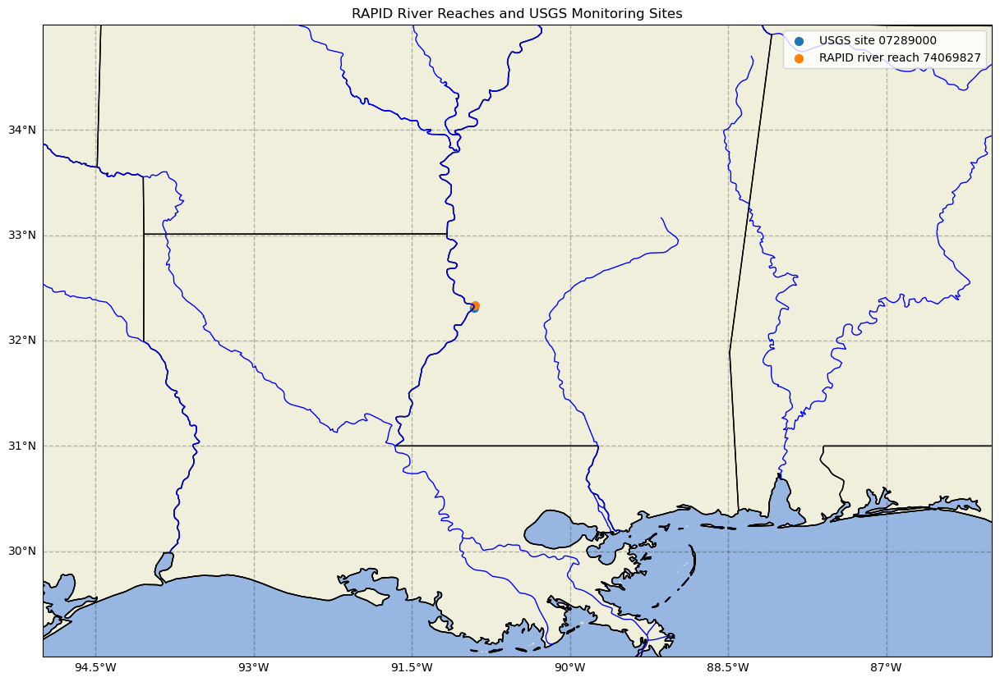

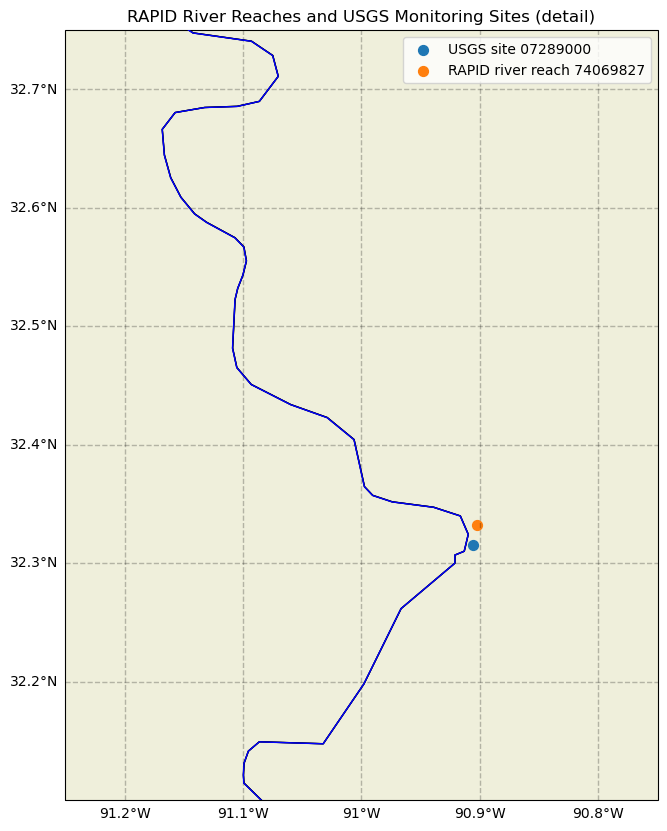

In [83]:
points = [
    (32.315, -90.905833, 'USGS site 07289000'),
    (32.3325, -90.9025, 'RAPID river reach 74069827')
]
plotting.map_points(points, 'miss', 'RAPID River Reaches and USGS Monitoring Sites')
plotting.map_points(points, 'miss', 'RAPID River Reaches and USGS Monitoring Sites (detail)', True)

In [84]:
usgs_params = (NEXUS_URL, 'USGS', 'IDEAS', '-91,32.2,-90.85,32.4', datetime(2018, 11, 1), datetime(2019,9,1))

In [85]:
miss_usgs_df = ideas_processing.insitu(*usgs_params)

https://ideas-digitaltwin.jpl.nasa.gov/insitu/1.0/query_data_doms_custom_pagination?startIndex=0&itemsPerPage=10000&provider=USGS&project=IDEAS&startTime=2018-11-01T00:00:00Z&endTime=2019-09-01T00:00:00Z&bbox=-91,32.2,-90.85,32.4
http://ideas-digitaltwin.jpl.nasa.gov/insitu/1.0/query_data_doms_custom_pagination?startIndex=0&itemsPerPage=10000&provider=USGS&project=IDEAS&startTime=2018-11-01T00:00:00Z&endTime=2019-09-01T00:00:00Z&bbox=-91,32.2,-90.85,32.4&markerTime=2019-09-01T00:00:00Z&markerPlatform=88af6628bc5bdd5f69fdcdb687d58989c760143395b166acf397ae81656f6cd9


In [86]:
miss_usgs_site_df = miss_usgs_df[miss_usgs_df['platform_id'] == '07289000']
try:
    miss_usgs_site_df['time'] = [datetime.strptime(t, '%Y-%m-%dT%H:%M:%SZ') for t in miss_usgs_site_df['time']]
except:
    pass

In [87]:
rapid_lis_noahmp_miss_params = (NEXUS_URL, 'RAPID_LIS_1x_Mississippi', 'IDEAS', '-91,32.2,-90.85,32.4', datetime(2018, 11, 1), datetime(2019,9,1))
rapid_vic_miss_params = (NEXUS_URL, 'RAPID_VIC_Mississippi', 'IDEAS', '-91,32.2,-90.85,32.4', datetime(2018, 11, 1), datetime(2019,9,1))
rapid_noah_miss_params = (NEXUS_URL, 'RAPID_NOAH_Mississippi', 'IDEAS', '-91,32.2,-90.85,32.4', datetime(2018, 11, 1), datetime(2019,9,1))
rapid_clsm_miss_params = (NEXUS_URL, 'RAPID_CLSM_Mississippi', 'IDEAS', '-91,32.2,-90.85,32.4', datetime(2018, 11, 1), datetime(2019,9,1))

In [88]:
rapid_lis_noahmp_miss_df = ideas_processing.insitu(*rapid_lis_noahmp_miss_params)
rapid_vic_miss_df = ideas_processing.insitu(*rapid_vic_miss_params)
rapid_noah_miss_df = ideas_processing.insitu(*rapid_noah_miss_params)
rapid_clsm_miss_df = ideas_processing.insitu(*rapid_clsm_miss_params)

https://ideas-digitaltwin.jpl.nasa.gov/insitu/1.0/query_data_doms_custom_pagination?startIndex=0&itemsPerPage=10000&provider=RAPID_LIS_1x_Mississippi&project=IDEAS&startTime=2018-11-01T00:00:00Z&endTime=2019-09-01T00:00:00Z&bbox=-91,32.2,-90.85,32.4
http://ideas-digitaltwin.jpl.nasa.gov/insitu/1.0/query_data_doms_custom_pagination?startIndex=0&itemsPerPage=10000&provider=RAPID_LIS_1x_Mississippi&project=IDEAS&startTime=2018-11-01T00:00:00Z&endTime=2019-09-01T00:00:00Z&bbox=-91,32.2,-90.85,32.4&markerTime=2019-08-30T00:00:00Z&markerPlatform=69eacb19e2e20abde60e61238488e14723a702a67514b29355bca87b1c16e894
https://ideas-digitaltwin.jpl.nasa.gov/insitu/1.0/query_data_doms_custom_pagination?startIndex=0&itemsPerPage=10000&provider=RAPID_VIC_Mississippi&project=IDEAS&startTime=2018-11-01T00:00:00Z&endTime=2019-09-01T00:00:00Z&bbox=-91,32.2,-90.85,32.4
http://ideas-digitaltwin.jpl.nasa.gov/insitu/1.0/query_data_doms_custom_pagination?startIndex=0&itemsPerPage=10000&provider=RAPID_VIC_Mississi

In [89]:
rapid_lis_noahmp_miss_site_df = rapid_lis_noahmp_miss_df[rapid_lis_noahmp_miss_df['platform_id'] == '74069827']
rapid_vic_miss_site_df = rapid_vic_miss_df[rapid_vic_miss_df['platform_id'] == '74069827']
rapid_noah_miss_site_df = rapid_noah_miss_df[rapid_noah_miss_df['platform_id'] == '74069827']
rapid_clsm_miss_site_df = rapid_clsm_miss_df[rapid_clsm_miss_df['platform_id'] == '74069827']

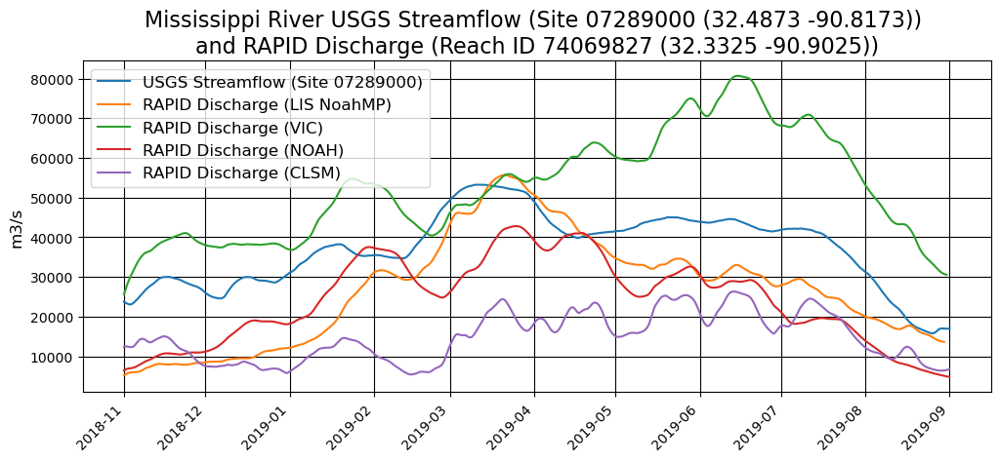

In [90]:
plotting.plot_insitu([(miss_usgs_site_df, 'Streamflow', 'USGS Streamflow (Site 07289000)'), 
                      (rapid_lis_noahmp_miss_site_df, 'Qout', 'RAPID Discharge (LIS NoahMP)'),
                      (rapid_vic_miss_site_df, 'Qout', 'RAPID Discharge (VIC)'),
                      (rapid_noah_miss_site_df, 'Qout', 'RAPID Discharge (NOAH)'),
                      (rapid_clsm_miss_site_df, 'Qout', 'RAPID Discharge (CLSM)')
                      ], 'Mississippi River USGS Streamflow (Site 07289000 (32.4873 -90.8173)) \nand RAPID Discharge (Reach ID 74069827 (32.3325 -90.9025))')

# LIS NoahMP Scenarios
Three scenarios with different amounts of MERRA2 precipitation as input to LIS NoahMP. For each scenario we can perform spatial and temporal analysis of the LIS NoahMP data, as well as the resulting RAPID discharge data.

In [91]:
miss_bb = {'min_lon': -94.5, 'max_lon': -87, 'min_lat': 28, 'max_lat': 37.5}
miss_start = datetime(2019, 2, 14)
miss_end = datetime(2019, 8, 31)

## Scenario 1, Nominal Precipitation

In [92]:
miss_lis_scenario_1_params = [(NEXUS_URL, ds, miss_bb, datetime(2019,2,25), datetime(2019,3,1)) for ds in ['LIS_miss_1x_Qs_tavg', 'LIS_miss_1x_Qsb_tavg']]
miss_lis_scenario_1_sub = [ideas_processing.data_subsetting(*miss_param) for miss_param in miss_lis_scenario_1_params]

url
 https://ideas-digitaltwin.jpl.nasa.gov/nexus/datainbounds?ds=LIS_miss_1x_Qs_tavg&b=-94.5,28,-87,37.5&startTime=2019-02-25T00:00:00Z&endTime=2019-03-01T00:00:00Z&lowPassFilter=False

Waiting for response from IDEAS...took 1.899870249995729 seconds
url
 https://ideas-digitaltwin.jpl.nasa.gov/nexus/datainbounds?ds=LIS_miss_1x_Qsb_tavg&b=-94.5,28,-87,37.5&startTime=2019-02-25T00:00:00Z&endTime=2019-03-01T00:00:00Z&lowPassFilter=False

Waiting for response from IDEAS...took 1.5244382499950007 seconds


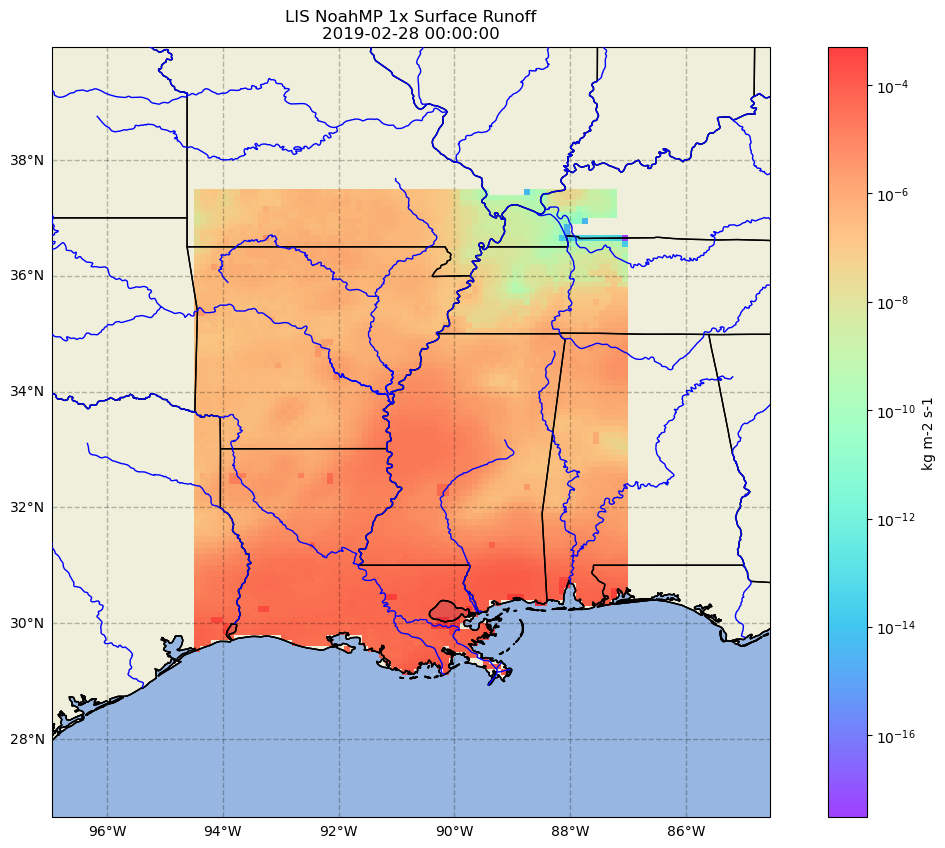

In [93]:
plotting.map_data(miss_lis_scenario_1_sub[0][3], f'LIS NoahMP 1x Surface Runoff\n{datetime.utcfromtimestamp(miss_lis_scenario_1_sub[0][3].time.values)}', cb_label="kg m-2 s-1", log_scale=True)

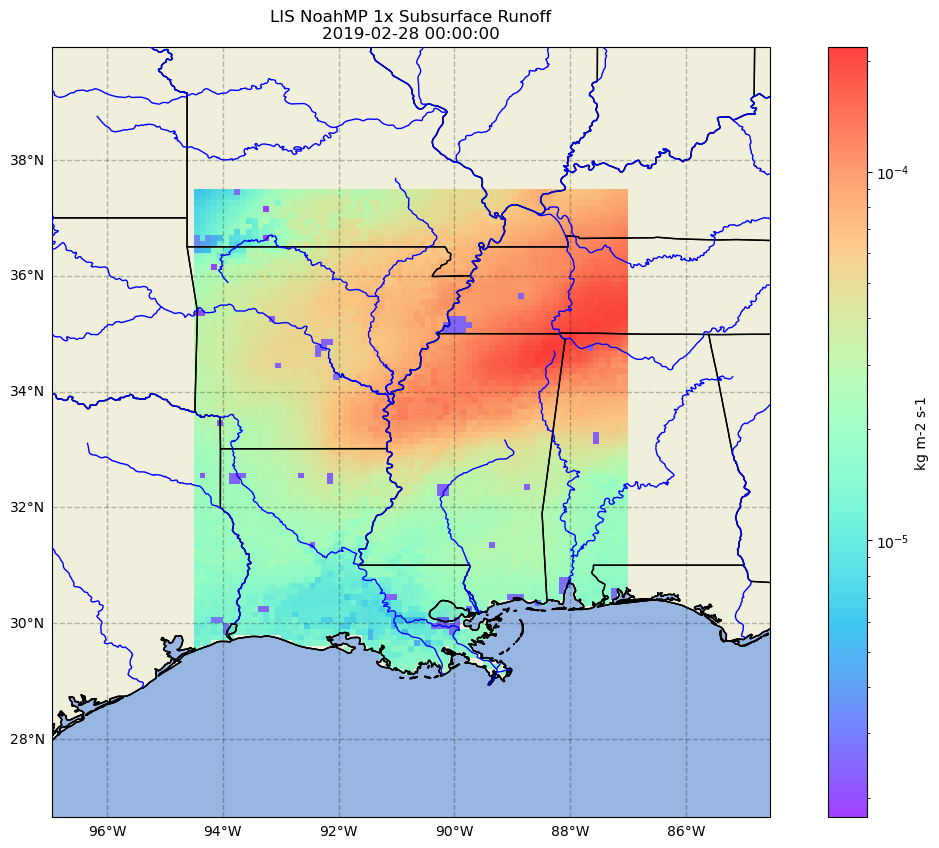

In [94]:
plotting.map_data(miss_lis_scenario_1_sub[1][3], f'LIS NoahMP 1x Subsurface Runoff\n{datetime.utcfromtimestamp(miss_lis_scenario_1_sub[1][3].time.values)}', cb_label="kg m-2 s-1", log_scale=True)

In [95]:
miss_lis_scenario_1_params = [(NEXUS_URL, ds, miss_bb, miss_start, miss_end) for ds in ['LIS_miss_1x_Qs_tavg', 'LIS_miss_1x_Qsb_tavg']]
miss_lis_scenario_1_ts = [ideas_processing.spatial_timeseries(*miss_param) for miss_param in miss_lis_scenario_1_params]

url
 https://ideas-digitaltwin.jpl.nasa.gov/nexus/timeSeriesSpark?ds=LIS_miss_1x_Qs_tavg&minLon=-94.5&minLat=28&maxLon=-87&maxLat=37.5&startTime=2019-02-14T00:00:00Z&endTime=2019-08-31T00:00:00Z&lowPassFilter=False

Waiting for response from IDEAS...took 3.195761290990049 seconds
url
 https://ideas-digitaltwin.jpl.nasa.gov/nexus/timeSeriesSpark?ds=LIS_miss_1x_Qsb_tavg&minLon=-94.5&minLat=28&maxLon=-87&maxLat=37.5&startTime=2019-02-14T00:00:00Z&endTime=2019-08-31T00:00:00Z&lowPassFilter=False

Waiting for response from IDEAS...took 1.7474297089793254 seconds


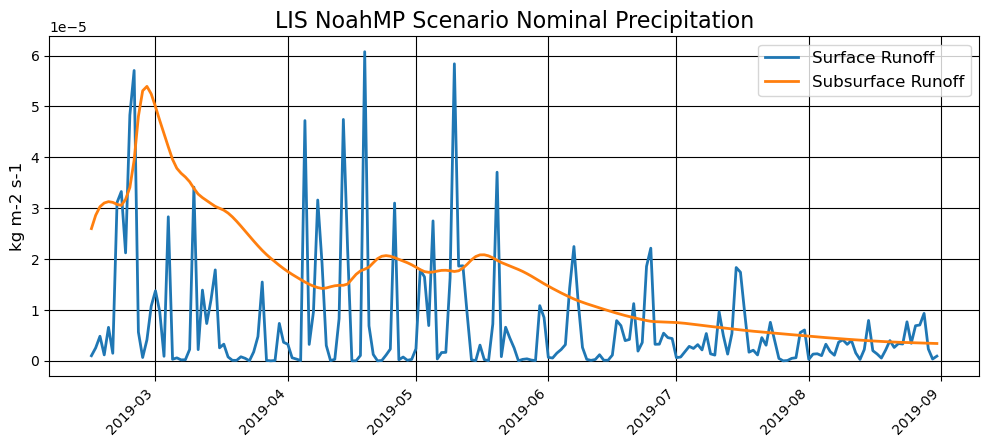

In [96]:
plotting.timeseries_plot([(miss_lis_scenario_1_ts[0]['mean'], 'Surface Runoff'), (miss_lis_scenario_1_ts[1]['mean'], 'Subsurface Runoff')], '', 'kg m-2 s-1', 'LIS NoahMP Scenario Nominal Precipitation')

https://ideas-digitaltwin.jpl.nasa.gov/insitu/1.0/query_data_doms_custom_pagination?startIndex=0&itemsPerPage=10000&provider=RAPID_LIS_1x_Mississippi&project=IDEAS&startTime=2018-11-01T00:00:00Z&endTime=2019-09-01T00:00:00Z&bbox=-91,32.2,-90.85,32.4
http://ideas-digitaltwin.jpl.nasa.gov/insitu/1.0/query_data_doms_custom_pagination?startIndex=0&itemsPerPage=10000&provider=RAPID_LIS_1x_Mississippi&project=IDEAS&startTime=2018-11-01T00:00:00Z&endTime=2019-09-01T00:00:00Z&bbox=-91,32.2,-90.85,32.4&markerTime=2019-08-30T00:00:00Z&markerPlatform=69eacb19e2e20abde60e61238488e14723a702a67514b29355bca87b1c16e894


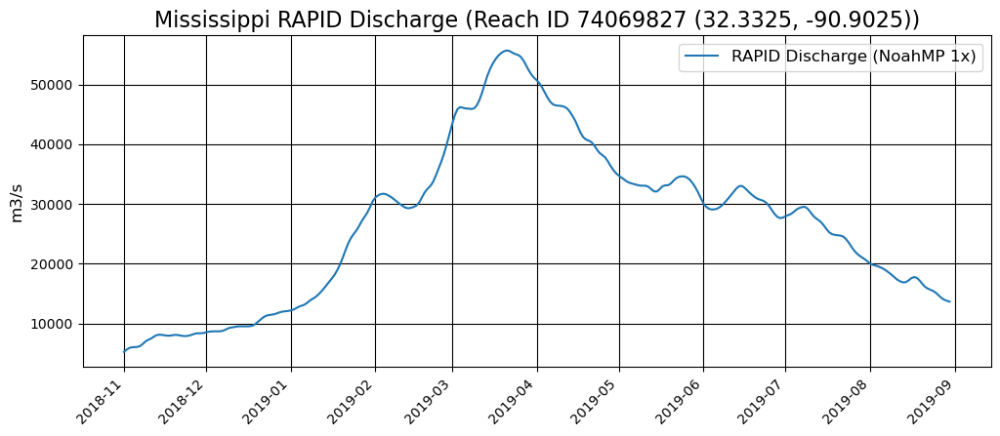

In [97]:
rapid_lis_noahmp_1x_miss_params = (NEXUS_URL, 'RAPID_LIS_1x_Mississippi', 'IDEAS', '-91,32.2,-90.85,32.4', datetime(2018, 11, 1), datetime(2019,9,1))
rapid_lis_noahmp_1x_miss_df = ideas_processing.insitu(*rapid_lis_noahmp_1x_miss_params)
rapid_lis_noahmp_1x_miss_site_df = rapid_lis_noahmp_1x_miss_df[rapid_lis_noahmp_1x_miss_df['platform_id'] == '74069827']
plotting.plot_insitu([
                      (rapid_lis_noahmp_1x_miss_site_df, 'Qout', 'RAPID Discharge (NoahMP 1x)'),
                      ], 'Mississippi RAPID Discharge (Reach ID 74069827 (32.3325, -90.9025))')

## Scenario 2, 2x Precipitation

In [98]:
miss_lis_scenario_2_params = [(NEXUS_URL, ds, miss_bb, datetime(2019,2,25), datetime(2019,3,1)) for ds in ['LIS_miss_merra2_2x_Qs_tavg', 'LIS_miss_merra2_2x_Qsb_tavg']]
miss_lis_scenario_2_sub = [ideas_processing.data_subsetting(*miss_param) for miss_param in miss_lis_scenario_2_params]

url
 https://ideas-digitaltwin.jpl.nasa.gov/nexus/datainbounds?ds=LIS_miss_merra2_2x_Qs_tavg&b=-94.5,28,-87,37.5&startTime=2019-02-25T00:00:00Z&endTime=2019-03-01T00:00:00Z&lowPassFilter=False

Waiting for response from IDEAS...took 2.227625250001438 seconds
url
 https://ideas-digitaltwin.jpl.nasa.gov/nexus/datainbounds?ds=LIS_miss_merra2_2x_Qsb_tavg&b=-94.5,28,-87,37.5&startTime=2019-02-25T00:00:00Z&endTime=2019-03-01T00:00:00Z&lowPassFilter=False

Waiting for response from IDEAS...took 1.562004874984268 seconds


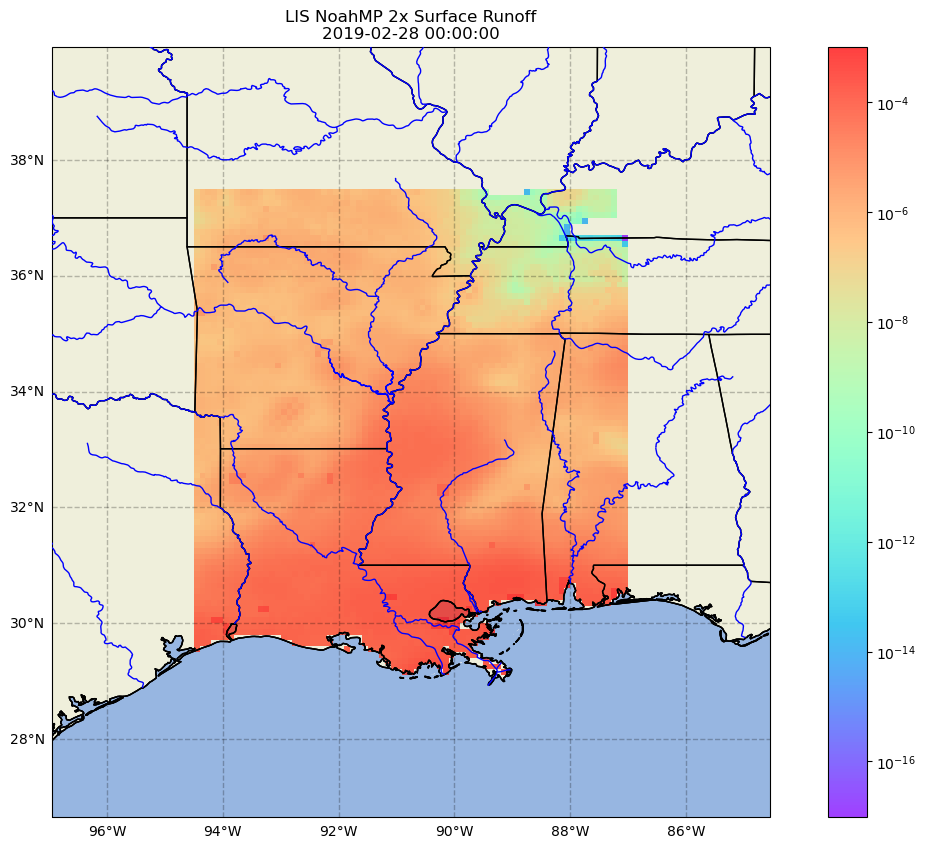

In [99]:
plotting.map_data(miss_lis_scenario_2_sub[0][3], f'LIS NoahMP 2x Surface Runoff\n{datetime.utcfromtimestamp(miss_lis_scenario_2_sub[0][3].time.values)}', log_scale=True)

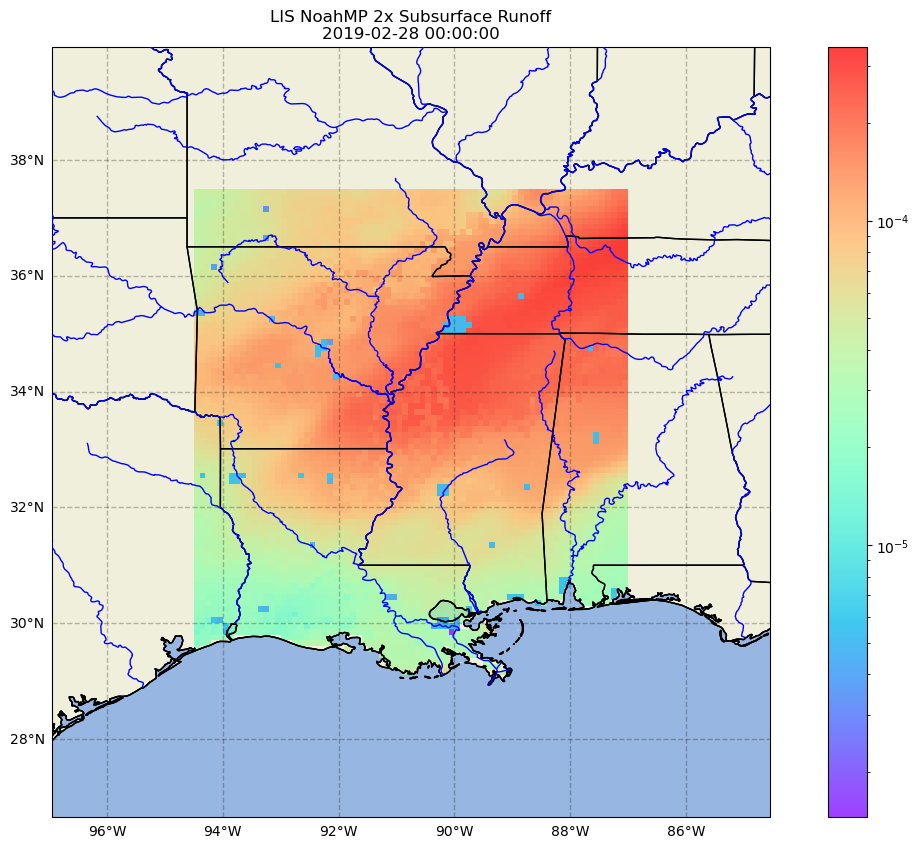

In [100]:
plotting.map_data(miss_lis_scenario_2_sub[1][3], f'LIS NoahMP 2x Subsurface Runoff\n{datetime.utcfromtimestamp(miss_lis_scenario_2_sub[1][3].time.values)}', log_scale=True)

In [101]:
miss_lis_scenario_2_params = [(NEXUS_URL, ds, miss_bb, miss_start, miss_end) for ds in ['LIS_miss_merra2_2x_Qs_tavg', 'LIS_miss_merra2_2x_Qsb_tavg']]
miss_lis_scenario_2_ts = [ideas_processing.spatial_timeseries(*miss_param) for miss_param in miss_lis_scenario_2_params]

url
 https://ideas-digitaltwin.jpl.nasa.gov/nexus/timeSeriesSpark?ds=LIS_miss_merra2_2x_Qs_tavg&minLon=-94.5&minLat=28&maxLon=-87&maxLat=37.5&startTime=2019-02-14T00:00:00Z&endTime=2019-08-31T00:00:00Z&lowPassFilter=False

Waiting for response from IDEAS...took 63.72815741697559 seconds
url
 https://ideas-digitaltwin.jpl.nasa.gov/nexus/timeSeriesSpark?ds=LIS_miss_merra2_2x_Qsb_tavg&minLon=-94.5&minLat=28&maxLon=-87&maxLat=37.5&startTime=2019-02-14T00:00:00Z&endTime=2019-08-31T00:00:00Z&lowPassFilter=False

Waiting for response from IDEAS...took 55.942692458978854 seconds


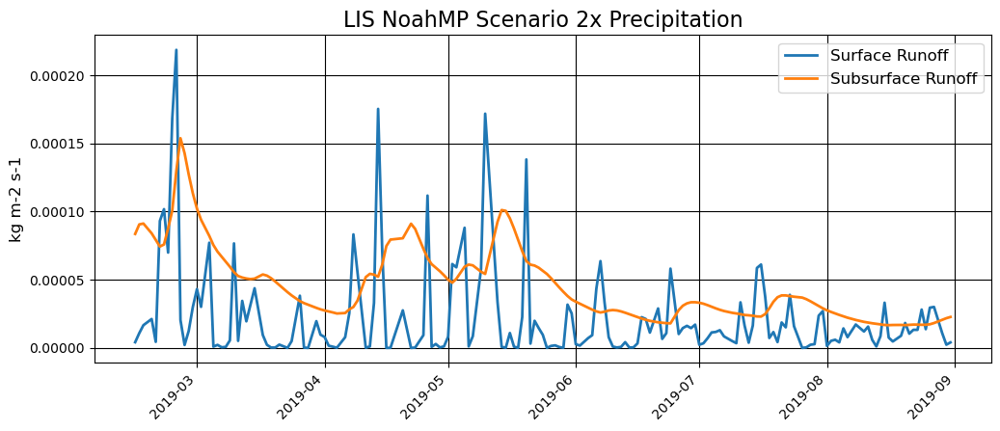

In [102]:
plotting.timeseries_plot([(miss_lis_scenario_2_ts[0]['mean'], 'Surface Runoff'), (miss_lis_scenario_2_ts[1]['mean'], 'Subsurface Runoff')], '', 'kg m-2 s-1', 'LIS NoahMP Scenario 2x Precipitation')

https://ideas-digitaltwin.jpl.nasa.gov/insitu/1.0/query_data_doms_custom_pagination?startIndex=0&itemsPerPage=10000&provider=RAPID_LIS_2x_Mississippi&project=IDEAS&startTime=2018-11-01T00:00:00Z&endTime=2019-09-01T00:00:00Z&bbox=-91,32.2,-90.85,32.4
http://ideas-digitaltwin.jpl.nasa.gov/insitu/1.0/query_data_doms_custom_pagination?startIndex=0&itemsPerPage=10000&provider=RAPID_LIS_2x_Mississippi&project=IDEAS&startTime=2018-11-01T00:00:00Z&endTime=2019-09-01T00:00:00Z&bbox=-91,32.2,-90.85,32.4&markerTime=2019-08-30T00:00:00Z&markerPlatform=3db977715c7431b6ebc9d8b9df6c16a81a36a303d9273c7fac933af7509e9d67


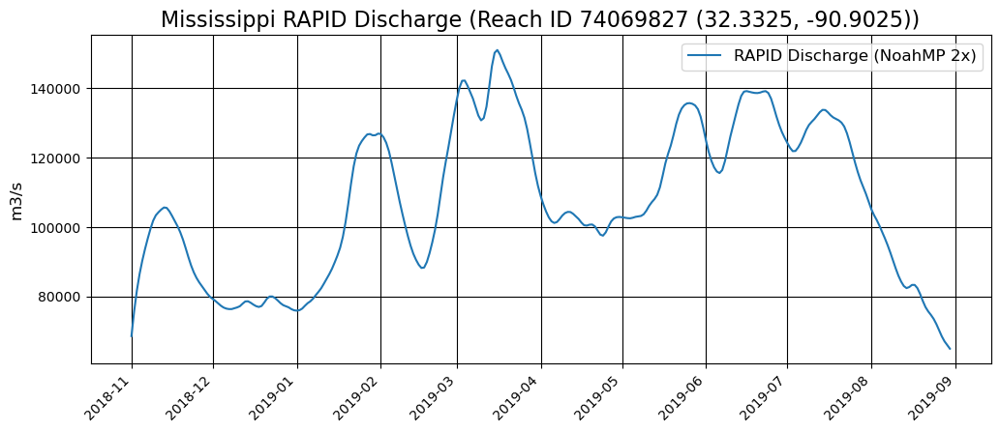

In [103]:
rapid_lis_noahmp_2x_miss_params = (NEXUS_URL, 'RAPID_LIS_2x_Mississippi', 'IDEAS', '-91,32.2,-90.85,32.4', datetime(2018, 11, 1), datetime(2019,9,1))
rapid_lis_noahmp_2x_miss_df = ideas_processing.insitu(*rapid_lis_noahmp_2x_miss_params)
rapid_lis_noahmp_2x_miss_site_df = rapid_lis_noahmp_2x_miss_df[rapid_lis_noahmp_2x_miss_df['platform_id'] == '74069827']
plotting.plot_insitu([
                      (rapid_lis_noahmp_2x_miss_site_df, 'Qout', 'RAPID Discharge (NoahMP 2x)'),
                      ], 'Mississippi RAPID Discharge (Reach ID 74069827 (32.3325, -90.9025))')

## Scenario 3, 3x Precipitation

In [104]:
miss_lis_scenario_3_params = [(NEXUS_URL, ds, miss_bb, datetime(2019,2,25), datetime(2019,3,1)) for ds in ['LIS_miss_merra2_3x_Qs_tavg', 'LIS_miss_merra2_3x_Qsb_tavg']]
miss_lis_scenario_3_sub = [ideas_processing.data_subsetting(*miss_param) for miss_param in miss_lis_scenario_3_params]

url
 https://ideas-digitaltwin.jpl.nasa.gov/nexus/datainbounds?ds=LIS_miss_merra2_3x_Qs_tavg&b=-94.5,28,-87,37.5&startTime=2019-02-25T00:00:00Z&endTime=2019-03-01T00:00:00Z&lowPassFilter=False

Waiting for response from IDEAS...took 1.6071121669956483 seconds
url
 https://ideas-digitaltwin.jpl.nasa.gov/nexus/datainbounds?ds=LIS_miss_merra2_3x_Qsb_tavg&b=-94.5,28,-87,37.5&startTime=2019-02-25T00:00:00Z&endTime=2019-03-01T00:00:00Z&lowPassFilter=False

Waiting for response from IDEAS...took 1.4048662090208381 seconds


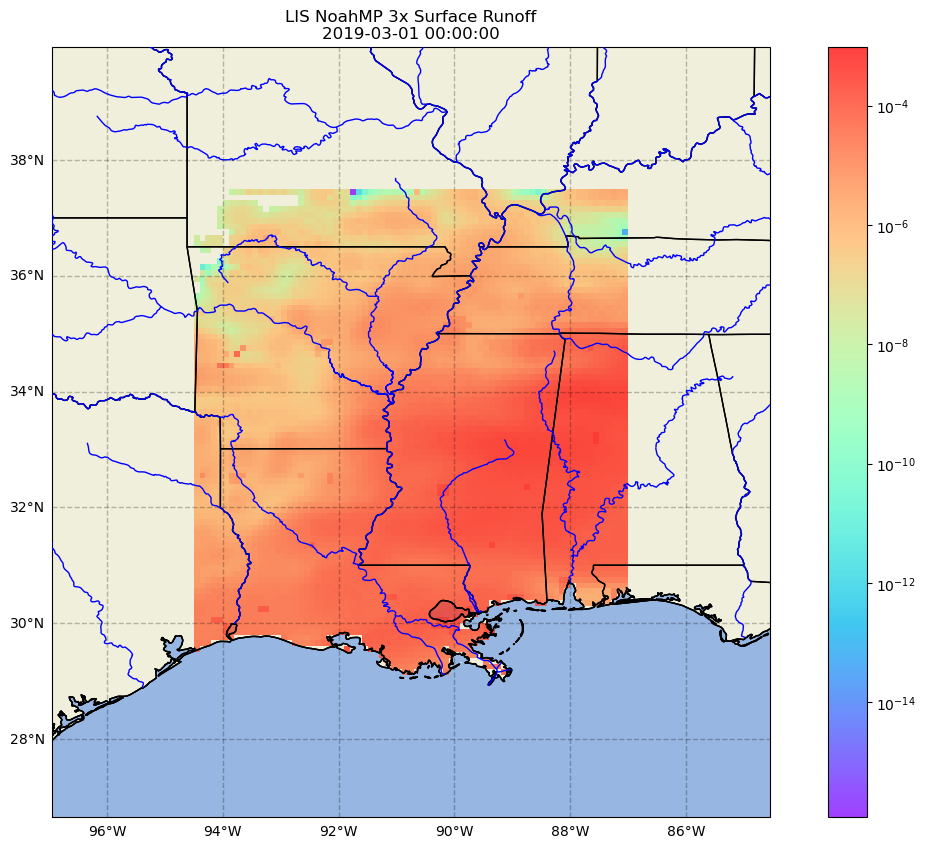

In [105]:
plotting.map_data(miss_lis_scenario_3_sub[0][3], f'LIS NoahMP 3x Surface Runoff\n{datetime.utcfromtimestamp(miss_lis_scenario_3_sub[0][3].time.values)}', log_scale=True)

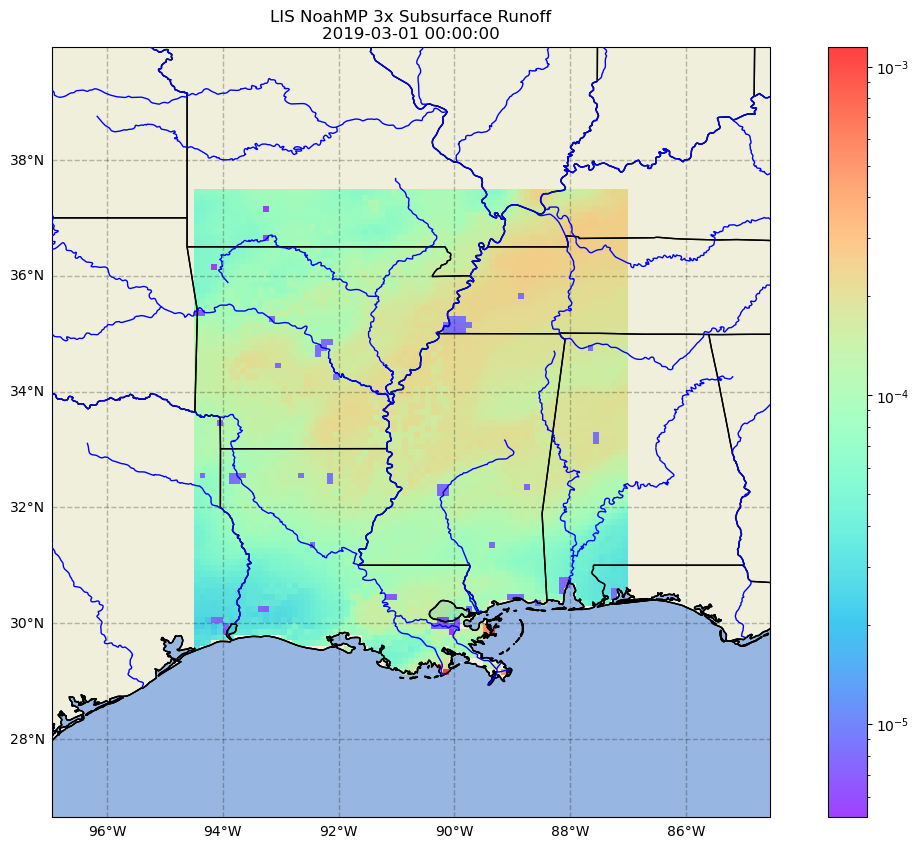

In [106]:
plotting.map_data(miss_lis_scenario_3_sub[1][3], f'LIS NoahMP 3x Subsurface Runoff\n{datetime.utcfromtimestamp(miss_lis_scenario_3_sub[1][3].time.values)}', log_scale=True)

In [107]:
miss_lis_scenario_3_params = [(NEXUS_URL, ds, miss_bb, miss_start, miss_end) for ds in ['LIS_miss_merra2_3x_Qs_tavg', 'LIS_miss_merra2_3x_Qsb_tavg']]
miss_lis_scenario_3_ts = [ideas_processing.spatial_timeseries(*miss_param) for miss_param in miss_lis_scenario_3_params]

url
 https://ideas-digitaltwin.jpl.nasa.gov/nexus/timeSeriesSpark?ds=LIS_miss_merra2_3x_Qs_tavg&minLon=-94.5&minLat=28&maxLon=-87&maxLat=37.5&startTime=2019-02-14T00:00:00Z&endTime=2019-08-31T00:00:00Z&lowPassFilter=False

Waiting for response from IDEAS...took 11.908674124977551 seconds
url
 https://ideas-digitaltwin.jpl.nasa.gov/nexus/timeSeriesSpark?ds=LIS_miss_merra2_3x_Qsb_tavg&minLon=-94.5&minLat=28&maxLon=-87&maxLat=37.5&startTime=2019-02-14T00:00:00Z&endTime=2019-08-31T00:00:00Z&lowPassFilter=False

Waiting for response from IDEAS...took 3.863211208023131 seconds


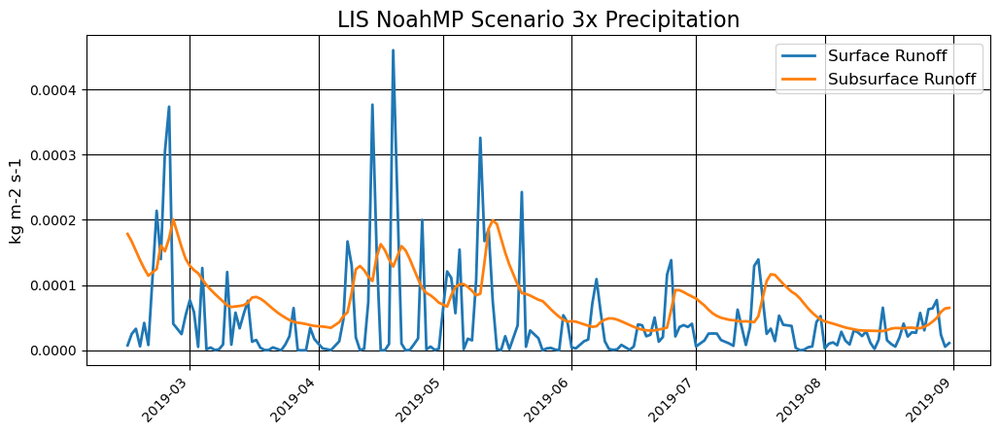

In [108]:
plotting.timeseries_plot([(miss_lis_scenario_3_ts[0]['mean'], 'Surface Runoff'), (miss_lis_scenario_3_ts[1]['mean'], 'Subsurface Runoff')], '', 'kg m-2 s-1', 'LIS NoahMP Scenario 3x Precipitation')

https://ideas-digitaltwin.jpl.nasa.gov/insitu/1.0/query_data_doms_custom_pagination?startIndex=0&itemsPerPage=10000&provider=RAPID_LIS_3x_Mississippi&project=IDEAS&startTime=2018-11-01T00:00:00Z&endTime=2019-09-01T00:00:00Z&bbox=-91,32.2,-90.85,32.4
http://ideas-digitaltwin.jpl.nasa.gov/insitu/1.0/query_data_doms_custom_pagination?startIndex=0&itemsPerPage=10000&provider=RAPID_LIS_3x_Mississippi&project=IDEAS&startTime=2018-11-01T00:00:00Z&endTime=2019-09-01T00:00:00Z&bbox=-91,32.2,-90.85,32.4&markerTime=2019-08-30T00:00:00Z&markerPlatform=3261b649892d417dc2dfeaf051141d9e74880ef68314470c79ec46181bbef41f


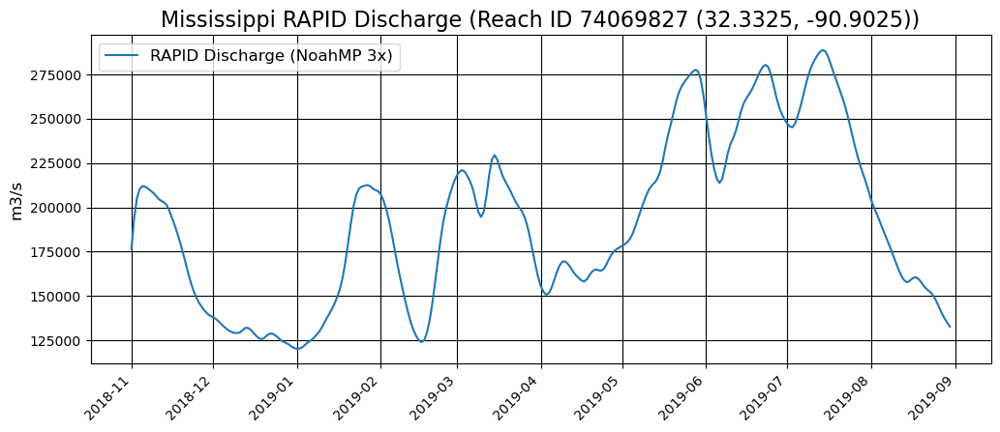

In [109]:
rapid_lis_noahmp_3x_miss_params = (NEXUS_URL, 'RAPID_LIS_3x_Mississippi', 'IDEAS', '-91,32.2,-90.85,32.4', datetime(2018, 11, 1), datetime(2019,9,1))
rapid_lis_noahmp_3x_miss_df = ideas_processing.insitu(*rapid_lis_noahmp_3x_miss_params)
rapid_lis_noahmp_3x_miss_site_df = rapid_lis_noahmp_3x_miss_df[rapid_lis_noahmp_3x_miss_df['platform_id'] == '74069827']
plotting.plot_insitu([
                      (rapid_lis_noahmp_3x_miss_site_df, 'Qout', 'RAPID Discharge (NoahMP 3x)'),
                      ], 'Mississippi RAPID Discharge (Reach ID 74069827 (32.3325, -90.9025))')

# Flooding in Garonne

In [110]:
gar_bb = {'min_lon': -0.5, 'max_lon': 0.5, 'min_lat': 44.25, 'max_lat': 44.75}
gar_start    = datetime(2021, 1, 1)
gar_end     = datetime(2021, 3, 1)
gar_lis_noahmp_params = [(NEXUS_URL, ds, gar_bb, gar_start, gar_end) for ds in ['LIS_gar_1x_Qs_tavg', 'LIS_gar_1x_Qsb_tavg']]

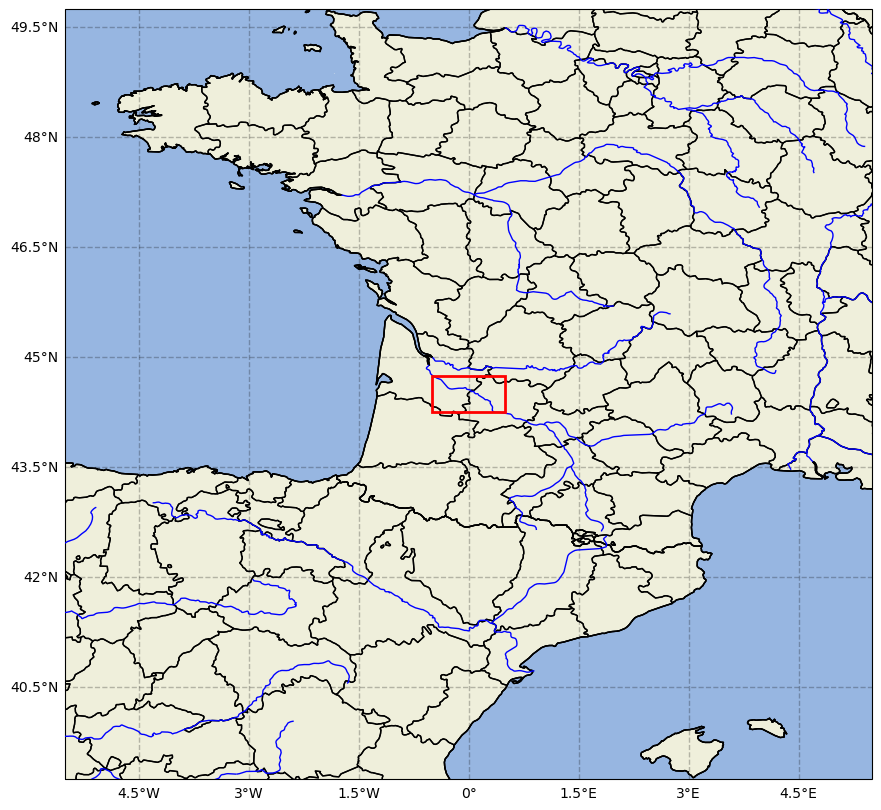

In [111]:
plotting.map_box(gar_bb, 5)

In [112]:
gpm_gar_ts = ideas_processing.spatial_timeseries(NEXUS_URL, 'GPM_3IMERGDL_precipitationCal', gar_bb, gar_start, gar_end)

url
 https://ideas-digitaltwin.jpl.nasa.gov/nexus/timeSeriesSpark?ds=GPM_3IMERGDL_precipitationCal&minLon=-0.5&minLat=44.25&maxLon=0.5&maxLat=44.75&startTime=2021-01-01T00:00:00Z&endTime=2021-03-01T00:00:00Z&lowPassFilter=False

Waiting for response from IDEAS...took 10.387539334013127 seconds


## LIS NoahMP Runoff and GPM Precipitation

In [113]:
gar_lis_noahmp_ts = [ideas_processing.spatial_timeseries(*param) for param in gar_lis_noahmp_params]

url
 https://ideas-digitaltwin.jpl.nasa.gov/nexus/timeSeriesSpark?ds=LIS_gar_1x_Qs_tavg&minLon=-0.5&minLat=44.25&maxLon=0.5&maxLat=44.75&startTime=2021-01-01T00:00:00Z&endTime=2021-03-01T00:00:00Z&lowPassFilter=False

Waiting for response from IDEAS...took 2.0016095000028145 seconds
url
 https://ideas-digitaltwin.jpl.nasa.gov/nexus/timeSeriesSpark?ds=LIS_gar_1x_Qsb_tavg&minLon=-0.5&minLat=44.25&maxLon=0.5&maxLat=44.75&startTime=2021-01-01T00:00:00Z&endTime=2021-03-01T00:00:00Z&lowPassFilter=False

Waiting for response from IDEAS...took 60.53314083398436 seconds


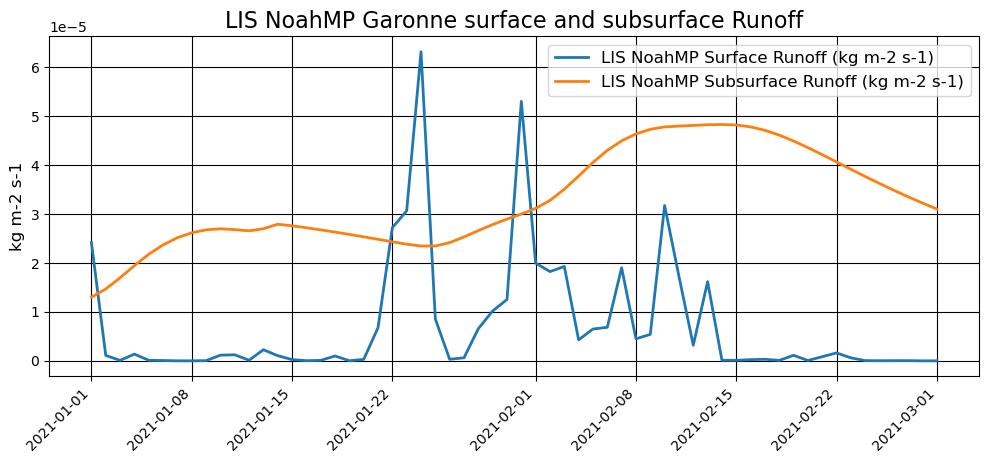

In [114]:
plotting.timeseries_plot([(gar_lis_noahmp_ts[0]['mean'], 'LIS NoahMP Surface Runoff (kg m-2 s-1)', 'tab:blue'), (gar_lis_noahmp_ts[1]['mean'], 'LIS NoahMP Subsurface Runoff (kg m-2 s-1)', 'tab:orange')], '', 'kg m-2 s-1', 'LIS NoahMP Garonne surface and subsurface Runoff')

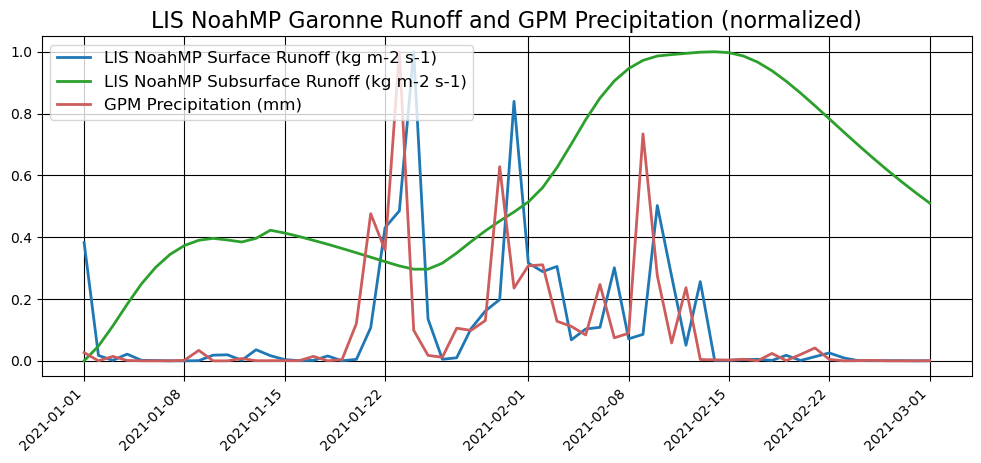

In [115]:
plotting.timeseries_plot([(gar_lis_noahmp_ts[0]['mean'], 'LIS NoahMP Surface Runoff (kg m-2 s-1)', 'tab:blue'), (gar_lis_noahmp_ts[1]['mean'], 'LIS NoahMP Subsurface Runoff (kg m-2 s-1)', 'tab:green'), (gpm_gar_ts['mean'], 'GPM Precipitation (mm)', 'indianred')], '', '', 'LIS NoahMP Garonne Runoff and GPM Precipitation (normalized)', norm=True)

### LIS NoahMP Full Basin

In [116]:
gar_basin_bb = {'min_lon': -1, 'max_lon': 4.9, 'min_lat': 40, 'max_lat': 46}
gar_start    = datetime(2021, 1, 1)
gar_end     = datetime(2021, 3, 1)
gar_lis_noahmp_basin_params = [(NEXUS_URL, ds, gar_basin_bb, gar_start, gar_end) for ds in ['LIS_gar_1x_Qs_tavg', 'LIS_gar_1x_Qsb_tavg']]

In [117]:
lis_noahmp_gar_tavg = [ideas_processing.temporal_mean(*gar_param) for gar_param in gar_lis_noahmp_basin_params]

url
 https://ideas-digitaltwin.jpl.nasa.gov/nexus/timeAvgMapSpark?ds=LIS_gar_1x_Qs_tavg&b=-1,40,4.9,46&startTime=2021-01-01T00:00:00Z&endTime=2021-03-01T00:00:00Z

Waiting for response from IDEAS... took 62.71922704199096 seconds
url
 https://ideas-digitaltwin.jpl.nasa.gov/nexus/timeAvgMapSpark?ds=LIS_gar_1x_Qsb_tavg&b=-1,40,4.9,46&startTime=2021-01-01T00:00:00Z&endTime=2021-03-01T00:00:00Z

Waiting for response from IDEAS... took 15.726468915992882 seconds


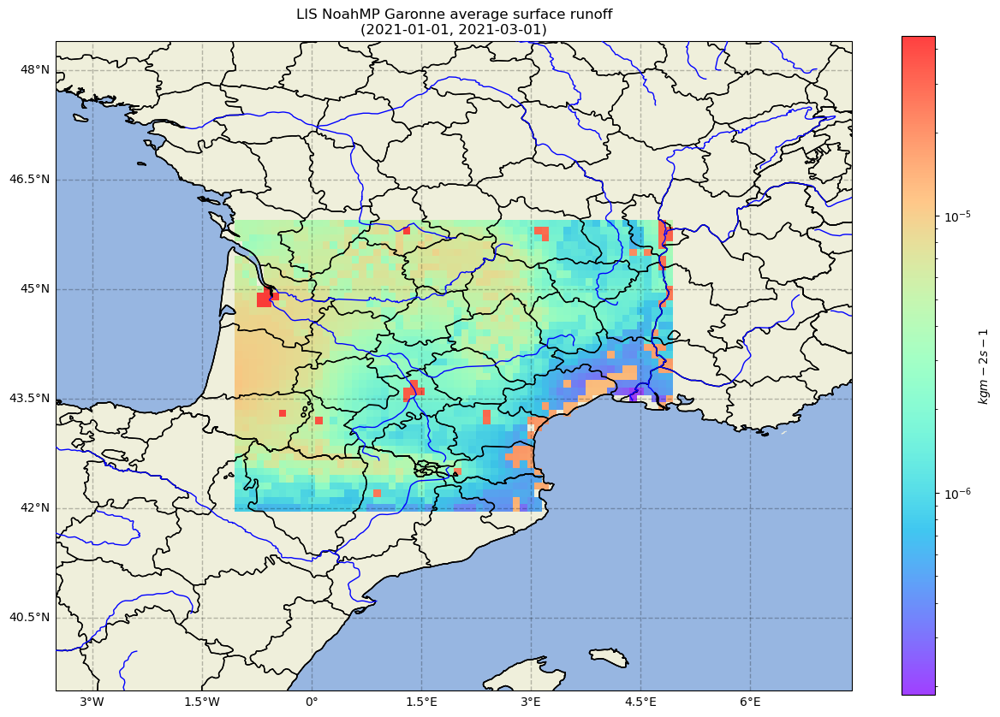

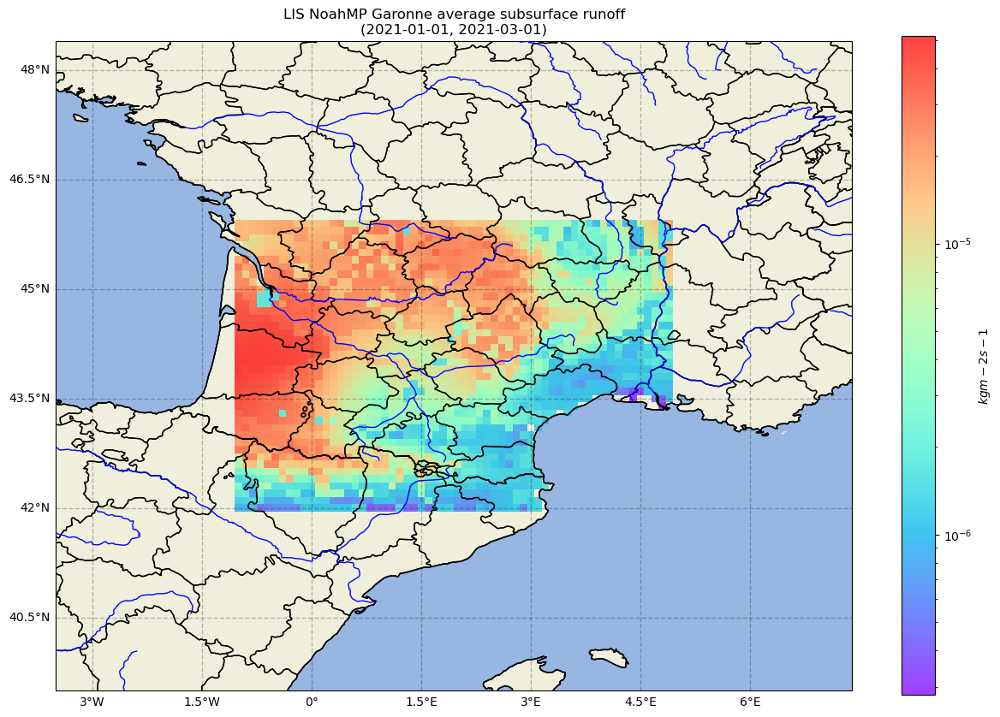

In [118]:
plotting.map_data(lis_noahmp_gar_tavg[0], 'LIS NoahMP Garonne average surface runoff\n(2021-01-01, 2021-03-01)', cb_label='$kg m-2 s-1$', log_scale=True)
plotting.map_data(lis_noahmp_gar_tavg[1], 'LIS NoahMP Garonne average subsurface runoff\n(2021-01-01, 2021-03-01)', cb_label='$kg m-2 s-1$', log_scale=True)

## LIS VIC Runoff and GPM Precipitation

In [119]:
gar_lis_vic_params = [(NEXUS_URL, ds, gar_bb, gar_start, gar_end) for ds in ['GLDAS_VIC10_3H_2_1_global_Qs_acc', 'GLDAS_VIC10_3H_2_1_global_Qsb_acc']]

In [120]:
gar_lis_vic_ts = [ideas_processing.spatial_timeseries(*param) for param in gar_lis_vic_params]

url
 https://ideas-digitaltwin.jpl.nasa.gov/nexus/timeSeriesSpark?ds=GLDAS_VIC10_3H_2_1_global_Qs_acc&minLon=-0.5&minLat=44.25&maxLon=0.5&maxLat=44.75&startTime=2021-01-01T00:00:00Z&endTime=2021-03-01T00:00:00Z&lowPassFilter=False

Waiting for response from IDEAS...took 2.4336150419840124 seconds
url
 https://ideas-digitaltwin.jpl.nasa.gov/nexus/timeSeriesSpark?ds=GLDAS_VIC10_3H_2_1_global_Qsb_acc&minLon=-0.5&minLat=44.25&maxLon=0.5&maxLat=44.75&startTime=2021-01-01T00:00:00Z&endTime=2021-03-01T00:00:00Z&lowPassFilter=False

Waiting for response from IDEAS...took 1.1951980000012554 seconds


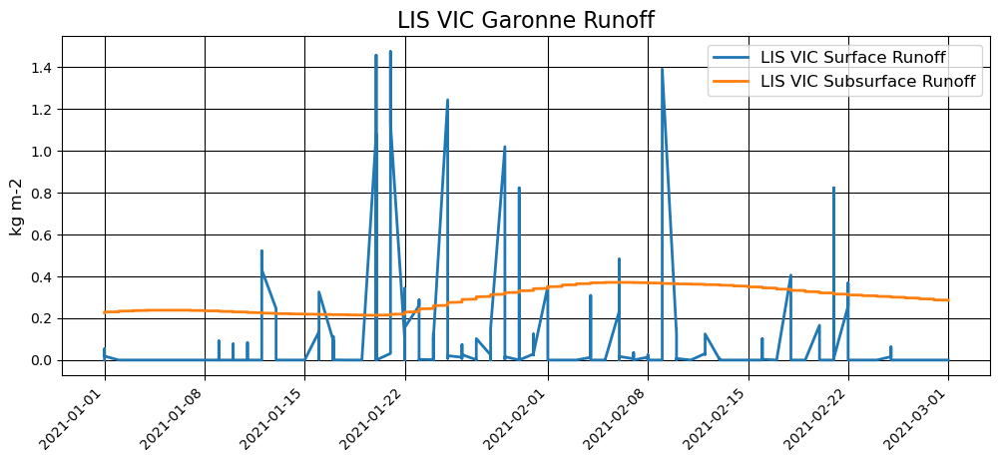

In [121]:
plotting.timeseries_plot([(gar_lis_vic_ts[0]['mean'], 'LIS VIC Surface Runoff', 'tab:blue'), (gar_lis_vic_ts[1]['mean'], 'LIS VIC Subsurface Runoff', 'tab:orange')], '', 'kg m-2', 'LIS VIC Garonne Runoff')

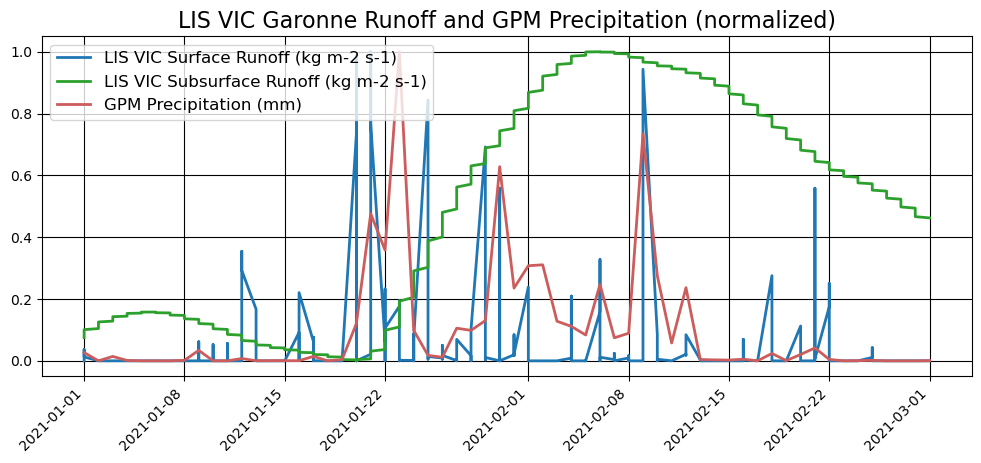

In [122]:
plotting.timeseries_plot([(gar_lis_vic_ts[0]['mean'], 'LIS VIC Surface Runoff (kg m-2 s-1)', 'tab:blue'), (gar_lis_vic_ts[1]['mean'], 'LIS VIC Subsurface Runoff (kg m-2 s-1)', 'tab:green'), (gpm_gar_ts['mean'], 'GPM Precipitation (mm)', 'indianred')], '', '', 'LIS VIC Garonne Runoff and GPM Precipitation (normalized)', norm=True)

### LIS VIC Full Basin

In [123]:
gar_lis_vic_basin_params = [(NEXUS_URL, ds, gar_basin_bb, gar_start, gar_end) for ds in ['GLDAS_VIC10_3H_2_1_global_Qs_acc', 'GLDAS_VIC10_3H_2_1_global_Qsb_acc']]

In [124]:
lis_vic_gar_tavg = [ideas_processing.temporal_mean(*gar_param) for gar_param in gar_lis_vic_basin_params]

url
 https://ideas-digitaltwin.jpl.nasa.gov/nexus/timeAvgMapSpark?ds=GLDAS_VIC10_3H_2_1_global_Qs_acc&b=-1,40,4.9,46&startTime=2021-01-01T00:00:00Z&endTime=2021-03-01T00:00:00Z

Waiting for response from IDEAS... took 4.477251875010552 seconds
url
 https://ideas-digitaltwin.jpl.nasa.gov/nexus/timeAvgMapSpark?ds=GLDAS_VIC10_3H_2_1_global_Qsb_acc&b=-1,40,4.9,46&startTime=2021-01-01T00:00:00Z&endTime=2021-03-01T00:00:00Z

Waiting for response from IDEAS... took 9.527590707992204 seconds


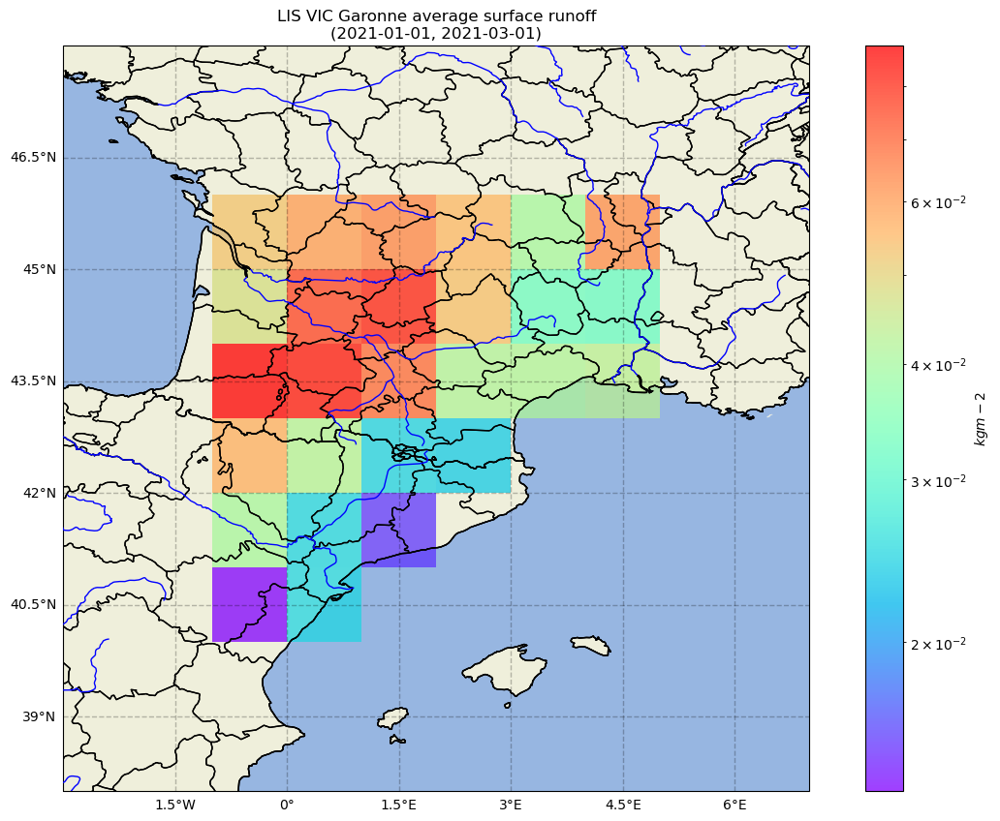

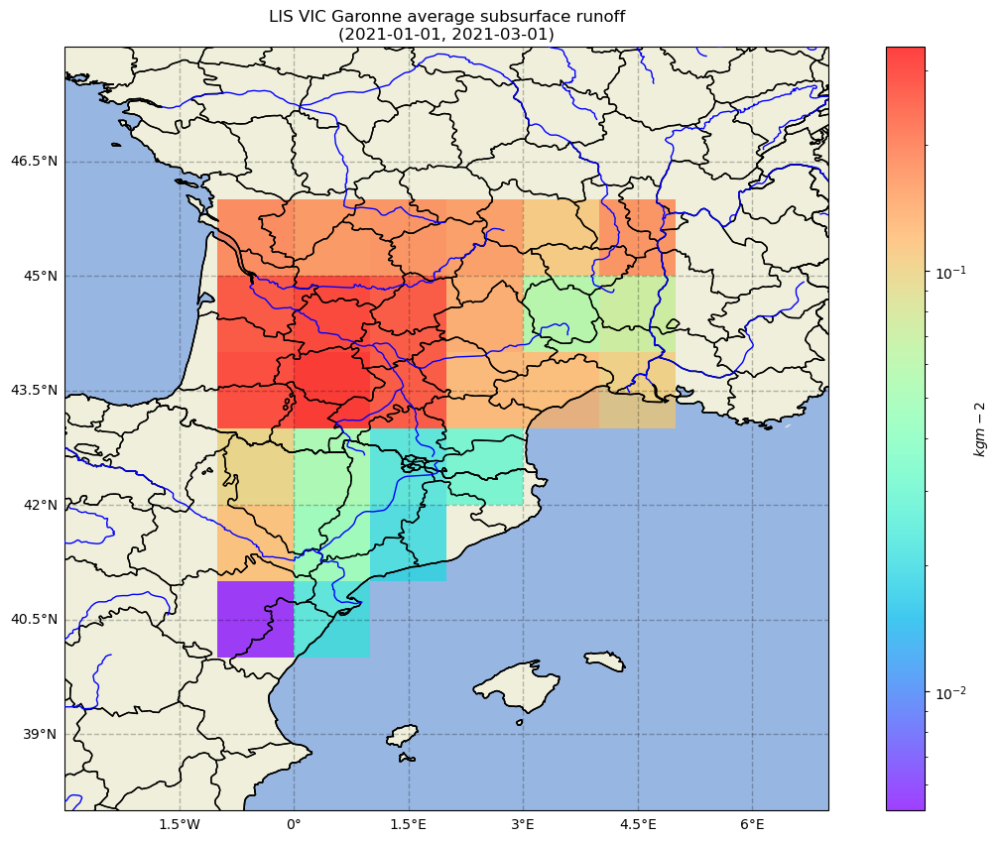

In [125]:
plotting.map_data(lis_vic_gar_tavg[0], 'LIS VIC Garonne average surface runoff\n(2021-01-01, 2021-03-01)', cb_label='$kg m-2$', log_scale=True)
plotting.map_data(lis_vic_gar_tavg[1], 'LIS VIC Garonne average subsurface runoff\n(2021-01-01, 2021-03-01)', cb_label='$kg m-2$', log_scale=True)

## LIS NOAH Runoff and GPM Precipitation

In [126]:
gar_lis_noah_params = [(NEXUS_URL, ds, gar_bb, gar_start, gar_end) for ds in ['GLDAS_NOAH10_3H_2_1_global_Qs_acc', 'GLDAS_NOAH10_3H_2_1_global_Qsb_acc']]

In [127]:
gar_lis_noah_ts = [ideas_processing.spatial_timeseries(*param) for param in gar_lis_noah_params]

url
 https://ideas-digitaltwin.jpl.nasa.gov/nexus/timeSeriesSpark?ds=GLDAS_NOAH10_3H_2_1_global_Qs_acc&minLon=-0.5&minLat=44.25&maxLon=0.5&maxLat=44.75&startTime=2021-01-01T00:00:00Z&endTime=2021-03-01T00:00:00Z&lowPassFilter=False

Waiting for response from IDEAS...took 2.439914584014332 seconds
url
 https://ideas-digitaltwin.jpl.nasa.gov/nexus/timeSeriesSpark?ds=GLDAS_NOAH10_3H_2_1_global_Qsb_acc&minLon=-0.5&minLat=44.25&maxLon=0.5&maxLat=44.75&startTime=2021-01-01T00:00:00Z&endTime=2021-03-01T00:00:00Z&lowPassFilter=False

Waiting for response from IDEAS...took 1.4265654580085538 seconds


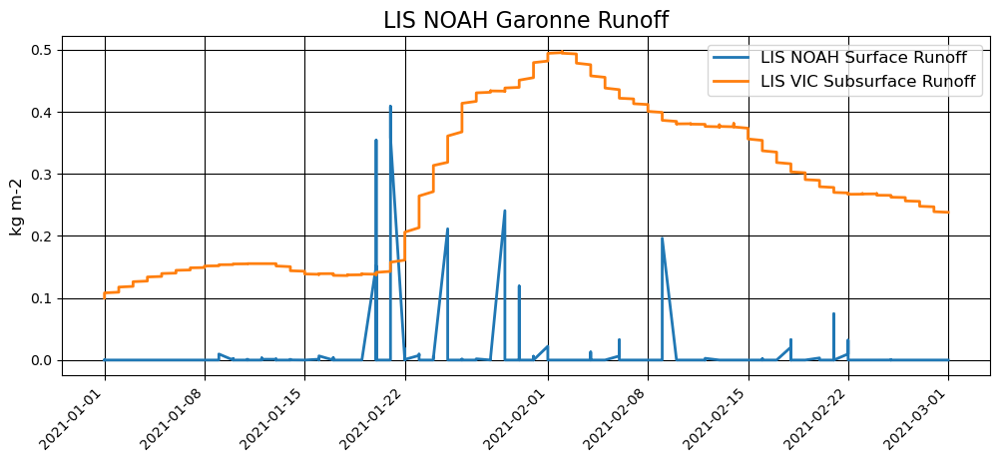

In [128]:
plotting.timeseries_plot([(gar_lis_noah_ts[0]['mean'], 'LIS NOAH Surface Runoff', 'tab:blue'), (gar_lis_noah_ts[1]['mean'], 'LIS VIC Subsurface Runoff', 'tab:orange')], '', 'kg m-2', 'LIS NOAH Garonne Runoff')

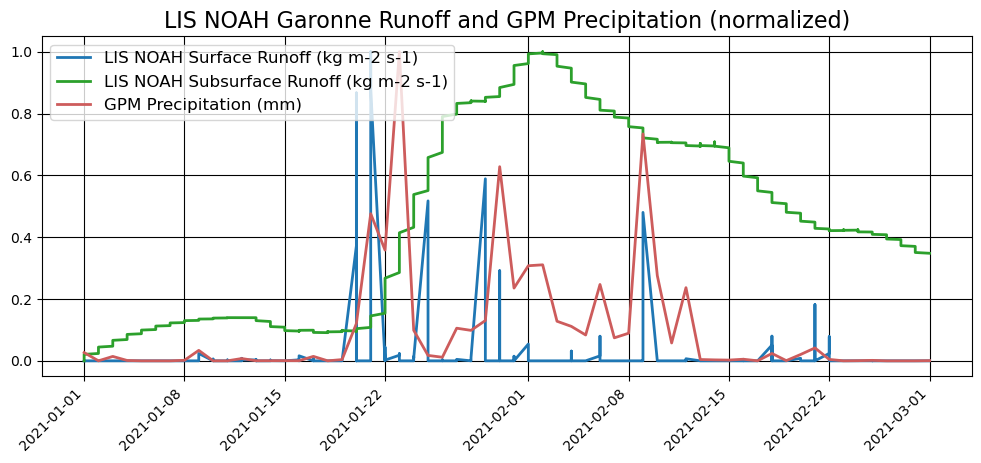

In [129]:
plotting.timeseries_plot([(gar_lis_noah_ts[0]['mean'], 'LIS NOAH Surface Runoff (kg m-2 s-1)', 'tab:blue'), (gar_lis_noah_ts[1]['mean'], 'LIS NOAH Subsurface Runoff (kg m-2 s-1)', 'tab:green'), (gpm_gar_ts['mean'], 'GPM Precipitation (mm)', 'indianred')], '', '', 'LIS NOAH Garonne Runoff and GPM Precipitation (normalized)', norm=True)

### LIS NOAH Full Basin

In [130]:
gar_lis_noah_basin_params = [(NEXUS_URL, ds, gar_basin_bb, gar_start, gar_end) for ds in ['GLDAS_NOAH10_3H_2_1_global_Qs_acc', 'GLDAS_NOAH10_3H_2_1_global_Qsb_acc']]

In [131]:
lis_noah_gar_tavg = [ideas_processing.temporal_mean(*gar_param) for gar_param in gar_lis_noah_basin_params]

url
 https://ideas-digitaltwin.jpl.nasa.gov/nexus/timeAvgMapSpark?ds=GLDAS_NOAH10_3H_2_1_global_Qs_acc&b=-1,40,4.9,46&startTime=2021-01-01T00:00:00Z&endTime=2021-03-01T00:00:00Z

Waiting for response from IDEAS... took 3.0182366670051124 seconds
url
 https://ideas-digitaltwin.jpl.nasa.gov/nexus/timeAvgMapSpark?ds=GLDAS_NOAH10_3H_2_1_global_Qsb_acc&b=-1,40,4.9,46&startTime=2021-01-01T00:00:00Z&endTime=2021-03-01T00:00:00Z

Waiting for response from IDEAS... took 2.3227827500086278 seconds


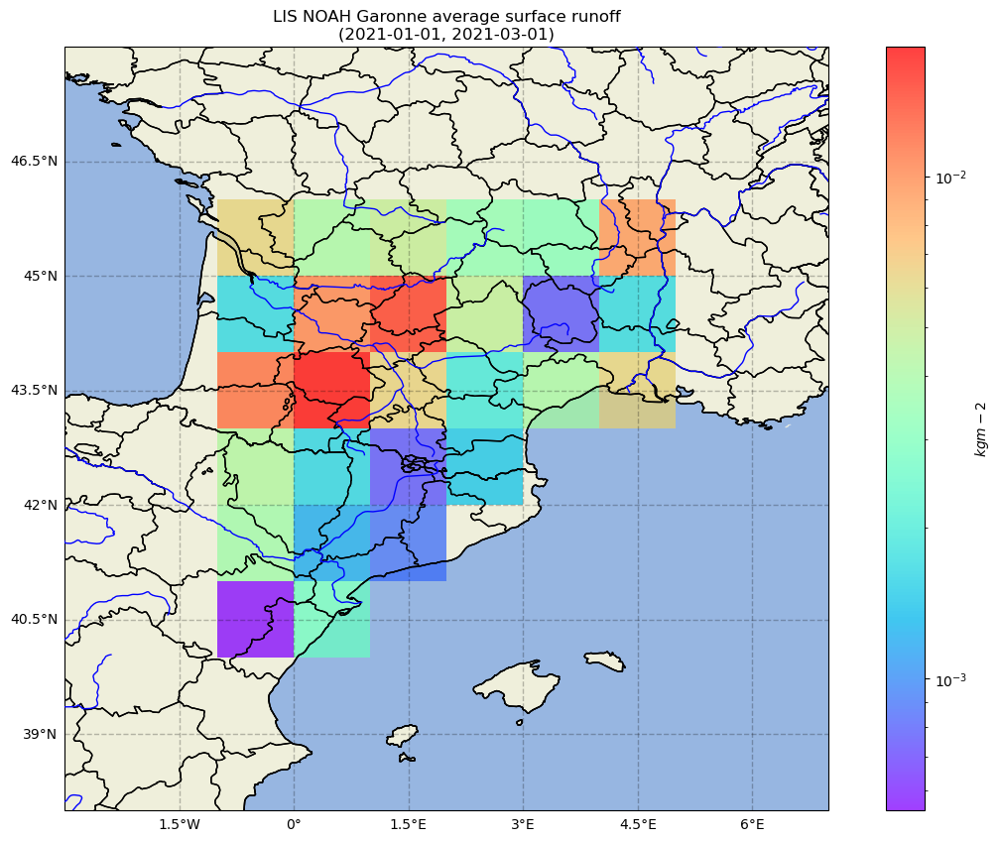

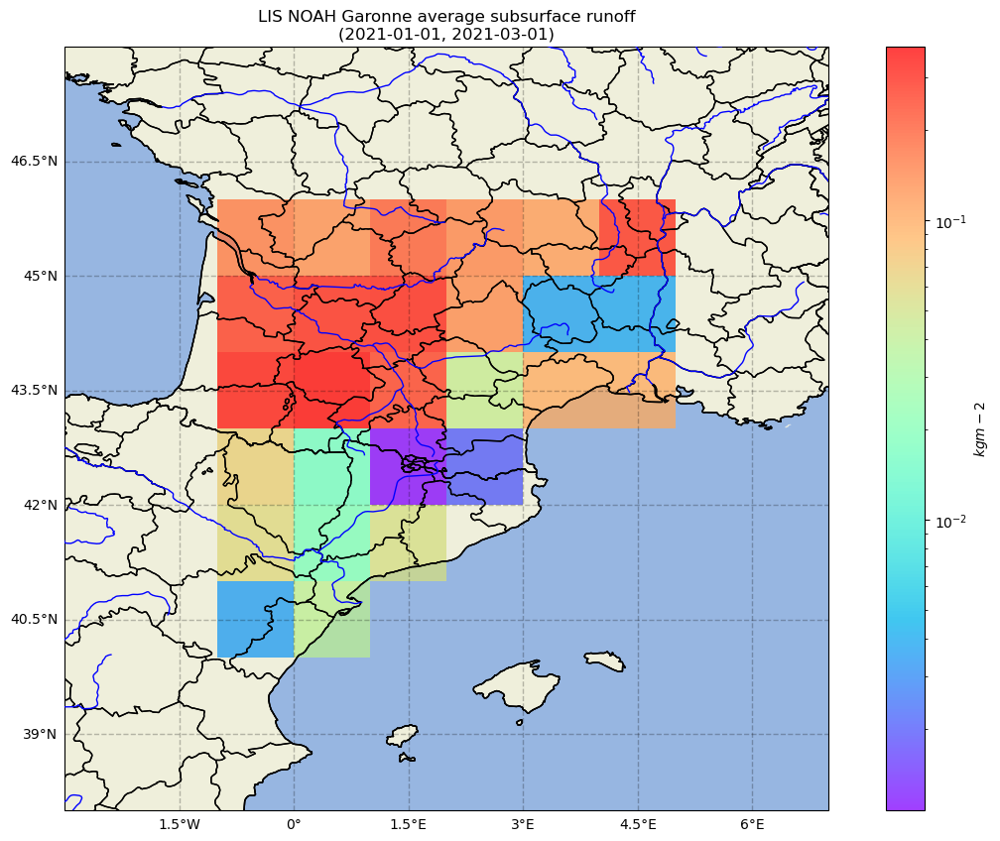

In [132]:
plotting.map_data(lis_noah_gar_tavg[0], 'LIS NOAH Garonne average surface runoff\n(2021-01-01, 2021-03-01)', cb_label='$kg m-2$', log_scale=True)
plotting.map_data(lis_noah_gar_tavg[1], 'LIS NOAH Garonne average subsurface runoff\n(2021-01-01, 2021-03-01)', cb_label='$kg m-2$', log_scale=True)

## LIS CLSM Runoff and GPM Precipitation

In [133]:
gar_lis_clsm_params = [(NEXUS_URL, ds, gar_bb, gar_start, gar_end) for ds in ['GLDAS_CLSM10_3H_2_1_global_Qs_acc', 'GLDAS_CLSM10_3H_2_1_global_Qsb_acc']]

In [134]:
gar_lis_clsm_ts = [ideas_processing.spatial_timeseries(*param) for param in gar_lis_clsm_params]

url
 https://ideas-digitaltwin.jpl.nasa.gov/nexus/timeSeriesSpark?ds=GLDAS_CLSM10_3H_2_1_global_Qs_acc&minLon=-0.5&minLat=44.25&maxLon=0.5&maxLat=44.75&startTime=2021-01-01T00:00:00Z&endTime=2021-03-01T00:00:00Z&lowPassFilter=False

Waiting for response from IDEAS...took 1.238933749991702 seconds
url
 https://ideas-digitaltwin.jpl.nasa.gov/nexus/timeSeriesSpark?ds=GLDAS_CLSM10_3H_2_1_global_Qsb_acc&minLon=-0.5&minLat=44.25&maxLon=0.5&maxLat=44.75&startTime=2021-01-01T00:00:00Z&endTime=2021-03-01T00:00:00Z&lowPassFilter=False

Waiting for response from IDEAS...took 1.229361500008963 seconds


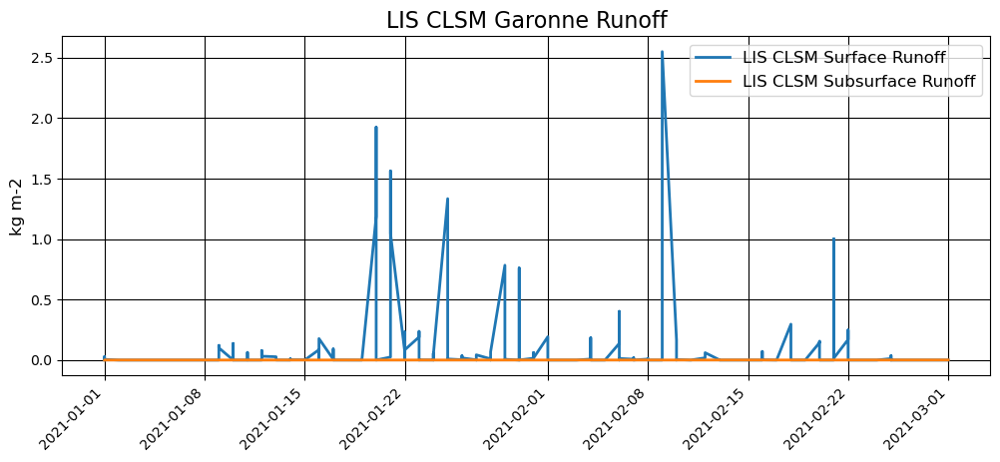

In [135]:
plotting.timeseries_plot([(gar_lis_clsm_ts[0]['mean'], 'LIS CLSM Surface Runoff', 'tab:blue'), (gar_lis_clsm_ts[1]['mean'], 'LIS CLSM Subsurface Runoff', 'tab:orange')], '', 'kg m-2', 'LIS CLSM Garonne Runoff')

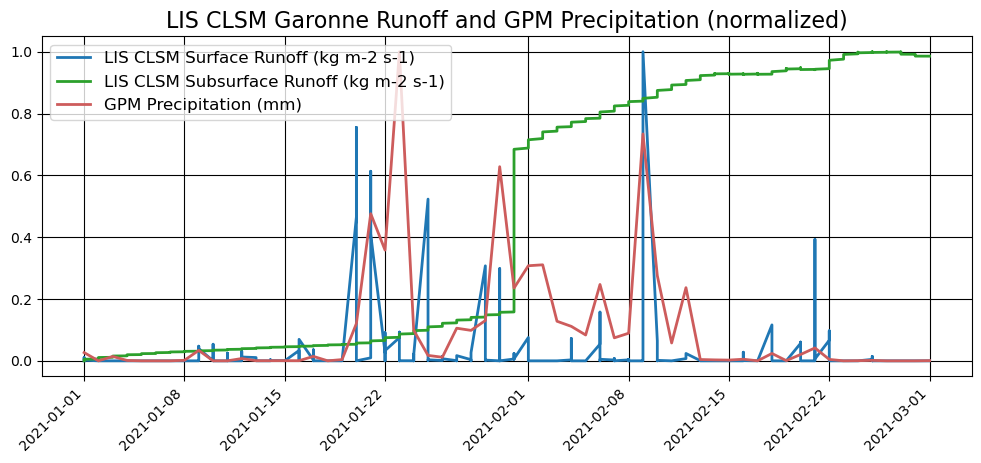

In [136]:
plotting.timeseries_plot([(gar_lis_clsm_ts[0]['mean'], 'LIS CLSM Surface Runoff (kg m-2 s-1)', 'tab:blue'), (gar_lis_clsm_ts[1]['mean'], 'LIS CLSM Subsurface Runoff (kg m-2 s-1)', 'tab:green'), (gpm_gar_ts['mean'], 'GPM Precipitation (mm)', 'indianred')], '', '', 'LIS CLSM Garonne Runoff and GPM Precipitation (normalized)', norm=True)

### LIS VIC Full Basin

In [137]:
gar_lis_clsm_basin_params = [(NEXUS_URL, ds, gar_basin_bb, gar_start, gar_end) for ds in ['GLDAS_CLSM10_3H_2_1_global_Qs_acc', 'GLDAS_CLSM10_3H_2_1_global_Qsb_acc']]

In [138]:
lis_clsm_gar_tavg = [ideas_processing.temporal_mean(*gar_param) for gar_param in gar_lis_clsm_basin_params]

url
 https://ideas-digitaltwin.jpl.nasa.gov/nexus/timeAvgMapSpark?ds=GLDAS_CLSM10_3H_2_1_global_Qs_acc&b=-1,40,4.9,46&startTime=2021-01-01T00:00:00Z&endTime=2021-03-01T00:00:00Z

Waiting for response from IDEAS... took 1.291603625024436 seconds
url
 https://ideas-digitaltwin.jpl.nasa.gov/nexus/timeAvgMapSpark?ds=GLDAS_CLSM10_3H_2_1_global_Qsb_acc&b=-1,40,4.9,46&startTime=2021-01-01T00:00:00Z&endTime=2021-03-01T00:00:00Z

Waiting for response from IDEAS... took 1.4293087499972899 seconds


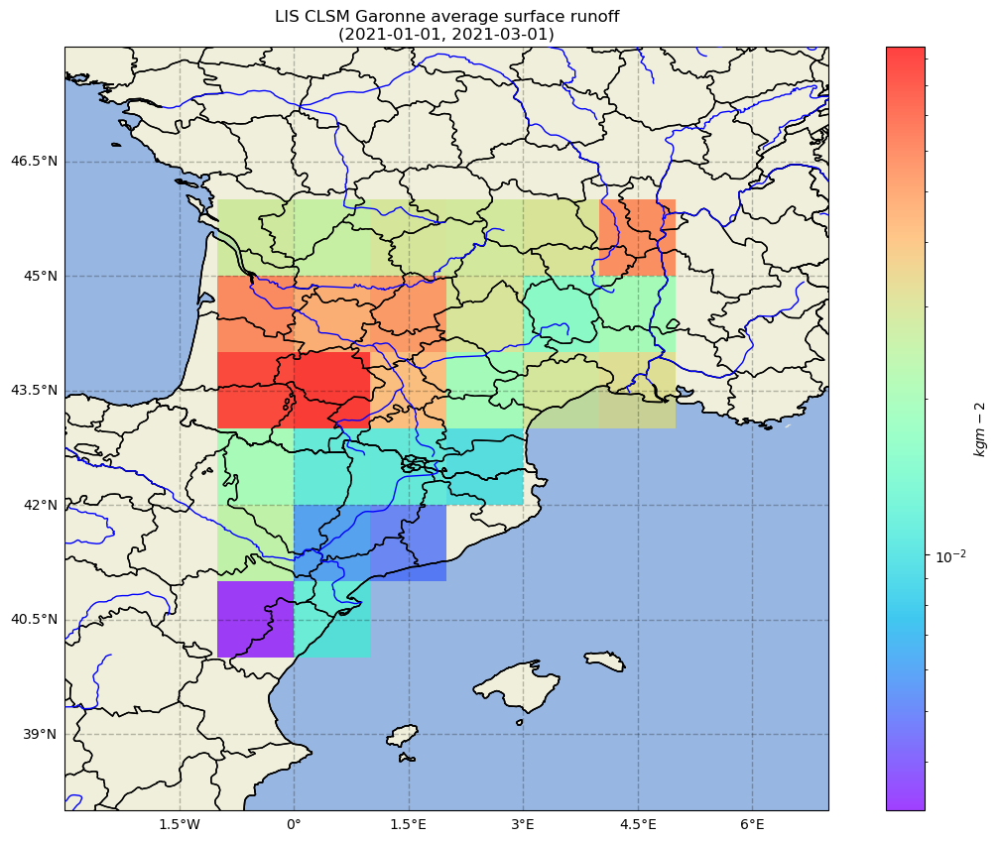

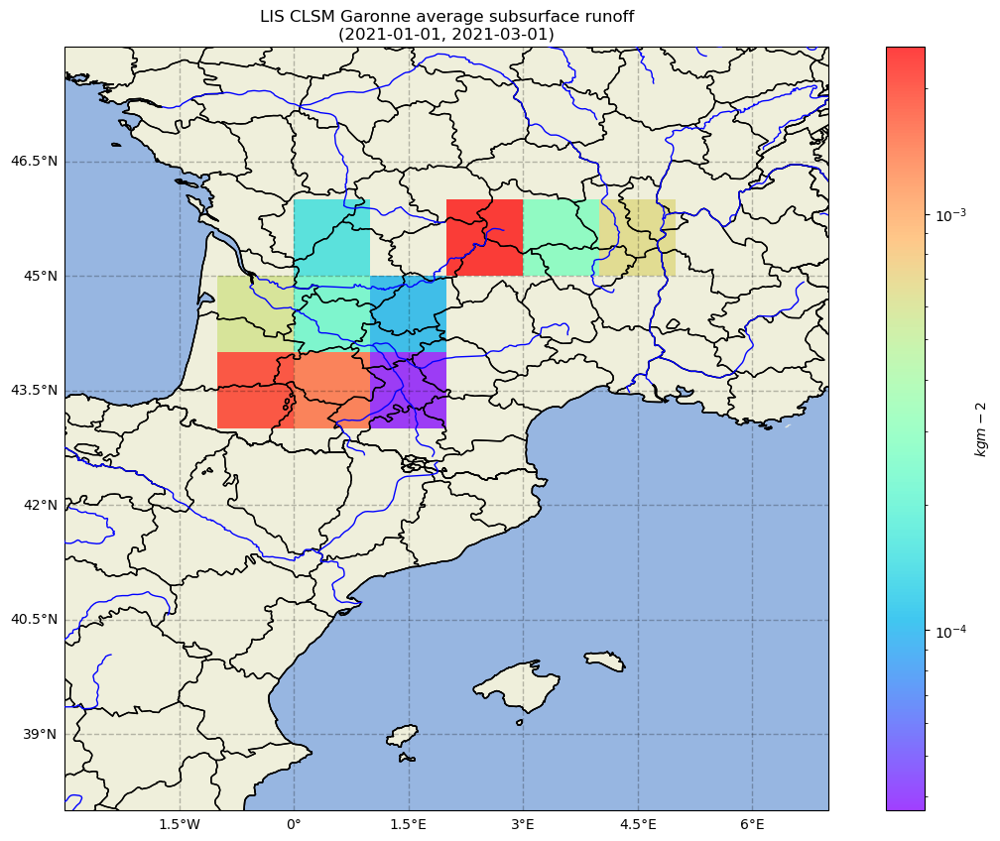

In [139]:
plotting.map_data(lis_clsm_gar_tavg[0], 'LIS CLSM Garonne average surface runoff\n(2021-01-01, 2021-03-01)', cb_label='$kg m-2$', log_scale=True)
plotting.map_data(lis_clsm_gar_tavg[1], 'LIS CLSM Garonne average subsurface runoff\n(2021-01-01, 2021-03-01)', cb_label='$kg m-2$', log_scale=True)

# RAPID Discharge 2021-03 through 2021-12 in Garonne

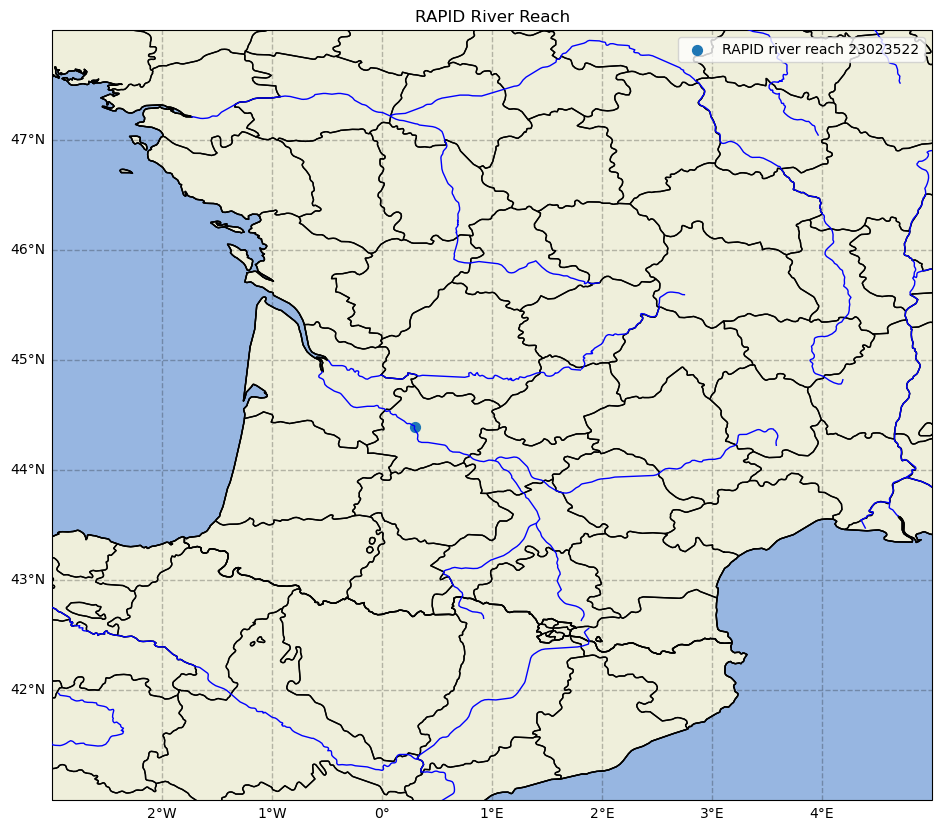

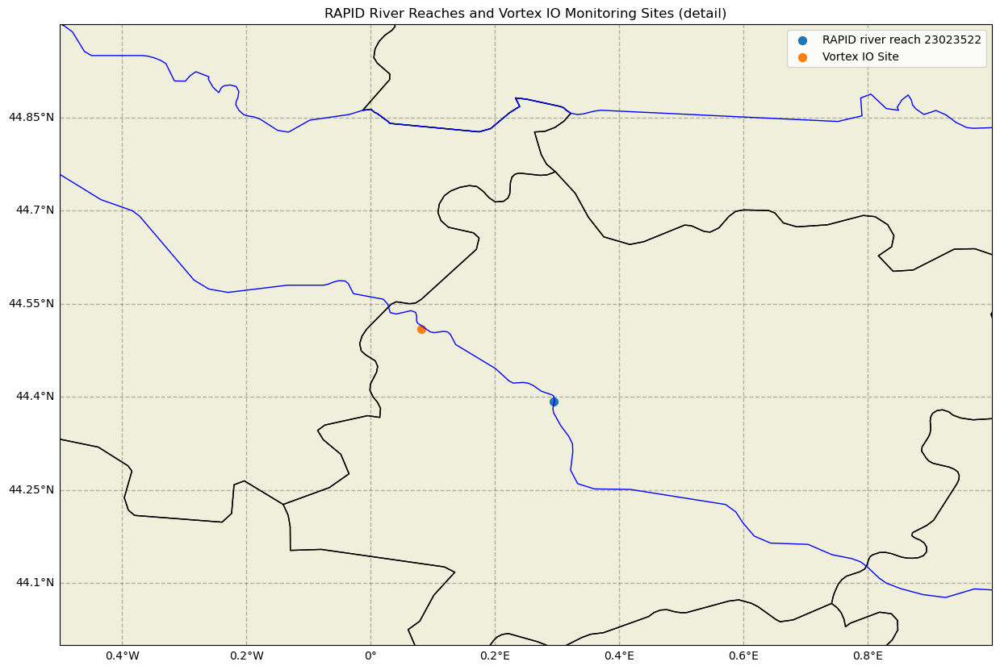

In [140]:
points = [
    (44.3917, 0.295, 'RAPID river reach 23023522')
]
plotting.map_points(points, 'gar', 'RAPID River Reach')
points.extend([(44.509687, 0.081479, 'Vortex IO Site')])
plotting.map_points(points, 'gar', 'RAPID River Reaches and Vortex IO Monitoring Sites (detail)', True)

In [141]:
rapid_lis_noahmp_gar_params = (NEXUS_URL, 'RAPID_LIS_1x_Garonne', 'IDEAS', '0,44.25,.5,44.7', datetime(2021, 3, 1), datetime(2021,12,31))
rapid_vic_gar_params = (NEXUS_URL, 'RAPID_VIC_Garonne', 'IDEAS', '0,44.25,.5,44.7', datetime(2021, 3, 1), datetime(2021,12,31))
rapid_noah_gar_params = (NEXUS_URL, 'RAPID_NOAH_Garonne', 'IDEAS', '0,44.25,.5,44.7', datetime(2021, 3, 1), datetime(2021,12,31))
rapid_clsm_gar_params = (NEXUS_URL, 'RAPID_CLSM_Garonne', 'IDEAS', '0,44.25,.5,44.7', datetime(2021, 3, 1), datetime(2021,12,31))
vortex_params = (NEXUS_URL, 'vortex-io', 'IDEAS', '0,44.25,.5,44.7', datetime(2021, 3, 1), datetime(2021,12,31))

In [142]:
rapid_lis_noahmp_gar_df = ideas_processing.insitu(*rapid_lis_noahmp_gar_params)
rapid_vic_gar_df = ideas_processing.insitu(*rapid_vic_gar_params)
rapid_noah_gar_df = ideas_processing.insitu(*rapid_noah_gar_params)
rapid_clsm_gar_df = ideas_processing.insitu(*rapid_clsm_gar_params)

https://ideas-digitaltwin.jpl.nasa.gov/insitu/1.0/query_data_doms_custom_pagination?startIndex=0&itemsPerPage=10000&provider=RAPID_LIS_1x_Garonne&project=IDEAS&startTime=2021-03-01T00:00:00Z&endTime=2021-12-31T00:00:00Z&bbox=0,44.25,.5,44.7
http://ideas-digitaltwin.jpl.nasa.gov/insitu/1.0/query_data_doms_custom_pagination?startIndex=0&itemsPerPage=10000&provider=RAPID_LIS_1x_Garonne&project=IDEAS&startTime=2021-03-01T00:00:00Z&endTime=2021-12-31T00:00:00Z&bbox=0,44.25,.5,44.7&markerTime=2021-12-30T00:00:00Z&markerPlatform=2435076b2c35abbffe7f01707d253888611a02449a264d6ab92a258129db31d5
https://ideas-digitaltwin.jpl.nasa.gov/insitu/1.0/query_data_doms_custom_pagination?startIndex=0&itemsPerPage=10000&provider=RAPID_VIC_Garonne&project=IDEAS&startTime=2021-03-01T00:00:00Z&endTime=2021-12-31T00:00:00Z&bbox=0,44.25,.5,44.7
http://ideas-digitaltwin.jpl.nasa.gov/insitu/1.0/query_data_doms_custom_pagination?startIndex=0&itemsPerPage=10000&provider=RAPID_VIC_Garonne&project=IDEAS&startTime=202

In [143]:
vortex_gar_df = ideas_processing.insitu(*vortex_params)

https://ideas-digitaltwin.jpl.nasa.gov/insitu/1.0/query_data_doms_custom_pagination?startIndex=0&itemsPerPage=10000&provider=vortex-io&project=IDEAS&startTime=2021-03-01T00:00:00Z&endTime=2021-12-31T00:00:00Z&bbox=0,44.25,.5,44.7
http://ideas-digitaltwin.jpl.nasa.gov/insitu/1.0/query_data_doms_custom_pagination?startIndex=0&itemsPerPage=10000&provider=vortex-io&project=IDEAS&startTime=2021-03-01T00:00:00Z&endTime=2021-12-31T00:00:00Z&bbox=0,44.25,.5,44.7&markerTime=2021-12-06T23:30:14Z&markerPlatform=1d8d749c39efd957bb3af79b1a491737f5332990b79783db98fd58d564c3a56c
http://ideas-digitaltwin.jpl.nasa.gov/insitu/1.0/query_data_doms_custom_pagination?startIndex=0&itemsPerPage=10000&provider=vortex-io&project=IDEAS&startTime=2021-03-01T00:00:00Z&endTime=2021-12-31T00:00:00Z&bbox=0,44.25,.5,44.7&markerTime=2021-12-30T23:30:15Z&markerPlatform=5a23fc803fb24ad1cb71e86cd70104e32dda3dd59b5fe5fe77c30472e733ea20


In [144]:
rapid_lis_noahmp_gar_site_df = rapid_lis_noahmp_gar_df[rapid_lis_noahmp_gar_df['platform_id'] == '23023522']
rapid_vic_gar_site_df = rapid_vic_gar_df[rapid_vic_gar_df['platform_id'] == '23023522']
rapid_noah_gar_site_df = rapid_noah_gar_df[rapid_noah_gar_df['platform_id'] == '23023522']
rapid_clsm_gar_site_df = rapid_clsm_gar_df[rapid_clsm_gar_df['platform_id'] == '23023522']
vortex_gar_site_df = vortex_gar_df[vortex_gar_df['platform_id'] == 'couthures-sur-garonne_1']

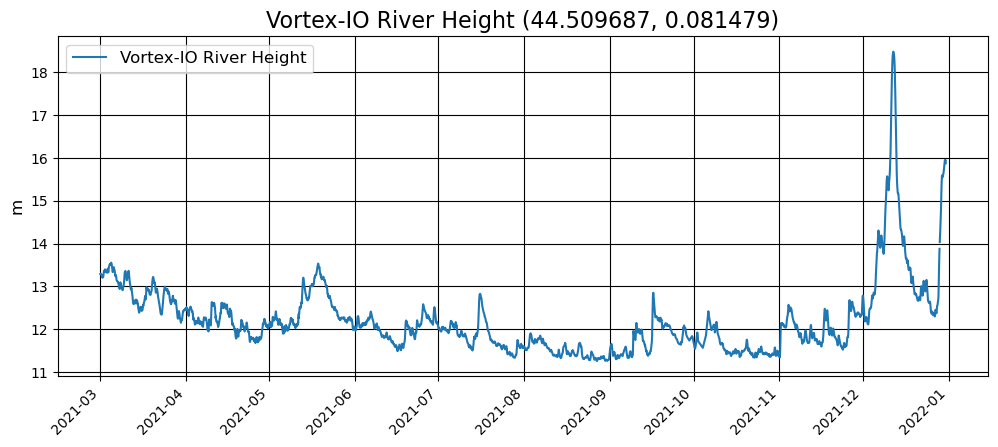

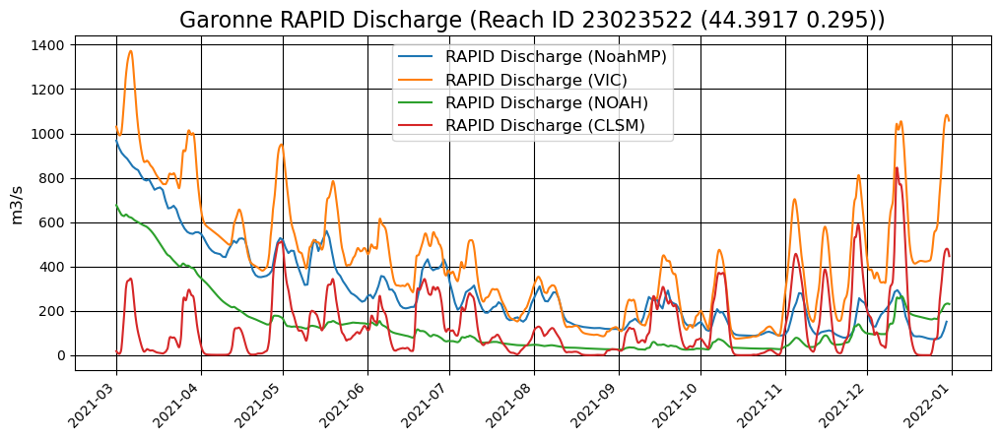

In [145]:
plotting.plot_insitu([(vortex_gar_site_df.where(vortex_gar_site_df['vortex_height']!= 0, np.nan), 'vortex_height', 'Vortex-IO River Height')], 'Vortex-IO River Height (44.509687, 0.081479)', 'm')
plotting.plot_insitu([
                      (rapid_lis_noahmp_gar_site_df, 'Qout', 'RAPID Discharge (NoahMP)'),
                      (rapid_vic_gar_site_df, 'Qout', 'RAPID Discharge (VIC)'),
                      (rapid_noah_gar_site_df, 'Qout', 'RAPID Discharge (NOAH)'),
                      (rapid_clsm_gar_site_df, 'Qout', 'RAPID Discharge (CLSM)')
                      ], 'Garonne RAPID Discharge (Reach ID 23023522 (44.3917 0.295))')

### Normalized Comparison

In [146]:
rapid_lis_noahmp_gar_site_subset_df = rapid_lis_noahmp_gar_site_df[rapid_lis_noahmp_gar_site_df['time'] >= np.datetime64('2021-11-10')]
rapid_vic_gar_site_subset_df = rapid_vic_gar_site_df[rapid_vic_gar_site_df['time'] >= np.datetime64('2021-11-10')]
rapid_noah_gar_site_subset_df = rapid_noah_gar_site_df[rapid_noah_gar_site_df['time'] >= np.datetime64('2021-11-10')]
rapid_clsm_gar_site_subset_df = rapid_clsm_gar_site_df[rapid_clsm_gar_site_df['time'] >= np.datetime64('2021-11-10')]
vortex_gar_site_subset_df = vortex_gar_site_df[vortex_gar_site_df['time'] >= np.datetime64('2021-11-10')]

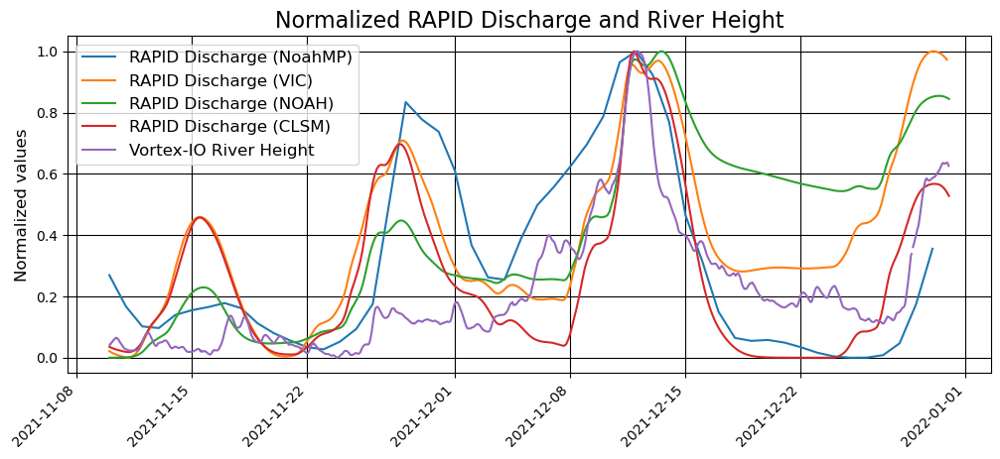

In [147]:
plotting.plot_insitu([
                      (rapid_lis_noahmp_gar_site_subset_df, 'Qout', 'RAPID Discharge (NoahMP)'),
                      (rapid_vic_gar_site_subset_df, 'Qout', 'RAPID Discharge (VIC)'),
                      (rapid_noah_gar_site_subset_df, 'Qout', 'RAPID Discharge (NOAH)'),
                      (rapid_clsm_gar_site_subset_df, 'Qout', 'RAPID Discharge (CLSM)'),
                      (vortex_gar_site_subset_df.where(vortex_gar_site_df['vortex_height']!= 0, np.nan), 'vortex_height', 'Vortex-IO River Height')
                      ], 'Normalized RAPID Discharge and River Height', norm=True)

# LIS NoahMP Scenarios

Three scenarios with different amounts of GDAS precipitation as input to LIS NoahMP. For each scenario we can perform spatial and temporal analysis of the LIS NoahMP data, as well as the resulting RAPID discharge data.

In [148]:
gar_bb = {'min_lon': -2, 'max_lon': 2, 'min_lat': 42, 'max_lat': 46}
gar_start    = datetime(2021, 1, 1)
gar_end     = datetime(2021, 10, 1)

## Scenario 1, Nominal Precipitation

In [149]:
gar_lis_scenario_1_params = [(NEXUS_URL, ds, gar_bb, datetime(2021, 2, 1), datetime(2021, 2, 15)) for ds in ['LIS_gar_gdas_1x_Qs_tavg', 'LIS_gar_gdas_1x_Qsb_tavg']]
gar_lis_scenario_1_sub = [ideas_processing.data_subsetting(*gar_param) for gar_param in gar_lis_scenario_1_params]

url
 https://ideas-digitaltwin.jpl.nasa.gov/nexus/datainbounds?ds=LIS_gar_gdas_1x_Qs_tavg&b=-2,42,2,46&startTime=2021-02-01T00:00:00Z&endTime=2021-02-15T00:00:00Z&lowPassFilter=False

Waiting for response from IDEAS...took 1.4825999579916243 seconds
url
 https://ideas-digitaltwin.jpl.nasa.gov/nexus/datainbounds?ds=LIS_gar_gdas_1x_Qsb_tavg&b=-2,42,2,46&startTime=2021-02-01T00:00:00Z&endTime=2021-02-15T00:00:00Z&lowPassFilter=False

Waiting for response from IDEAS...took 2.934128332999535 seconds


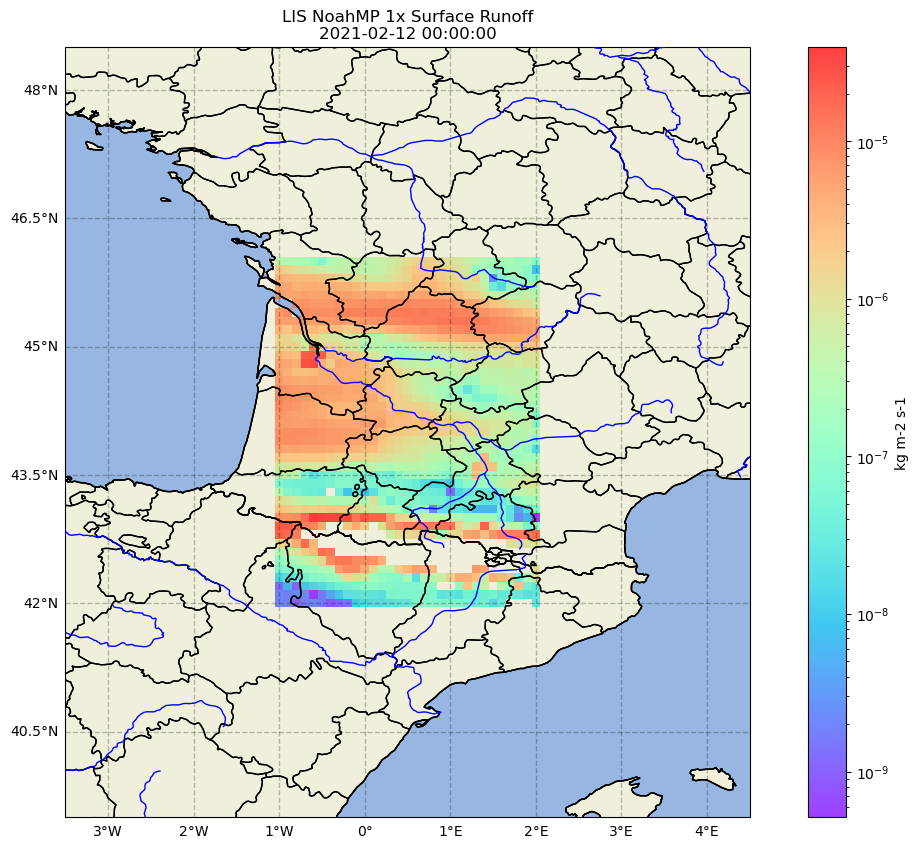

In [150]:
plotting.map_data(gar_lis_scenario_1_sub[0][11], f'LIS NoahMP 1x Surface Runoff\n{datetime.utcfromtimestamp(gar_lis_scenario_1_sub[0][11].time.values)}', cb_label="kg m-2 s-1", log_scale=True)

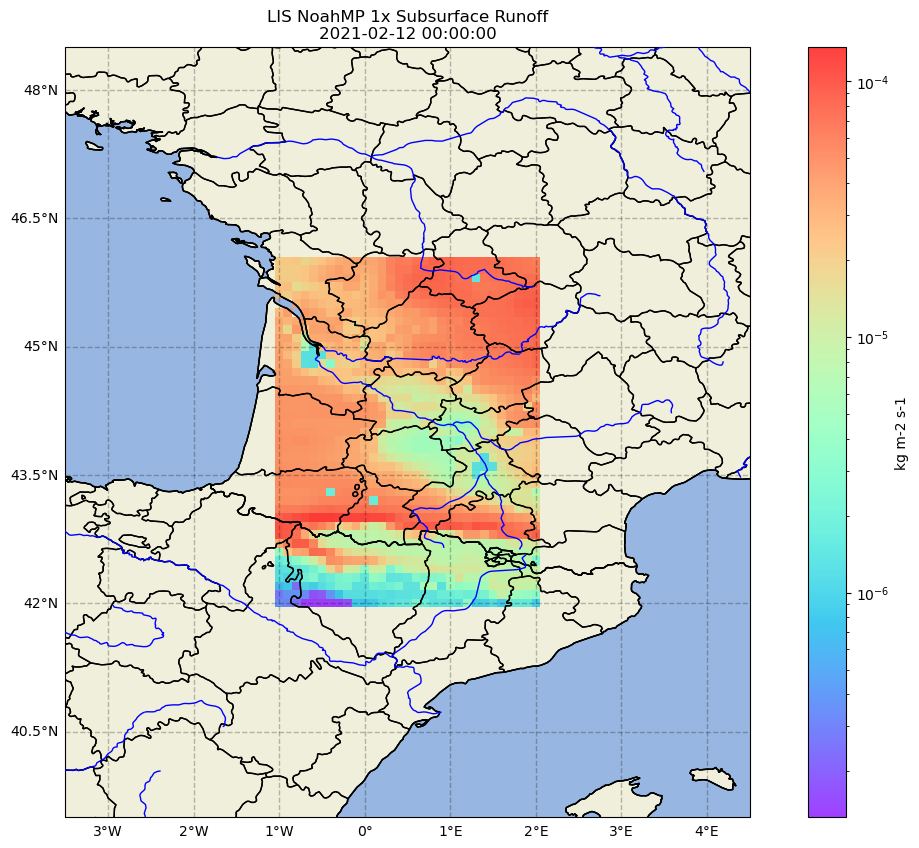

In [151]:
plotting.map_data(gar_lis_scenario_1_sub[1][11], f'LIS NoahMP 1x Subsurface Runoff\n{datetime.utcfromtimestamp(gar_lis_scenario_1_sub[1][11].time.values)}', cb_label="kg m-2 s-1", log_scale=True)

In [152]:
gar_lis_scenario_1_params = [(NEXUS_URL, ds, gar_bb, gar_start, gar_end) for ds in ['LIS_gar_gdas_1x_Qs_tavg', 'LIS_gar_gdas_1x_Qsb_tavg']]
gar_lis_scenario_1_ts = [ideas_processing.spatial_timeseries(*gar_param) for gar_param in gar_lis_scenario_1_params]

url
 https://ideas-digitaltwin.jpl.nasa.gov/nexus/timeSeriesSpark?ds=LIS_gar_gdas_1x_Qs_tavg&minLon=-2&minLat=42&maxLon=2&maxLat=46&startTime=2021-01-01T00:00:00Z&endTime=2021-10-01T00:00:00Z&lowPassFilter=False

Waiting for response from IDEAS...took 2.9595814159838483 seconds
url
 https://ideas-digitaltwin.jpl.nasa.gov/nexus/timeSeriesSpark?ds=LIS_gar_gdas_1x_Qsb_tavg&minLon=-2&minLat=42&maxLon=2&maxLat=46&startTime=2021-01-01T00:00:00Z&endTime=2021-10-01T00:00:00Z&lowPassFilter=False

Waiting for response from IDEAS...took 2.8485109169851057 seconds


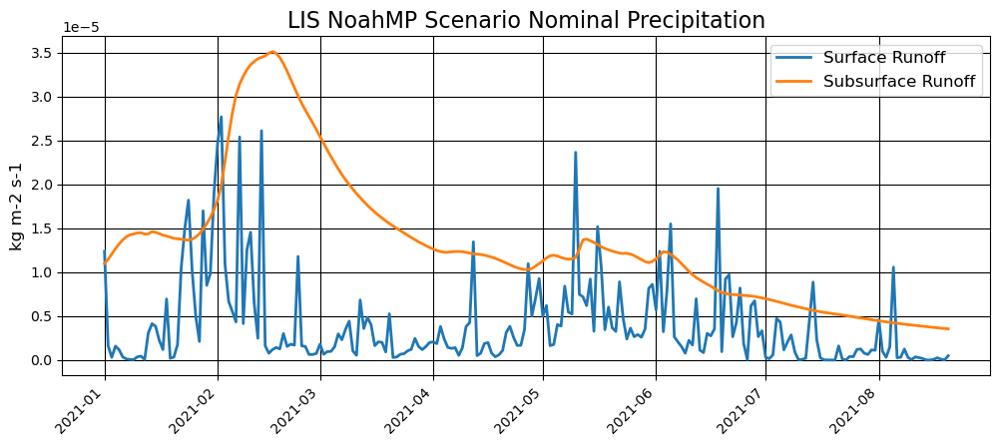

In [153]:
plotting.timeseries_plot([(gar_lis_scenario_1_ts[0]['mean'], 'Surface Runoff'), (gar_lis_scenario_1_ts[1]['mean'], 'Subsurface Runoff')], '', 'kg m-2 s-1', 'LIS NoahMP Scenario Nominal Precipitation')

https://ideas-digitaltwin.jpl.nasa.gov/insitu/1.0/query_data_doms_custom_pagination?startIndex=0&itemsPerPage=10000&provider=RAPID_LIS_1x_Garonne&project=IDEAS&startTime=2021-01-01T00:00:00Z&endTime=2021-09-30T00:00:00Z&bbox=0,44.25,.5,44.7
http://ideas-digitaltwin.jpl.nasa.gov/insitu/1.0/query_data_doms_custom_pagination?startIndex=0&itemsPerPage=10000&provider=RAPID_LIS_1x_Garonne&project=IDEAS&startTime=2021-01-01T00:00:00Z&endTime=2021-09-30T00:00:00Z&bbox=0,44.25,.5,44.7&markerTime=2021-09-30T00:00:00Z&markerPlatform=b0b7f521f8ac8fd1e6eaa7388cf8c3f708242db7056241f48378a926d599f1c8


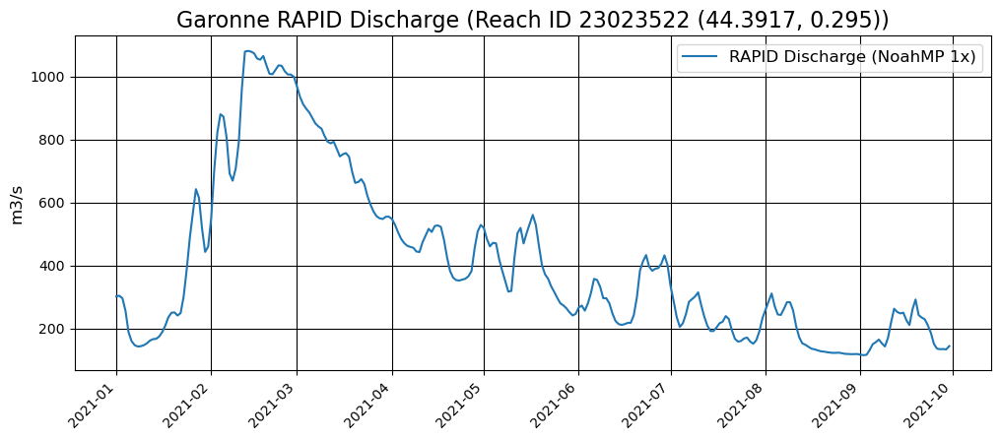

In [154]:
rapid_lis_noahmp_1x_gar_params = (NEXUS_URL, 'RAPID_LIS_1x_Garonne', 'IDEAS', '0,44.25,.5,44.7', datetime(2021, 1, 1), datetime(2021,9,30))
rapid_lis_noahmp_1x_gar_df = ideas_processing.insitu(*rapid_lis_noahmp_1x_gar_params)
rapid_lis_noahmp_1x_gar_site_df = rapid_lis_noahmp_1x_gar_df[rapid_lis_noahmp_1x_gar_df['platform_id'] == '23023522']
plotting.plot_insitu([
                      (rapid_lis_noahmp_1x_gar_site_df, 'Qout', 'RAPID Discharge (NoahMP 1x)'),
                      ], 'Garonne RAPID Discharge (Reach ID 23023522 (44.3917, 0.295))')

## Scenario 2, 2x Precipitation

In [155]:
gar_lis_scenario_2_params = [(NEXUS_URL, ds, gar_bb, datetime(2021, 2, 1), datetime(2021, 2, 15)) for ds in ['LIS_gar_gdas_2x_Qs_tavg', 'LIS_gar_gdas_2x_Qsb_tavg']]
gar_lis_scenario_2_sub = [ideas_processing.data_subsetting(*gar_param) for gar_param in gar_lis_scenario_2_params]

url
 https://ideas-digitaltwin.jpl.nasa.gov/nexus/datainbounds?ds=LIS_gar_gdas_2x_Qs_tavg&b=-2,42,2,46&startTime=2021-02-01T00:00:00Z&endTime=2021-02-15T00:00:00Z&lowPassFilter=False

Waiting for response from IDEAS...took 1.494190333003644 seconds
url
 https://ideas-digitaltwin.jpl.nasa.gov/nexus/datainbounds?ds=LIS_gar_gdas_2x_Qsb_tavg&b=-2,42,2,46&startTime=2021-02-01T00:00:00Z&endTime=2021-02-15T00:00:00Z&lowPassFilter=False

Waiting for response from IDEAS...took 1.3067999159975443 seconds


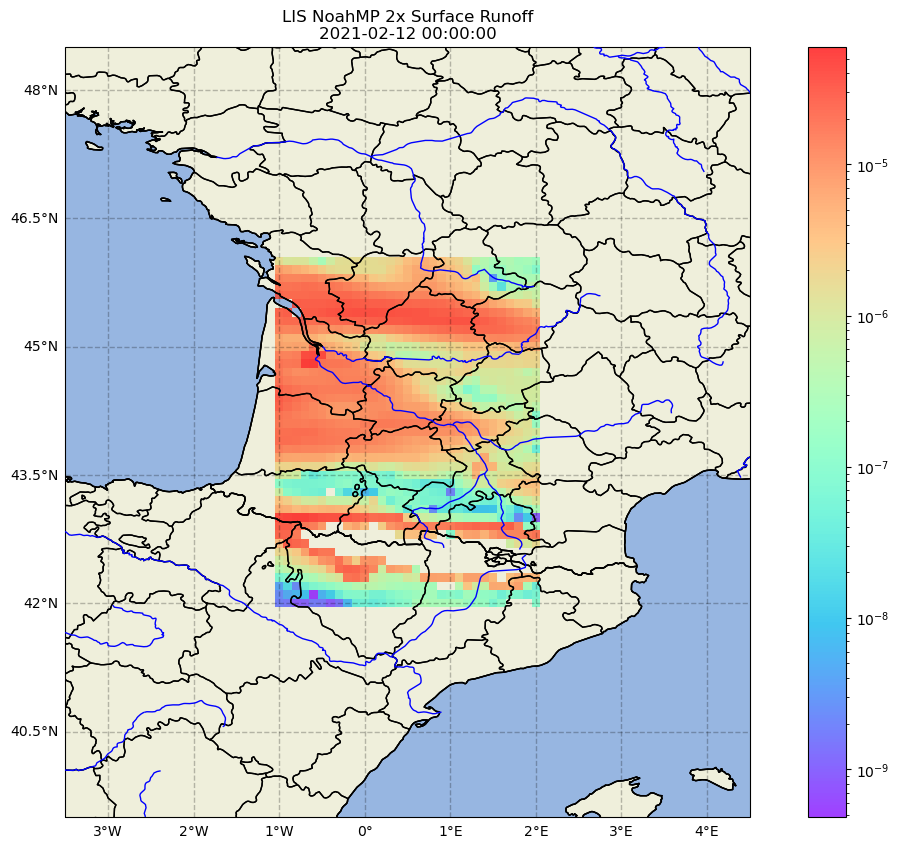

In [156]:
plotting.map_data(gar_lis_scenario_2_sub[0][11], f'LIS NoahMP 2x Surface Runoff\n{datetime.utcfromtimestamp(gar_lis_scenario_2_sub[0][11].time.values)}', log_scale=True)

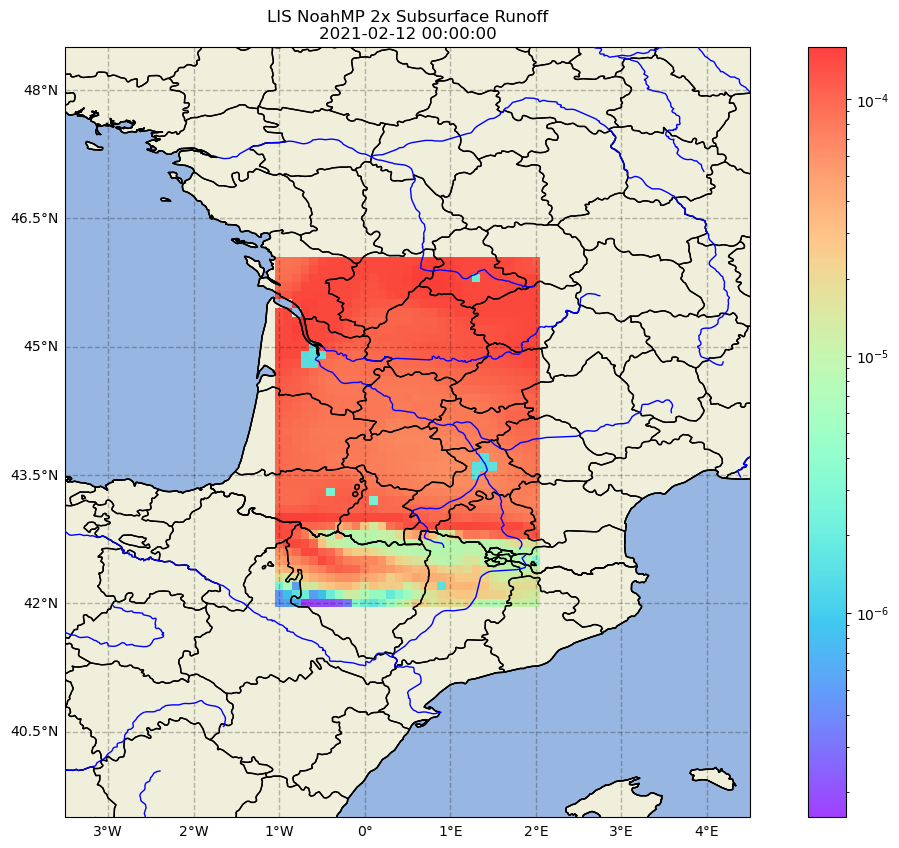

In [157]:
plotting.map_data(gar_lis_scenario_2_sub[1][11], f'LIS NoahMP 2x Subsurface Runoff\n{datetime.utcfromtimestamp(gar_lis_scenario_2_sub[1][11].time.values)}', log_scale=True)

In [158]:
gar_lis_scenario_2_ts = [ideas_processing.spatial_timeseries(*gar_param) for gar_param in gar_lis_scenario_2_params]

url
 https://ideas-digitaltwin.jpl.nasa.gov/nexus/timeSeriesSpark?ds=LIS_gar_gdas_2x_Qs_tavg&minLon=-2&minLat=42&maxLon=2&maxLat=46&startTime=2021-02-01T00:00:00Z&endTime=2021-02-15T00:00:00Z&lowPassFilter=False

Waiting for response from IDEAS...took 2.0871649580076337 seconds
url
 https://ideas-digitaltwin.jpl.nasa.gov/nexus/timeSeriesSpark?ds=LIS_gar_gdas_2x_Qsb_tavg&minLon=-2&minLat=42&maxLon=2&maxLat=46&startTime=2021-02-01T00:00:00Z&endTime=2021-02-15T00:00:00Z&lowPassFilter=False

Waiting for response from IDEAS...took 2.0831162920221686 seconds


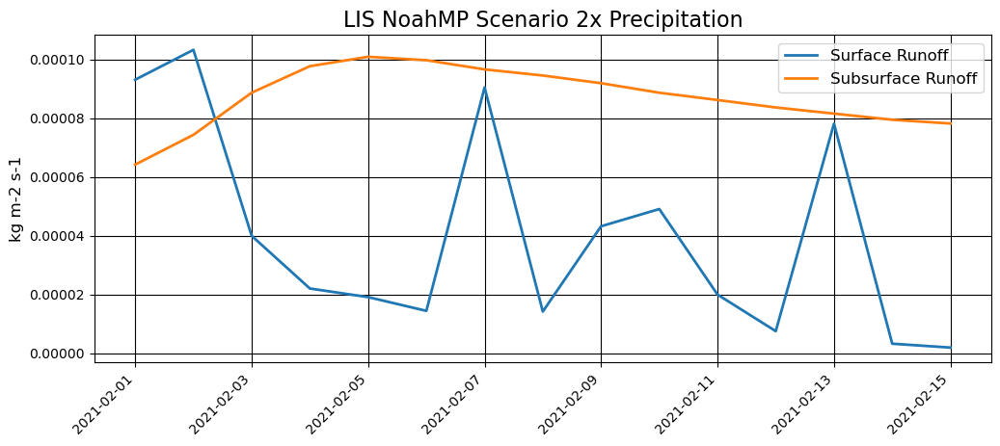

In [159]:
plotting.timeseries_plot([(gar_lis_scenario_2_ts[0]['mean'], 'Surface Runoff'), (gar_lis_scenario_2_ts[1]['mean'], 'Subsurface Runoff')], '', 'kg m-2 s-1', 'LIS NoahMP Scenario 2x Precipitation')

https://ideas-digitaltwin.jpl.nasa.gov/insitu/1.0/query_data_doms_custom_pagination?startIndex=0&itemsPerPage=10000&provider=RAPID_LIS_2x_Garonne&project=IDEAS&startTime=2021-01-01T00:00:00Z&endTime=2021-09-30T00:00:00Z&bbox=0,44.25,.5,44.7
http://ideas-digitaltwin.jpl.nasa.gov/insitu/1.0/query_data_doms_custom_pagination?startIndex=0&itemsPerPage=10000&provider=RAPID_LIS_2x_Garonne&project=IDEAS&startTime=2021-01-01T00:00:00Z&endTime=2021-09-30T00:00:00Z&bbox=0,44.25,.5,44.7&markerTime=2021-09-30T00:00:00Z&markerPlatform=9b671d84fdb1127b3315aca69d4f284ecf5215d64d67c6d34d985044486c9a44


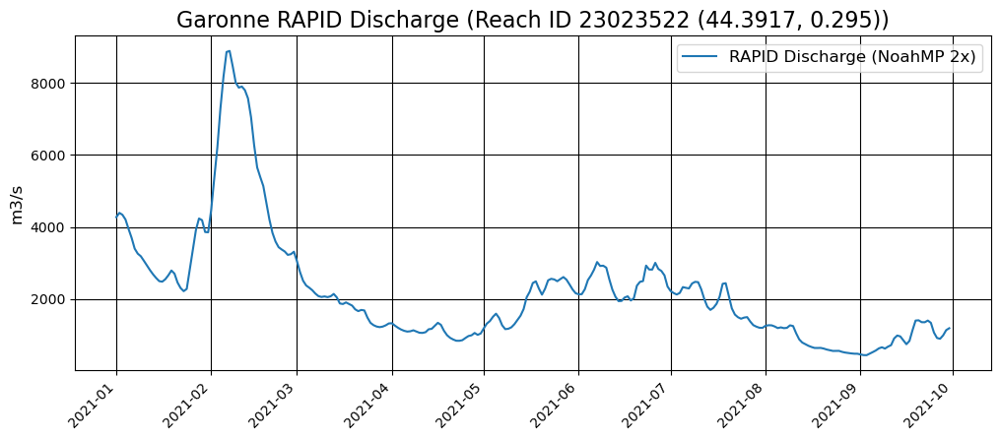

In [160]:
rapid_lis_noahmp_2x_gar_params = (NEXUS_URL, 'RAPID_LIS_2x_Garonne', 'IDEAS', '0,44.25,.5,44.7', datetime(2021, 1, 1), datetime(2021,9,30))
rapid_lis_noahmp_2x_gar_df = ideas_processing.insitu(*rapid_lis_noahmp_2x_gar_params)
rapid_lis_noahmp_2x_gar_site_df = rapid_lis_noahmp_2x_gar_df[rapid_lis_noahmp_2x_gar_df['platform_id'] == '23023522']
plotting.plot_insitu([
                      (rapid_lis_noahmp_2x_gar_site_df, 'Qout', 'RAPID Discharge (NoahMP 2x)'),
                      ], 'Garonne RAPID Discharge (Reach ID 23023522 (44.3917, 0.295))')

## Scenario 3, 3x Precipitation

In [161]:
gar_lis_scenario_3_params = [(NEXUS_URL, ds, gar_bb, datetime(2021, 2, 1), datetime(2021, 2, 15)) for ds in ['LIS_gar_gdas_3x_Qs_tavg', 'LIS_gar_gdas_3x_Qsb_tavg']]
gar_lis_scenario_3_sub = [ideas_processing.data_subsetting(*gar_param) for gar_param in gar_lis_scenario_3_params]

url
 https://ideas-digitaltwin.jpl.nasa.gov/nexus/datainbounds?ds=LIS_gar_gdas_3x_Qs_tavg&b=-2,42,2,46&startTime=2021-02-01T00:00:00Z&endTime=2021-02-15T00:00:00Z&lowPassFilter=False

Waiting for response from IDEAS...took 1.5213526659936178 seconds
url
 https://ideas-digitaltwin.jpl.nasa.gov/nexus/datainbounds?ds=LIS_gar_gdas_3x_Qsb_tavg&b=-2,42,2,46&startTime=2021-02-01T00:00:00Z&endTime=2021-02-15T00:00:00Z&lowPassFilter=False

Waiting for response from IDEAS...took 1.1327437500003725 seconds


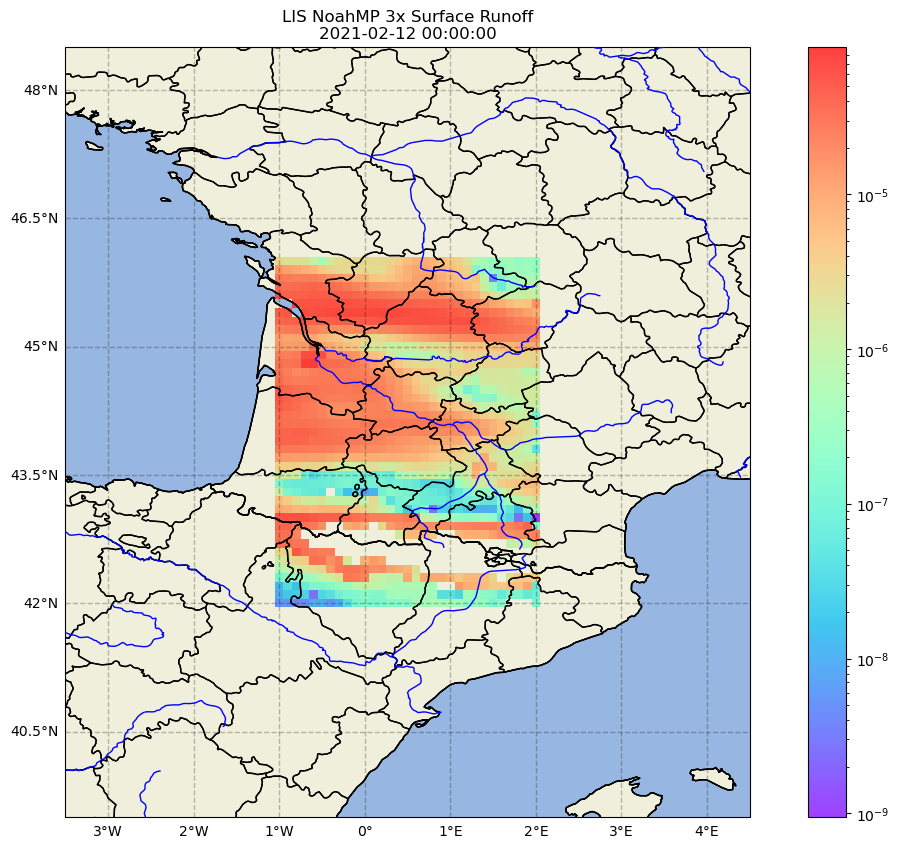

In [162]:
plotting.map_data(gar_lis_scenario_3_sub[0][11], f'LIS NoahMP 3x Surface Runoff\n{datetime.utcfromtimestamp(gar_lis_scenario_3_sub[0][11].time.values)}', log_scale=True)

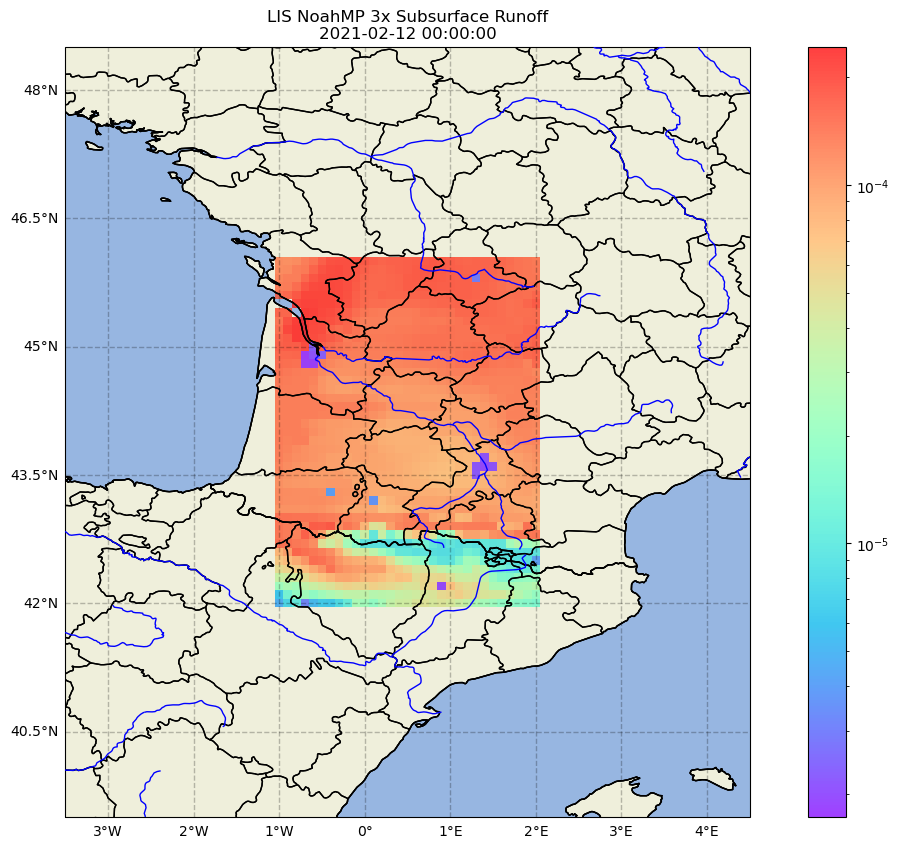

In [163]:
plotting.map_data(gar_lis_scenario_3_sub[1][11], f'LIS NoahMP 3x Subsurface Runoff\n{datetime.utcfromtimestamp(gar_lis_scenario_3_sub[1][11].time.values)}', log_scale=True)

In [164]:
gar_lis_scenario_3_ts = [ideas_processing.spatial_timeseries(*gar_param) for gar_param in gar_lis_scenario_3_params]

url
 https://ideas-digitaltwin.jpl.nasa.gov/nexus/timeSeriesSpark?ds=LIS_gar_gdas_3x_Qs_tavg&minLon=-2&minLat=42&maxLon=2&maxLat=46&startTime=2021-02-01T00:00:00Z&endTime=2021-02-15T00:00:00Z&lowPassFilter=False

Waiting for response from IDEAS...took 1.6700335000059567 seconds
url
 https://ideas-digitaltwin.jpl.nasa.gov/nexus/timeSeriesSpark?ds=LIS_gar_gdas_3x_Qsb_tavg&minLon=-2&minLat=42&maxLon=2&maxLat=46&startTime=2021-02-01T00:00:00Z&endTime=2021-02-15T00:00:00Z&lowPassFilter=False

Waiting for response from IDEAS...took 0.3006251670012716 seconds


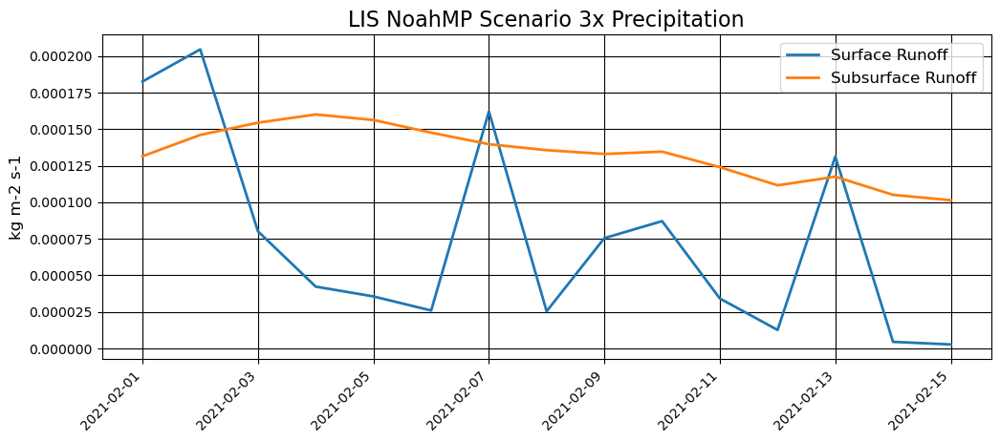

In [165]:
plotting.timeseries_plot([(gar_lis_scenario_3_ts[0]['mean'], 'Surface Runoff'), (gar_lis_scenario_3_ts[1]['mean'], 'Subsurface Runoff')], '', 'kg m-2 s-1', 'LIS NoahMP Scenario 3x Precipitation')

https://ideas-digitaltwin.jpl.nasa.gov/insitu/1.0/query_data_doms_custom_pagination?startIndex=0&itemsPerPage=10000&provider=RAPID_LIS_3x_Garonne&project=IDEAS&startTime=2021-01-01T00:00:00Z&endTime=2021-09-30T00:00:00Z&bbox=0,44.25,.5,44.7
http://ideas-digitaltwin.jpl.nasa.gov/insitu/1.0/query_data_doms_custom_pagination?startIndex=0&itemsPerPage=10000&provider=RAPID_LIS_3x_Garonne&project=IDEAS&startTime=2021-01-01T00:00:00Z&endTime=2021-09-30T00:00:00Z&bbox=0,44.25,.5,44.7&markerTime=2021-09-30T00:00:00Z&markerPlatform=4a7e408c45a3e2a5ff16aefca59067f9a9985457c988cea9bdce69210789737a


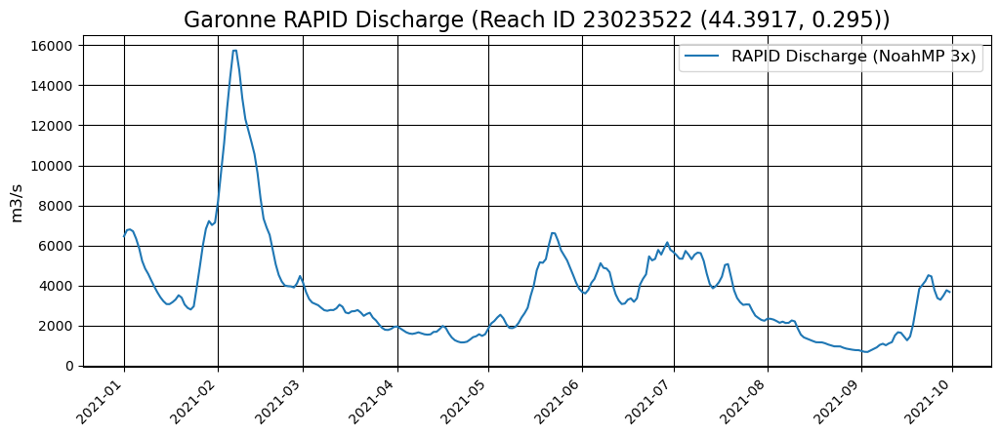

In [166]:
rapid_lis_noahmp_3x_gar_params = (NEXUS_URL, 'RAPID_LIS_3x_Garonne', 'IDEAS', '0,44.25,.5,44.7', datetime(2021, 1, 1), datetime(2021,9,30))
rapid_lis_noahmp_3x_gar_df = ideas_processing.insitu(*rapid_lis_noahmp_3x_gar_params)
rapid_lis_noahmp_3x_gar_site_df = rapid_lis_noahmp_3x_gar_df[rapid_lis_noahmp_3x_gar_df['platform_id'] == '23023522']
plotting.plot_insitu([
                      (rapid_lis_noahmp_3x_gar_site_df, 'Qout', 'RAPID Discharge (NoahMP 3x)'),
                      ], 'Garonne RAPID Discharge (Reach ID 23023522 (44.3917, 0.295))')

## Telemac2D

In [167]:
telemac_params = (NEXUS_URL, 'telemac2d_rapid_noahmp_WSE_height_above_mean_sea_level', gar_bb, datetime(2021,1,16), datetime(2021,1,17))

In [168]:
telemac_wse_subset_data = ideas_processing.data_subsetting(NEXUS_URL, 'telemac2d_rapid_noahmp_WSE_height_above_mean_sea_level', gar_bb, datetime(2021,1,16,12), datetime(2021,1,16,12))

url
 https://ideas-digitaltwin.jpl.nasa.gov/nexus/datainbounds?ds=telemac2d_rapid_noahmp_WSE_height_above_mean_sea_level&b=-2,42,2,46&startTime=2021-01-16T12:00:00Z&endTime=2021-01-16T12:00:00Z&lowPassFilter=False

Waiting for response from IDEAS...took 59.34875949998968 seconds


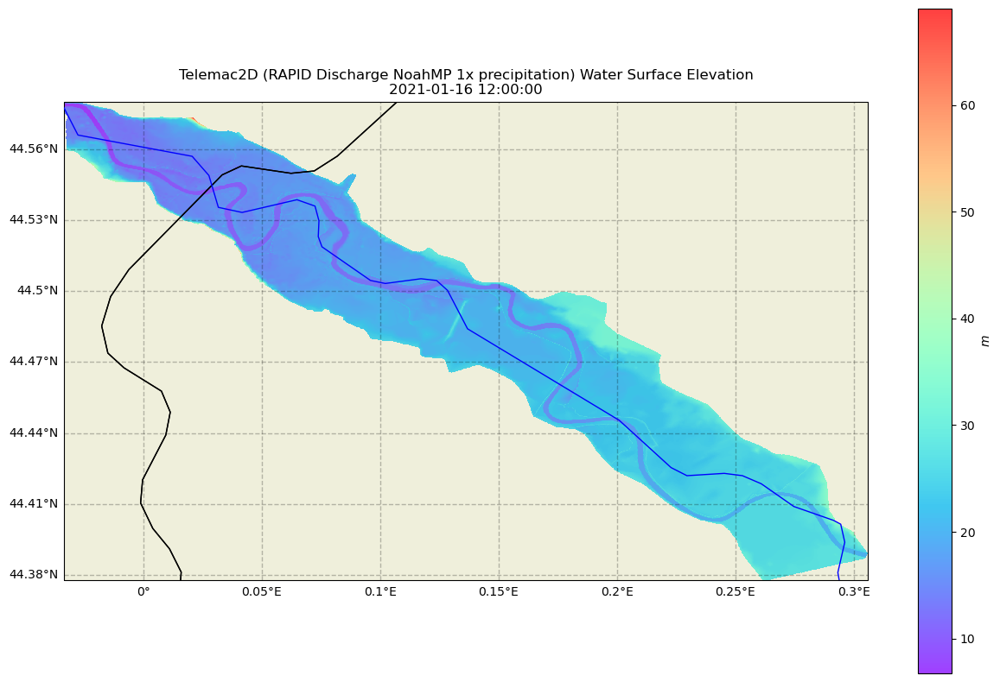

In [169]:
plotting.map_data(telemac_wse_subset_data[0], f'Telemac2D (RAPID Discharge NoahMP 1x precipitation) Water Surface Elevation\n{str(datetime(2021,1,16,12))}', cb_label="$m$", padding=0)

In [188]:
telemac_wse_ts = ideas_processing.spatial_timeseries(NEXUS_URL, 'telemac2d_rapid_noahmp_WSE_height_above_mean_sea_level', gar_bb, datetime(2021,1,16), datetime(2021,1,17))
telemac_u_ts = ideas_processing.spatial_timeseries(NEXUS_URL, 'telemac2d_rapid_noahmp_U_height_above_mean_sea_level', gar_bb, datetime(2021,1,16), datetime(2021,1,17))
telemac_v_ts = ideas_processing.spatial_timeseries(NEXUS_URL, 'telemac2d_rapid_noahmp_V_height_above_mean_sea_level', gar_bb, datetime(2021,1,16), datetime(2021,1,17))

url
 https://ideas-digitaltwin.jpl.nasa.gov/nexus/timeSeriesSpark?ds=telemac2d_rapid_noahmp_WSE_height_above_mean_sea_level&minLon=-2&minLat=42&maxLon=2&maxLat=46&startTime=2021-01-16T00:00:00Z&endTime=2021-01-17T00:00:00Z&lowPassFilter=False

Waiting for response from IDEAS...took 41.08110533299623 seconds
url
 https://ideas-digitaltwin.jpl.nasa.gov/nexus/timeSeriesSpark?ds=telemac2d_rapid_noahmp_U_height_above_mean_sea_level&minLon=-2&minLat=42&maxLon=2&maxLat=46&startTime=2021-01-16T00:00:00Z&endTime=2021-01-17T00:00:00Z&lowPassFilter=False

Waiting for response from IDEAS...took 15.26747229200555 seconds
url
 https://ideas-digitaltwin.jpl.nasa.gov/nexus/timeSeriesSpark?ds=telemac2d_rapid_noahmp_V_height_above_mean_sea_level&minLon=-2&minLat=42&maxLon=2&maxLat=46&startTime=2021-01-16T00:00:00Z&endTime=2021-01-17T00:00:00Z&lowPassFilter=False

Waiting for response from IDEAS...took 15.154845666984329 seconds


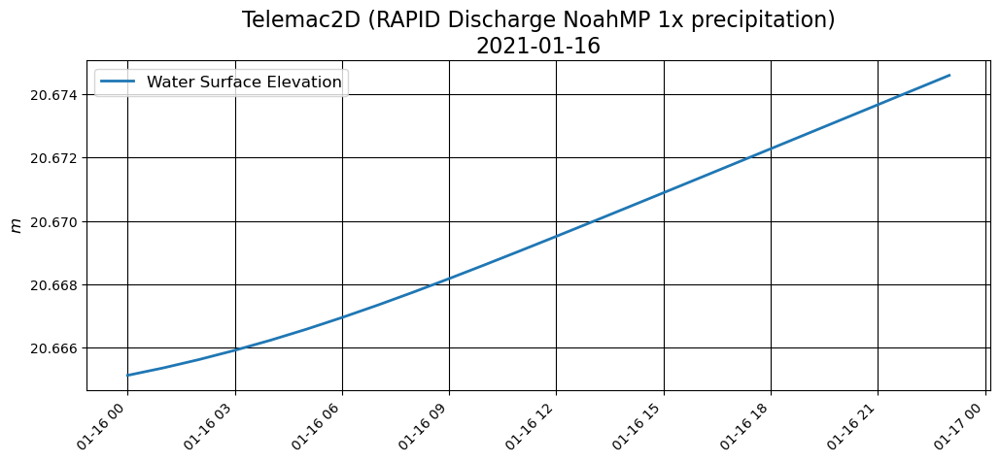

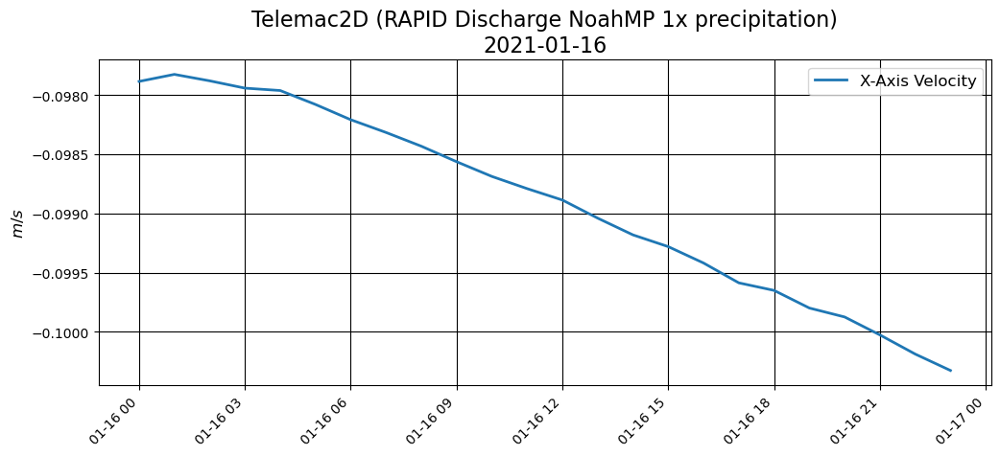

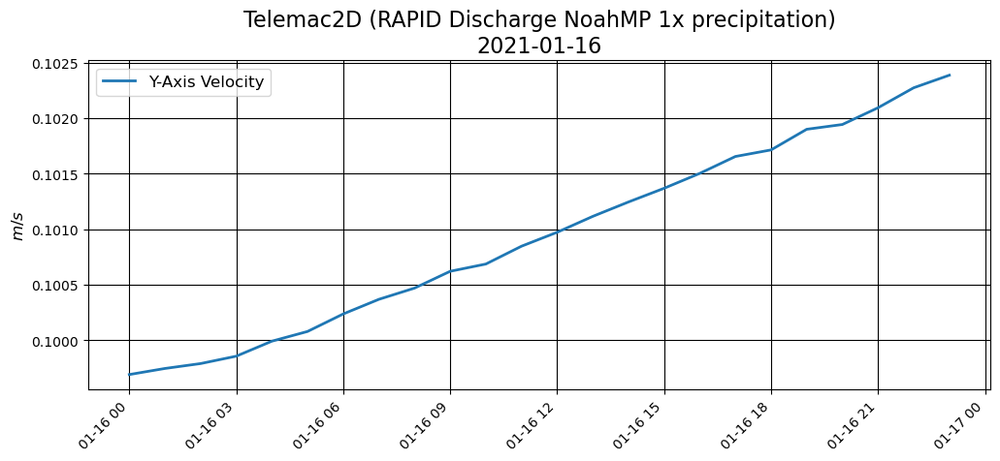

In [189]:
plotting.timeseries_plot([(telemac_wse_ts['mean'], 'Water Surface Elevation')], '', '$m$', f'Telemac2D (RAPID Discharge NoahMP 1x precipitation)\n{str(datetime(2021,1,16))[:10]}')
plotting.timeseries_plot([(telemac_u_ts['mean'], 'X-Axis Velocity')], '', '$m/s$', f'Telemac2D (RAPID Discharge NoahMP 1x precipitation)\n{str(datetime(2021,1,16))[:10]}')
plotting.timeseries_plot([(telemac_v_ts['mean'], 'Y-Axis Velocity')], '', '$m/s$', f'Telemac2D (RAPID Discharge NoahMP 1x precipitation)\n{str(datetime(2021,1,16))[:10]}')

# LIS NoahMP Soil Evaporation

In [172]:
global_precipitation_dataset  = 'GPM_3IMERGDL_precipitationCal'
soil_dataset = 'LIS-ESoil-tavg'
soil_bb      = {'min_lon': -94.5, 'max_lon': -88, 'min_lat': 29, 'max_lat': 38}
soil_start   = datetime(2020, 1, 1)
soil_end     = datetime(2020, 1, 31)
lis_noahmp_evap_parameters = (NEXUS_URL, soil_dataset, soil_bb, soil_start, soil_end)
lis_noahmp_rain_parameters = (NEXUS_URL, global_precipitation_dataset, soil_bb, soil_start, soil_end)

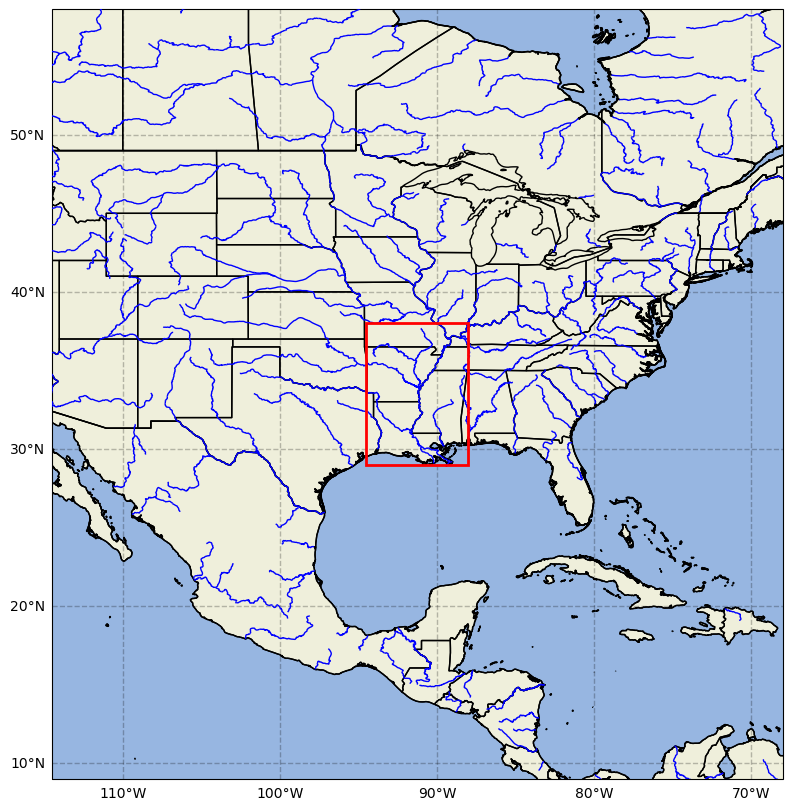

In [173]:
plotting.map_box(soil_bb)

#### Precipitation and Direct Evaporation from Bare Soil 2020-1-1 to 2020-01-31

In [174]:
lis_noahmp_evap_timeseries = ideas_processing.spatial_timeseries(*lis_noahmp_evap_parameters)
lis_noahmp_rain_timeseries = ideas_processing.spatial_timeseries(*lis_noahmp_rain_parameters)

url
 https://ideas-digitaltwin.jpl.nasa.gov/nexus/timeSeriesSpark?ds=LIS-ESoil-tavg&minLon=-94.5&minLat=29&maxLon=-88&maxLat=38&startTime=2020-01-01T00:00:00Z&endTime=2020-01-31T00:00:00Z&lowPassFilter=False

Waiting for response from IDEAS...took 2.444641625013901 seconds
url
 https://ideas-digitaltwin.jpl.nasa.gov/nexus/timeSeriesSpark?ds=GPM_3IMERGDL_precipitationCal&minLon=-94.5&minLat=29&maxLon=-88&maxLat=38&startTime=2020-01-01T00:00:00Z&endTime=2020-01-31T00:00:00Z&lowPassFilter=False

Waiting for response from IDEAS...took 2.4925104999856558 seconds


#### Precipitation Time Series 2020-1-1 to 2020-01-31

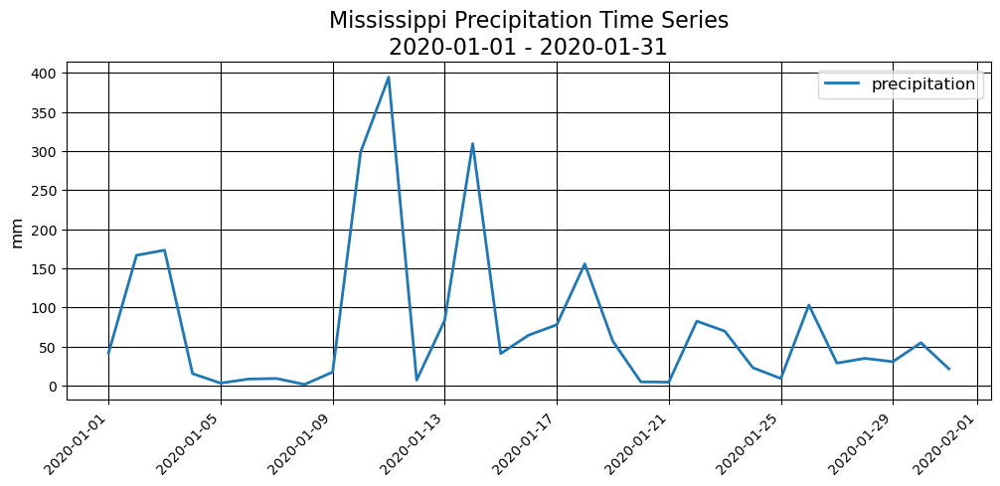

In [175]:
lis_noahmp_title = f'Mississippi Precipitation Time Series\n{str(soil_start)[:10]} - {str(soil_end)[:10]}'
plotting.timeseries_plot([(lis_noahmp_rain_timeseries['maximum'], 'precipitation')], '', 'mm', title=lis_noahmp_title, norm=False)

#### Normalized Precipitation and Direct Evaporation from Bare Soil 2020-1-1 to 2020-01-31

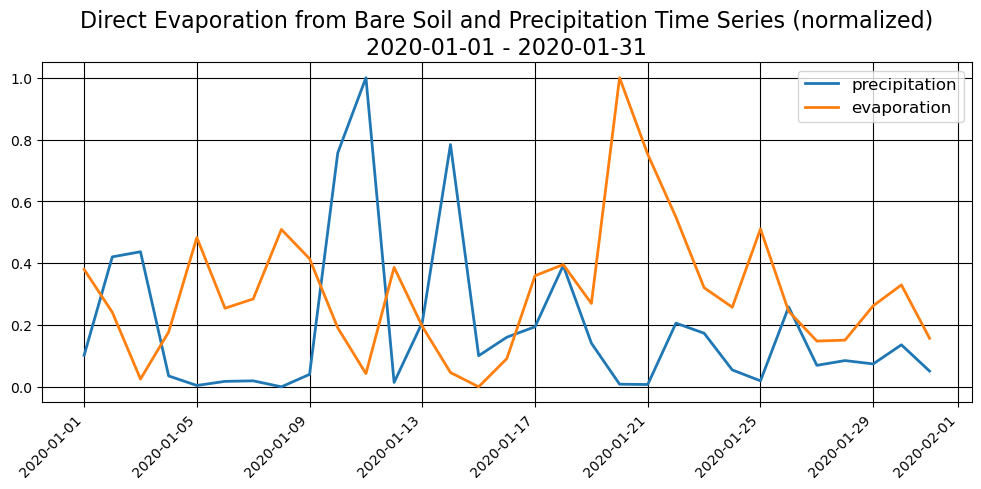

In [176]:
lis_noahmp_title = f'Direct Evaporation from Bare Soil and Precipitation Time Series (normalized)\n{str(soil_start)[:10]} - {str(soil_end)[:10]}'
plotting.timeseries_plot([(lis_noahmp_rain_timeseries['maximum'], 'precipitation'), (lis_noahmp_evap_timeseries['maximum'], 'evaporation')], '', '', title=lis_noahmp_title, norm=True)

#### Temporal Average of Precipitation and Direct Evaporation from Bare Soil 2020-1-1 to 2020-01-31

In [177]:
miss_rain_timeavg = ideas_processing.temporal_mean(*lis_noahmp_rain_parameters)

url
 https://ideas-digitaltwin.jpl.nasa.gov/nexus/timeAvgMapSpark?ds=GPM_3IMERGDL_precipitationCal&b=-94.5,29,-88,38&startTime=2020-01-01T00:00:00Z&endTime=2020-01-31T00:00:00Z

Waiting for response from IDEAS... took 5.926078707998386 seconds


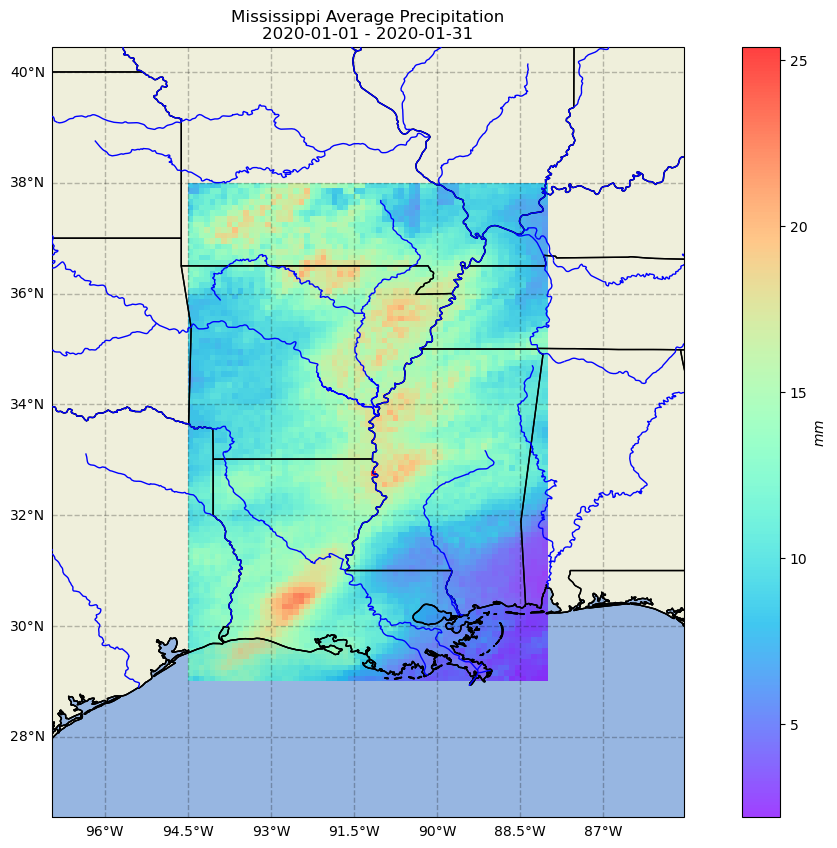

In [178]:
plotting.map_data(miss_rain_timeavg, f'Mississippi Average Precipitation\n{str(soil_start)[:10]} - {str(soil_end)[:10]}', cb_label='$mm$')

In [179]:
lis_noahmp_timeavg = ideas_processing.temporal_mean(*lis_noahmp_evap_parameters)

url
 https://ideas-digitaltwin.jpl.nasa.gov/nexus/timeAvgMapSpark?ds=LIS-ESoil-tavg&b=-94.5,29,-88,38&startTime=2020-01-01T00:00:00Z&endTime=2020-01-31T00:00:00Z

Waiting for response from IDEAS... took 3.5702470830001403 seconds


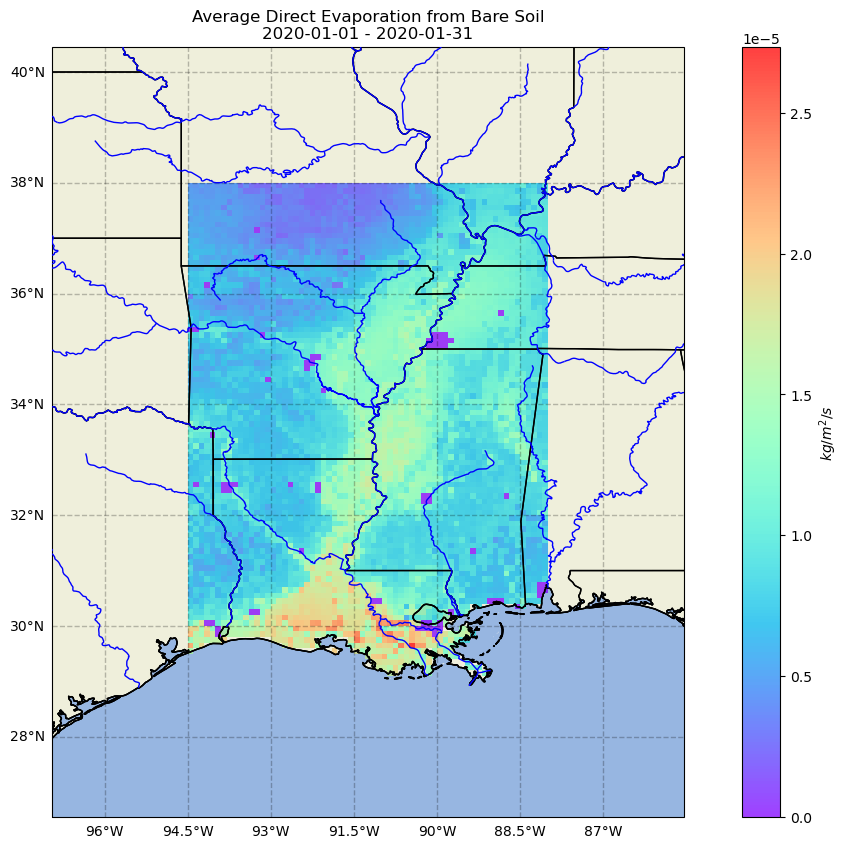

In [180]:
soil_title = f'Average Direct Evaporation from Bare Soil\n{str(soil_start)[:10]} - {str(soil_end)[:10]}'
plotting.map_data(lis_noahmp_timeavg, soil_title, cb_label='$kg/m^2/s$')

#### Latitude Time Hovmöller Analysis

In [181]:
mis_evap_lat_hof = ideas_processing.hofmoeller(*lis_noahmp_evap_parameters, dim='latitude')
mis_rain_lat_hof = ideas_processing.hofmoeller(*lis_noahmp_rain_parameters, dim='latitude')

url
 https://ideas-digitaltwin.jpl.nasa.gov/nexus/latitudeTimeHofMoellerSpark?ds=LIS-ESoil-tavg&b=-94.5,29,-88,38&startTime=2020-01-01T00:00:00Z&endTime=2020-01-31T00:00:00Z

Waiting for response from IDEAS... took 3.4673407080117613 seconds
url
 https://ideas-digitaltwin.jpl.nasa.gov/nexus/latitudeTimeHofMoellerSpark?ds=GPM_3IMERGDL_precipitationCal&b=-94.5,29,-88,38&startTime=2020-01-01T00:00:00Z&endTime=2020-01-31T00:00:00Z

Waiting for response from IDEAS... took 2.6413795829867013 seconds


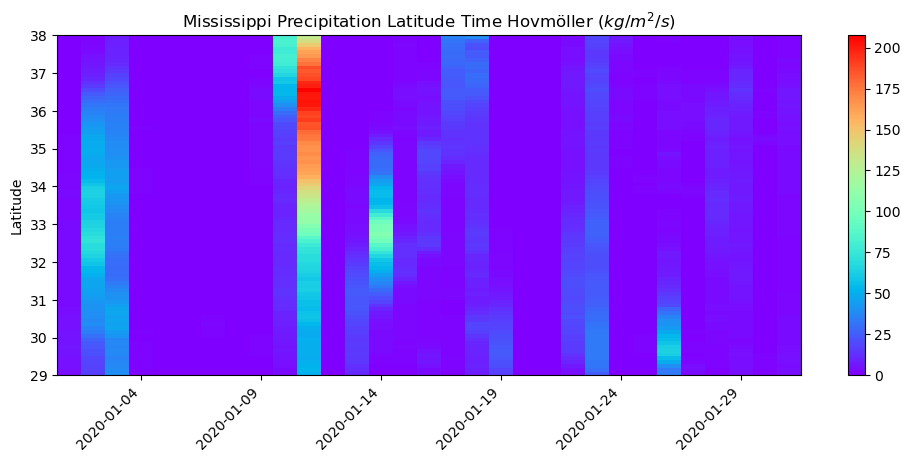

In [182]:
mis_rain_hof_title = 'Mississippi Precipitation Latitude Time Hovmöller ($kg/m^2/s$)'
plotting.heatmap(mis_rain_lat_hof['mean'].transpose(), '', 'Latitude', mis_rain_hof_title)

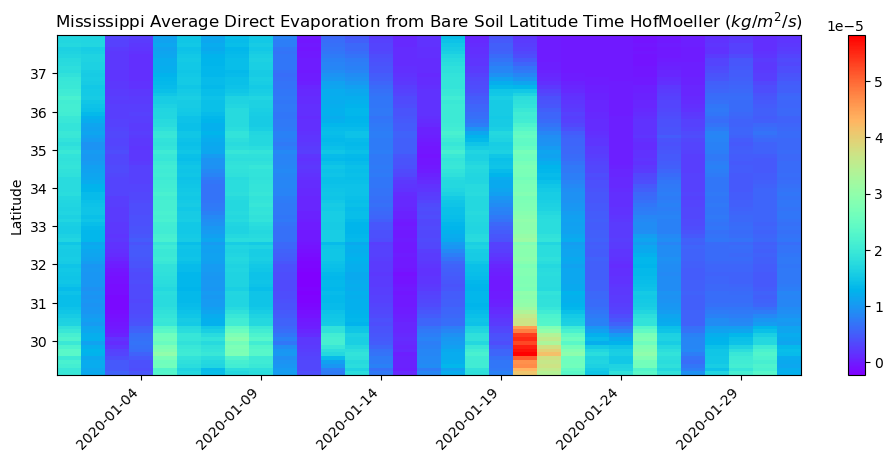

In [183]:
mis_evap_hof_title = 'Mississippi Average Direct Evaporation from Bare Soil Latitude Time HofMoeller ($kg/m^2/s$)'
plotting.heatmap(mis_evap_lat_hof['mean'].transpose(), '', 'Latitude', mis_evap_hof_title)

#### IDEAS WMS Visual 2020-01-20

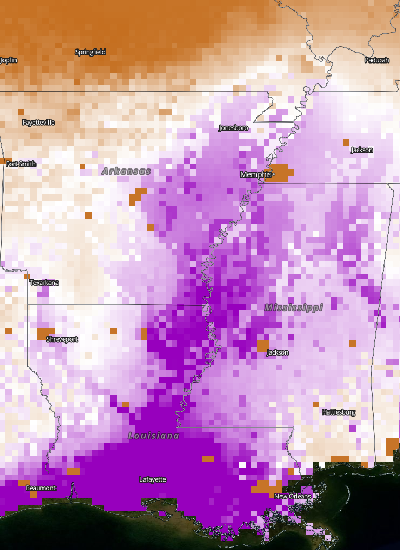

In [184]:
# Connect to IDEAS WMS Service
wms = WebMapService('https://ideas-digitaltwin.jpl.nasa.gov/wms/epsg4326/best/wms.cgi?', version='1.3.0')

# Get IMERG_Precipitation_Rate
img = wms.getmap(layers=['BlueMarble_NextGeneration',
                         'LIS_HIST_ESoil_tavg',
                         'Reference_Features',
                         'Reference_Labels'],  # Layers
                 srs='epsg:4326',  # Map projection
                 bbox=(-94.5,29,-88,38),  # Bounds
                 size=(400, 550),  # Image size
                 time='2020-01-20',  # Time of data
                 format='image/png',  # Image format
                 transparent=True)  # Nodata transparency

# Save output PNG to a file
out = open('LIS_HIST_ESoil_tavg_2020-01-20.png', 'wb')
out.write(img.read())
out.close()

# View image
Image('LIS_HIST_ESoil_tavg_2020-01-20.png')

#### IDEAS WMS Animation 2020-01-01 to 2020-01-31

In [185]:
wms = WebMapService('https://ideas-digitaltwin.jpl.nasa.gov/wms/epsg4326/best/wms.cgi?', version='1.3.0')

layers = ['BlueMarble_NextGeneration',
          'LIS_HIST_ESoil_tavg',
          'Reference_Features',
          'Reference_Labels']
color = 'rgb(255,255,255)'
frames = []

sdate = datetime(2020, 1, 1)
edate = datetime(2020, 2, 1)
dates = pd.date_range(sdate,edate-timedelta(days=1),freq='d')

for day in dates:
    datatime = day.strftime("%Y-%m-%d")
    img = wms.getmap(layers=layers,  # Layers
                     srs='epsg:4326',  # Map projection
                     bbox=(-94.5,29,-88,38),  # Bounds
                     size=(400, 550),  # Image size
                     time=datatime,  # Time of data
                     format='image/png',  # Image format
                     transparent=True)  # Nodata transparency

    image = I.open(img)
    draw = ImageDraw.Draw(image)
    (x, y) = (50, 20)
    draw.text((x, y), f'LIS NoahMP ESoil Avg   -   {datatime}', fill=color)
    frames.append(image)
    
frames[0].save('LIS_HIST_ESoil_tavg.gif',
               format='GIF',
               append_images=frames,
               save_all=True,
               duration=1000,
               loop=0)

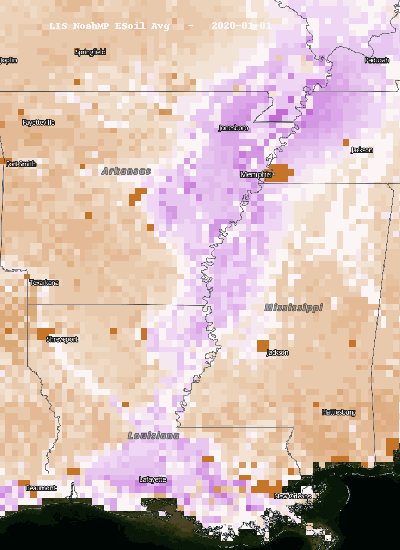

In [186]:
Image('LIS_HIST_ESoil_tavg.gif')